In [1]:
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline

from astropy.io import fits
from lvmdap.dap_tools import list_columns,read_DAP_file,map_plot_DAP
from lvmdap.dap_tools import plot_spectra,plot_spec,read_tab_EL
from matplotlib import use as mpl_use
from scipy.signal import medfilt
#mpl_use('Agg')

%matplotlib inline
from matplotlib import rcParams as rc
rc.update({'font.size': 19,\
           'font.weight': 900,\
           'text.usetex': True,\
           'path.simplify'           :   True,\
           'xtick.labelsize' : 19,\
           'ytick.labelsize' : 19,\
#           'xtick.major.size' : 3.5,\
#           'ytick.major.size' : 3.5,\
           'axes.linewidth'  : 2.0,\
               # Increase the tick-mark lengths (defaults are 4 and 2)
           'xtick.major.size'        :   6,\
           'ytick.major.size'        :   6,\
           'xtick.minor.size'        :   3,\
           'ytick.minor.size'        :   3,\
           'xtick.major.width'       :   1,\
           'ytick.major.width'       :   1,\
           'lines.markeredgewidth'   :   1,\
           'legend.numpoints'        :   1,\
           'xtick.minor.width'       :   1,\
           'ytick.minor.width'       :   1,\
           'legend.frameon'          :   False,\
           'legend.handletextpad'    :   0.3,\
           'font.family'    :   'serif',\
           'mathtext.fontset'        :   'stix',\
           'axes.facecolor' : "w",\
           
          })


In [2]:
def gamma_scale_test(flux,gamma):
    return flux

def gamma_scale(flux,gamma):
    return (flux/np.abs(flux))*(np.abs(flux))**gamma

def gamma_scale_abs(flux,gamma):
    return (np.abs(flux))**gamma

def my_medfilt (x, k):
    """Apply a length-k median filter to a 1D array x.
    Boundaries are extended by repeating endpoints.
    """
    import numpy as np

    assert k % 2 == 1, "Median filter length must be odd."
    assert x.ndim == 1, "Input must be one-dimensional."
    
    k2 = (k - 1) // 2
    y = np.zeros ((len (x), k), dtype=x.dtype)
    y[:,k2] = x
    for i in range (k2):
        j = k2 - i
        y[j:,i] = x[:-j]
        y[:j,i] = x[0]
        y[:-j,-(i+1)] = x[j:]
        y[-j:,-(i+1)] = x[-1]
    return np.median (y, axis=1)


def my_meanfilt (x, k):
    """Apply a length-k mean filter to a 1D array x.
    Boundaries are extended by repeating endpoints.
    """
    
    import numpy as np

    assert k % 2 == 1, "Median filter length must be odd."
    assert x.ndim == 1, "Input must be one-dimensional."
    
    k2 = (k - 1) // 2
    y = np.zeros ((len (x), k), dtype=x.dtype)
    y[:,k2] = x
    for i in range (k2):
        j = k2 - i
        y[j:,i] = x[:-j]
        y[:j,i] = x[0]
        y[:-j,-(i+1)] = x[j:]
        y[-j:,-(i+1)] = x[-1]
    return np.mean (y, axis=1)


In [3]:
import io
import sys
import warnings
import itertools
import numpy as np
from astropy.io import fits, ascii
from copy import deepcopy as copy
from os.path import basename, isfile
import os
from scipy.interpolate import interp1d
from scipy.ndimage import median_filter
from astropy.io.fits.verify import VerifyWarning

from matplotlib import use as mpl_use
#mpl_use('Agg')

import matplotlib.pyplot as plt
from matplotlib.ticker import MultipleLocator

from pyFIT3D.common.stats import median_filter as st_median_filter
from pyFIT3D.common.stats import hyperbolic_fit_par, std_m, pdl_stats, _STATS_POS
from pyFIT3D.common.io import trim_waves, get_data_from_fits, get_wave_from_header
from pyFIT3D.common.constants import __c__, __sigma_to_FWHM__
from pyFIT3D.common.io import output_spectra, array_to_fits, write_img_header, print_verbose
from pyFIT3D.common.constants import __Hubble_constant__, __Omega_matter__, __Omega_Lambda__
from pyFIT3D.common.constants import __solar_luminosity__, __solar_metallicity__, _figsize_default
from pyFIT3D.common.tools import peak_finder


from astropy.table import Table,join
from astropy.table import vstack as vstack_table
from lvmdap.cmaps_CLC import vel_map_CLC
import re
from collections import Counter

import math
from mpl_toolkits.axes_grid1 import make_axes_locatable
import matplotlib.colors as mpl_colors

from matplotlib import rcParams as rc

from scipy.ndimage import gaussian_filter1d, median_filter

warnings.simplefilter('ignore', category=VerifyWarning)

__indices__ = {
    'Hd':     [4083.500, 4122.250, 4041.600, 4079.750, 4128.500, 4161.000],
    'Hb':     [4847.875, 4876.625, 4827.875, 4847.875, 4876.625, 4891.625],
    'Mgb':    [5160.125, 5192.625, 5142.625, 5161.375, 5191.375, 5206.375],
    'Fe5270': [5245.650, 5285.650, 5233.150, 5248.150, 5285.650, 5318.150],
    'Fe5335': [5312.125, 5352.125, 5304.625, 5315.875, 5353.375, 5363.375],
    'D4000':  [4050.000, 4250.000, 3750.000, 3950.000, 0.000,    1.000],
    'Hdmod':  [4083.500, 4122.250, 4079,     4083,     4128.500, 4161.000],
    'Hg':     [4319.75,  4363.50,  4283.50,  4319.75,  4367.25,  4419.75]
}
_INDICES_POS_ = {
    'OL1': 0,
    'OL2': 1,
    'OLb1': 2,
    'OLb2': 3,
    'OLr1': 4,
    'OLr2': 5,
    'OLb': 6,
    'OLr': 7
}

__indices_sky_ = {
    'OI5577':  [5557, 5597, 5507, 5547, 5607, 5647],
    'NaID':    [5873, 5893, 5823, 5863, 5903, 5943],
    'OI6300':  [6280, 6320, 6230, 6270, 6330, 6370],
}



In [4]:
class scatter():
    def __init__(self,x,y,ax,size=1,**kwargs):
        self.n = len(x)
        self.ax = ax
        self.ax.figure.canvas.draw()
        self.size_data=size
        self.size = size
        self.sc = ax.scatter(x,y,s=self.size,**kwargs)
        self._resize()
        self.cid = ax.figure.canvas.mpl_connect('draw_event', self._resize)

    def _resize(self,event=None):
        ppd=72./self.ax.figure.dpi
        trans = self.ax.transData.transform
        s =  ((trans((1,self.size_data))-trans((0,0)))*ppd)[1]
        if s != self.size:
            self.sc.set_sizes(s**2*np.ones(self.n))
            self.size = s
            self._redraw_later()

    def _redraw_later(self):
        self.timer = self.ax.figure.canvas.new_timer(interval=10)
        self.timer.single_shot = True
        self.timer.add_callback(lambda : self.ax.figure.canvas.draw_idle())
        self.timer.start()
        

def map_plot_DAP(tab_DAP,line='flux_Halpha_6562.85', \
                 vmin=0, vmax=0, title=None, filename='junk',\
                 cmap='Spectral', fsize=5, figs_dir='.',fig_type='png',\
                 gamma=1.0, sf=1.0, tab_pt=None):

    rc.update({'font.size': 19,\
               'font.weight': 900,\
               'text.usetex': True,\
               'path.simplify'           :   True,\
               'xtick.labelsize' : 19,\
               'ytick.labelsize' : 19,\
               'axes.linewidth'  : 2.0,\
               'xtick.major.size'        :   6,\
               'ytick.major.size'        :   6,\
               'xtick.minor.size'        :   3,\
               'ytick.minor.size'        :   3,\
               'xtick.major.width'       :   1,\
               'ytick.major.width'       :   1,\
               'lines.markeredgewidth'   :   1,\
               'legend.numpoints'        :   1,\
               'xtick.minor.width'       :   1,\
               'ytick.minor.width'       :   1,\
               'legend.frameon'          :   False,\
               'legend.handletextpad'    :   0.3,\
               'font.family'    :   'serif',\
               'mathtext.fontset'        :   'stix',\
               'axes.facecolor' : "w",\
               })
    
    X=tab_DAP['ra']
    Y=tab_DAP['dec']
    C=tab_DAP[line]    
    if (title== None):
        title=line.replace("_"," ")
        title=line.replace("_"," ")
    if (vmin==vmax):
        vmin=np.nanmin(C)
        vmax=np.nanmax(C)
    print(line,vmin,vmax)
    fig,ax = plt.subplots(1,1,figsize=(fsize,fsize))
    norm=mpl_colors.PowerNorm(vmin=vmin,vmax=vmax,gamma=gamma)
    scat=scatter(X, Y, ax, size=sf*35.6/3600, c=C, cmap=cmap, norm=norm)
#    scat=scatter(X, Y, ax, size=35.6/3600, c=C,vmin = vmin, vmax = vmax, cmap=cmap, norm=colors.PowerNorm(gamma=gamma))
    ax.set_xlabel('Ra [deg]')#,fontsize=21)
    ax.set_ylabel('Dec [deg]')#,fontsize=21)
    xx = ax.get_xlim()
    ax.set_xlim(xx[1],xx[0])
    divider = make_axes_locatable(ax)
    cax = divider.append_axes("right", size="5%", pad=0.05)
    plt.colorbar(scat.sc, cax=cax,label=fr'{title}')#,fontsize=21)
    if (tab_pt != None):
        for tap_pt_now in tab_pt:
            ax.text(tab_pt['ra'],tab_pt['dec'],tab_pt['id'])
#    ax.set_aspect('equal', adjustable='box')
    try:
        plt.show()
    except:
        plt_show=False
    fig.tight_layout()
    fig.savefig(f'{figs_dir}/{filename}.{fig_type}')
    plt.close()


def map_plot_DAP_rgb(tab_DAP,\
                     rgb_key=('flux_pe_6583.45','flux_pe_6562.85','flux_pe_5006.84'), \
                     rgb_scale=(1.0,1.0,1.0),\
                 vmin=0, vmax=0, titles=('r','g','b'), filename='junk',\
                fsize=5, figs_dir='.',fig_type='png',\
                 gamma=1.0, sf=1.0, tab_pt=None,fs=18):

    rc.update({'font.size': fs*fsize/5,\
               'font.weight': 900,\
               'text.usetex': True,\
               'path.simplify'           :   True,\
               'xtick.labelsize' : fs*fsize/5,\
               'ytick.labelsize' : fs*fsize/5,\
               'axes.linewidth'  : 2.0,\
               'xtick.major.size'        :   6,\
               'ytick.major.size'        :   6,\
               'xtick.minor.size'        :   3,\
               'ytick.minor.size'        :   3,\
               'xtick.major.width'       :   1,\
               'ytick.major.width'       :   1,\
               'lines.markeredgewidth'   :   1,\
               'legend.numpoints'        :   1,\
               'xtick.minor.width'       :   1,\
               'ytick.minor.width'       :   1,\
               'legend.frameon'          :   False,\
               'legend.handletextpad'    :   0.3,\
               'font.family'    :   'serif',\
               'mathtext.fontset'        :   'stix',\
               'axes.facecolor' : "w",\
               })
    
    X= tab_DAP['ra'].value
    Y= tab_DAP['dec'].value
    R=tab_DAP[rgb_key[2]].value  
    G=tab_DAP[rgb_key[1]].value    
    B=tab_DAP[rgb_key[0]].value 
    R = R * rgb_scale[2]
    G = G * rgb_scale[1]
    B = B * rgb_scale[0]
    RGB = np.stack((R, G, B), axis=1)
    if (vmin==vmax):
        vmin=np.nanmin(RGB)
        vmax=np.nanmax(RGB)
    print(f'min/max:{vmin}/{vmax}')
    r = (R-vmin)/(vmax-vmin)
    g = (G-vmin)/(vmax-vmin)
    b = (B-vmin)/(vmax-vmin)

    r[r>1]=1
    r[r<0]=0
    b[b>1]=1
    b[b<0]=0
    r[r>1]=1
    r[r<0]=0    
    
    r = np.ma.filled(r, fill_value=0.0)
    g = np.ma.filled(g, fill_value=0.0)
    b = np.ma.filled(b, fill_value=0.0)

    r=r**gamma
    g=g**gamma
    b=b**gamma
    
#    print (r)
    r = np.ma.compressed(r)
    g = np.ma.compressed(g)
    b = np.ma.compressed(b)   


    #print(r,g,b)
    colors = np.stack((r, g, b), axis=1)
    colors[colors>1]=1
    colors[colors<0]=0
#    print(colors)
    fig,ax = plt.subplots(1,1,figsize=(fsize,fsize*0.95))
#    norm=mpl_colors.PowerNorm(vmin=0,vmax=1,gamma=gamma)
    scatter(X, Y, ax, color=colors, size=sf*35.6/3600)#, color=colors)
    ax.set_xlabel('Ra [deg]')#,fontsize=21)
    ax.set_ylabel('Dec [deg]')#,fontsize=21)
    xx = ax.get_xlim()
    yy = ax.get_ylim()
    ax.set_xlim(xx[1],xx[0])
    ax.text(xx[1]-0.03*(xx[1]-xx[0]),yy[1]-0.06*(yy[1]-yy[0]),titles[0],fontsize=fs*(fsize/5),color='tomato')
    ax.text(xx[1]-0.03*(xx[1]-xx[0]),yy[1]-0.12*(yy[1]-yy[0]),titles[1],fontsize=fs*(fsize/5),color='forestgreen')
    ax.text(xx[1]-0.03*(xx[1]-xx[0]),yy[1]-0.18*(yy[1]-yy[0]),titles[2],fontsize=fs*(fsize/5),color='steelblue')

    if (tab_pt != None):
        for tap_pt_now in tab_pt:
            ax.text(tab_pt['ra'],tab_pt['dec'],tab_pt['id'])
#    ax.set_aspect('equal', adjustable='box')
    try:
        plt.show()
    except:
        plt_show=False
    fig.tight_layout()
    fig.savefig(f'{figs_dir}/{filename}.{fig_type}', facecolor='white')
    plt.close()

    
    
def list_columns(obj, cols=4, columnwise=True, gap=2):
    """
    Print the given list in evenly-spaced columns.

    Parameters
    ----------
    obj : list
        The list to be printed.
    cols : int
        The number of columns in which the list should be printed.
    columnwise : bool, default=True
        If True, the items in the list will be printed column-wise.
        If False the items in the list will be printed row-wise.
    gap : int
        The number of spaces that should separate the longest column
        item/s from the next column. This is the effective spacing
        between columns based on the maximum len() of the list items.
    """

    sobj = [str(item) for item in obj]
    if cols > len(sobj): cols = len(sobj)
    max_len = max([len(item) for item in sobj])
    if columnwise: cols = int(math.ceil(float(len(sobj)) / float(cols)))
    plist = [sobj[i: i+cols] for i in range(0, len(sobj), cols)]
    if columnwise:
        if not len(plist[-1]) == cols:
            plist[-1].extend(['']*(len(sobj) - len(plist[-1])))
        plist = zip(*plist)
    printer = '\n'.join([
        ''.join([c.ljust(max_len + gap) for c in p])
        for p in plist])
    print(printer)

def dap_indices_spec(wave__w, flux_ssp__w, res__w, redshift, n_sim, plot=0, wl_half_range=200, verbose=False,\
                      __indices__=__indices__, _INDICES_POS=_INDICES_POS_):
    if plot:
        from matplotlib import use as mpl_use
        mpl_use('Agg')
        import matplotlib.patches as patches
        import matplotlib.pyplot as plt

        #plt.style.use('dark_background')
        f, ax = plt.subplots()
        ax.set_xlabel('Wavelength')
        ax.set_ylabel('Flux')

    nw = wave__w.size
    cdelt = wave__w[1] - wave__w[0]
    names__i = list(__indices__.keys())
    _ind = np.array(list(__indices__.values()))
    wmin = _ind.T[_INDICES_POS['OLb1']].min() - wl_half_range
    wmax = _ind.T[_INDICES_POS['OLr2']].max() + wl_half_range
    n_ind = _ind.shape[0]

    FWHM = __sigma_to_FWHM__*3*cdelt

    stflux = pdl_stats(flux_ssp__w)
    if (stflux[_STATS_POS['mean']] == 0) and (stflux[_STATS_POS['min']] == stflux[_STATS_POS['max']]):
        flux_ssp__w = np.ones_like(flux_ssp__w)
        res__w = 100*np.ones_like(flux_ssp__w)

    med_res__w = median_filter(res__w, size=np.int(3*FWHM/cdelt), mode='reflect')

    _ind_corr = _ind*(1 + redshift)
    _ind_corr.T[_INDICES_POS['OLb']] = (_ind_corr.T[_INDICES_POS['OLb1']] + _ind_corr.T[_INDICES_POS['OLb2']])/2
    _ind_corr.T[_INDICES_POS['OLr']] = (_ind_corr.T[_INDICES_POS['OLr1']] + _ind_corr.T[_INDICES_POS['OLr2']])/2
    wmin = _ind_corr.T[_INDICES_POS['OLb1']].min() - wl_half_range
    wmax = _ind_corr.T[_INDICES_POS['OLr2']].max() + wl_half_range

    med_flux = np.median(flux_ssp__w[np.isfinite(flux_ssp__w)])
    std_flux = np.std(flux_ssp__w[np.isfinite(flux_ssp__w)])
    EW__ki = np.zeros((n_sim, n_ind))
    for k in range(n_sim):
        noise = np.random.normal(size=nw)
        noise *= res__w
        _flux__w = flux_ssp__w + noise
        _med_flux = np.median(_flux__w)
        _min_flux = -0.1*np.abs(_med_flux)
        _max_flux = 3.5*_med_flux
        for ii in range(n_ind):
            if plot:
                plt.cla()
                ax = plt.gca()
                ax.set_xlim(wmin, wmax)
                ax.set_ylim(_min_flux - 0.2*np.abs(_min_flux), _max_flux + 0.2*np.abs(_max_flux))
                ax.plot(wave__w, _flux__w, 'k-')
            name = names__i[ii]
            Lb1 = _ind_corr[ii][_INDICES_POS['OLb1']]
            Lb2 = _ind_corr[ii][_INDICES_POS['OLb2']]
            Lr1 = _ind_corr[ii][_INDICES_POS['OLr1']]
            Lr2 = _ind_corr[ii][_INDICES_POS['OLr2']]
            L1 = _ind_corr[ii][_INDICES_POS['OL1']]
            L2 = _ind_corr[ii][_INDICES_POS['OL2']]
            Lb = _ind_corr[ii][_INDICES_POS['OLb']]
            Lr = _ind_corr[ii][_INDICES_POS['OLr']]

            str_verbose = f'L1:{L1}, L2:{L2}\nblue: Lb:{Lb}, Lb1:{Lb1}, Lb2:{Lb2}\nred: Lr:{Lr}, Lr1:{Lr1}, Lr2:{Lr2}'
            print_verbose(str_verbose, verbose=verbose, level=1)

            if name != 'D4000':
                iw1_b = (Lb1 - wave__w[0] - 0.5*cdelt)/cdelt
                iw2_b = (Lb2 - wave__w[0] - 0.5*cdelt)/cdelt
                Sb = 0
                nb = 0
                for iw in range(np.int(iw1_b + 1), np.int(iw2_b)):
                    Sb += _flux__w[iw]*cdelt
                    nb += 1
                iw = np.int(iw1_b)
                ff = iw + 1 - iw1_b
                Sb += (_flux__w[iw]*ff*cdelt)
                iw = np.int(iw2_b)
                ff = iw2_b - iw
                Sb += (_flux__w[iw]*ff*cdelt)
                Sb = Sb/(Lb2 - Lb1)

                iw1_r = (Lr1 - wave__w[0] - 0.5*cdelt)/cdelt
                iw2_r = (Lr2 - wave__w[0] - 0.5*cdelt)/cdelt
                Sr = 0
                nr = 0
                for iw in range(np.int(iw1_r + 1), np.int(iw2_r)):
                    Sr += _flux__w[iw]*cdelt
                    nr += 1
                iw = np.int(iw1_r)
                ff = iw + 1 - iw1_r
                Sr += (_flux__w[iw]*ff*cdelt)
                iw = np.int(iw2_r)
                ff = iw2_r - iw
                Sr += (_flux__w[iw]*ff*cdelt)
                Sr = Sr/(Lr2 - Lr1)
                EW = 0
                CK = []
                waveK = []
                iw1 = (L1 - wave__w[0] - 0.5*cdelt)/cdelt
                iw2 = (L2 - wave__w[0] - 0.5*cdelt)/cdelt
                for iw in range(np.int(iw1 + 1), np.int(iw2)):
                    C = Sb*((Lr - wave__w[iw])/(Lr - Lb)) + Sr*((wave__w[iw] - Lb)/(Lr - Lb))
                    EW = EW + (1 - _flux__w[iw]/C)*(wave__w[iw] - wave__w[iw - 1])
                    CK.append(C)
                    waveK.append(wave__w[iw])
                iw = np.int(iw1)
                ff = iw + 1 - iw1
                C = Sb*((Lr - wave__w[iw])/(Lr - Lb)) + Sr*((wave__w[iw] - Lb)/(Lr - Lb))
                EW = EW + (1 - _flux__w[iw]/C)*(wave__w[iw] - wave__w[iw - 1])*ff
                iw = np.int(iw2)
                ff = iw2 - iw
                C = Sb*((Lr - wave__w[iw])/(Lr - Lb)) + Sr*((wave__w[iw] - Lb)/(Lr - Lb))
                EW = EW + (1 - _flux__w[iw]/C)*(wave__w[iw] - wave__w[iw - 1])*ff
                EW = EW/(1 + redshift)
                if plot:
                    _xy, dx, dy = (Lb1, _max_flux*0.5), Lb2-Lb1, _max_flux*0.3
                    rectLb1Lb2 = patches.Rectangle(_xy, dx, dy, edgecolor='b', facecolor='none')
                    ax.add_patch(rectLb1Lb2)
                    _xy, dx, dy = (Lr1, _max_flux*0.5), Lr2-Lr1, _max_flux*0.3
                    rectLr1Lr2 = patches.Rectangle(_xy, dx, dy, edgecolor='r', facecolor='none')
                    ax.add_patch(rectLr1Lr2)
                    _xy, dx, dy = (L1, _max_flux*0.5), L2-L1, _max_flux*0.3
                    rectL1L2 = patches.Rectangle(_xy, dx, dy, edgecolor='g', facecolor='none')
                    ax.add_patch(rectL1L2)
                    ax.plot(waveK, CK, ls='--', c='gray')
                    ax.scatter(Lb, Sb, marker='x', color='b', s=50)
                    ax.scatter(Lr, Sr, marker='x', color='r', s=50)
                    ax.set_xlim(Lb1 - 0.02*Lb1, Lr2 + 0.02*Lr2)
                    ax.text(0.98, 0.98, name, transform=ax.transAxes, va='top', ha='right')
                    plt.pause(0.001)
            else:
                Sb = 0
                nb = 0
                iw1_b = (Lb1 - wave__w[0] - 0.5*cdelt)/cdelt
                iw2_b = (Lb2 - wave__w[0] - 0.5*cdelt)/cdelt
                for iw in range(np.int(iw1_b + 1), np.int(iw2_b)):
                    Sb += _flux__w[iw]*cdelt
                    nb += 1
                iw = np.int(iw1_b)
                ff = iw + 1 - iw1_b
                Sb += _flux__w[iw]*ff*cdelt
                iw = np.int(iw2_b)
                ff = iw2_b - iw
                Sb += _flux__w[iw]*ff*cdelt
                Sb = Sb/(Lb2 - Lb1)

                S = 0
                K = 0
                iw1 = (L1 - wave__w[0] - 0.5*cdelt)/cdelt
                iw2 = (L2 - wave__w[0] - 0.5*cdelt)/cdelt
                for iw in range(np.int(iw1 + 1), np.int(iw2)):
                    S += _flux__w[iw]*cdelt
                    K += 1
                iw = np.int(iw1)
                ff = iw + 1 - iw1
                S += _flux__w[iw]*ff*cdelt
                iw = np.int(iw2)
                ff = iw2 - iw
                S += _flux__w[iw]*ff*cdelt
                S = S/(L2 - L1)
                if Sb != 0:
                    EW = S/Sb
                else:
                    EW = 1e16
                if plot:
                    _xy, dx, dy = (Lb1, _max_flux*0.5), Lb2-Lb1, _max_flux*0.3
                    rectLb1Lb2 = patches.Rectangle(_xy, dx, dy, edgecolor='b', facecolor='none')
                    ax.add_patch(rectLb1Lb2)
                    # _xy, dx, dy = (Lr1, _max_flux*0.5), Lr2-Lr1, _max_flux*0.3
                    # rectLr1Lr2 = patches.Rectangle(_xy, dx, dy, edgecolor='r', facecolor='none')
                    # ax.add_patch(rectLr1Lr2)
                    _xy, dx, dy = (L1, _max_flux*0.5), L2-L1, _max_flux*0.3
                    rectL1L2 = patches.Rectangle(_xy, dx, dy, edgecolor='r', facecolor='none')
                    ax.add_patch(rectL1L2)
                    # ax.plot(waveK, CK, '--k')
                    ax.scatter(Lb, Sb, marker='x', color='b', s=50)
                    ax.scatter((L1 + L2)/2, S, marker='x', color='r', s=50)
                    ax.set_xlim(Lb1 - 0.02*Lb1, L2 + 0.02*L2)
                    ax.text(0.98, 0.98, name, transform=ax.transAxes, va='top', ha='right')
                    plt.pause(0.001)
            EW__ki[k, ii] = EW
    if plot:
        plt.close(f)
    return EW__ki, med_flux, std_flux


#
# data = FLUX_RSS ['FLUX'] extension
# sdata = SKY_RSS ['SKY'] extension
# hdr = header extension of flux extension
# Band: wavelengthg of the emission line, and wavelegnth of two non-emission line regimes
# This could be refined, of course
#
def sky_hack_f(data, sdata, hdr, m2a=10e9, band=np.array((7238,7242,7074,7084,7194,7265))):
    #nx=hdr['NAXIS1']
    #ny=hdr['NAXIS2']
    ny=hdu['FLUX'].data.shape[0]
    nx=hdu['FLUX'].data.shape[1]

    crval = hdr['crval1']
    cdelt = hdr['cdelt1']
    crpix = hdr['crpix1']
    wave = crval+cdelt*(np.arange(0,nx)-(crpix-1))
    i_band = ((band-crval)/cdelt).astype(int)

    map_b=np.mean(data[:,i_band[0]:i_band[1]],axis=1)
    map_0=np.mean(data[:,i_band[2]:i_band[3]],axis=1)
    map_1=np.mean(data[:,i_band[4]:i_band[5]],axis=1)
    map_c = map_b-0.5*(map_0+map_1)

    smap_b=np.mean(sdata[:,i_band[0]:i_band[1]],axis=1)
    smap_0=np.mean(sdata[:,i_band[2]:i_band[3]],axis=1)
    smap_1=np.mean(sdata[:,i_band[4]:i_band[5]],axis=1)
    smap_c = smap_b-0.5*(smap_0+smap_1)

    scale=map_c/smap_c
    data_c=data-np.transpose(np.transpose(sdata)*scale)
    return data_c


#
# Load an standard LVM RSS file
#
def load_LVM_rss(lvm_file, m2a=10e9, flux_scale=1e16, ny_range=None, sky_hack= True,nx_range=None):
    """Return the RSS from the given and LVM filename in the parsed command line arguments"""
    hdu = fits.open(lvm_file, memmap=False)
    rss_0_hdr = hdu[0].header
    rss_f_spectra = hdu['FLUX'].data
    rss_f_hdr = hdu['FLUX'].header
    try:
        crval1=rss_f_hdr['CRVAL1']
    except:
        rss_f_hdr = hdu[0].header
#    rss_f_hdr = hdu['FLUX'].header
    rss_sky = hdu['SKY'].data
    
    try:
        rss_e_spectra = hdu['ERROR'].data
    except:
        rss_e_spectra = np.ones(rss_f_spectra.shape)
        std_spectra = 0.1*np.nanstd(rss_f_spectra-median_filter(rss_f_spectra,size=(1,51)),axis=1)
        for I,std_now in enumerate(std_spectra):
            rss_e_spectra[I,:]=std_now*rss_e_spectra[I,:]
#    wl__w = np.array([rss_f_hdr["CRVAL1"] + i*rss_f_hdr["CDELT1"] for i in range(rss_f_hdr["NAXIS1"])])
    wl__w = np.array([rss_f_hdr["CRVAL1"] + i*rss_f_hdr["CDELT1"] for i in range(hdu['FLUX'].data.shape[1])])
    wl__w = wl__w*m2a
    rss_f_spectra=rss_f_spectra*flux_scale
    #
    # We need to revise the errors!
    #
    rss_e_spectra=rss_e_spectra*flux_scale
    rss_f_hdr["CRVAL1"]=rss_f_hdr["CRVAL1"]*m2a
    rss_f_hdr["CDELT1"]=rss_f_hdr["CDELT1"]*m2a
    rss_f_hdr['NAXIS1']=hdu['FLUX'].data.shape[1]
    rss_f_hdr['NAXIS2']=hdu['FLUX'].data.shape[0]
    #ny=hdr['NAXIS2']
    
    if (sky_hack == True):
        print(f'# sky re-evaluated')
        try:
            rss_f_spectra=sky_hack_f(rss_f_spectra, rss_sky, rss_f_hdr)
        except:
            print('# sky-hack did not work')
            sky_hack = False

    if (nx_range != None):
        print(f'# X-axis trimmed: {nx_range}')
        rss_f_spectra=rss_f_spectra[:,nx_range[0]:nx_range[1]]
        rss_e_spectra=rss_e_spectra[:,nx_range[0]:nx_range[1]]
        wl__w=wl__w[nx_range[0]:nx_range[1]]
        rss_f_hdr['NAXIS1']=nx_range[1]-nx_range[0]+1
        rss_f_hdr["CRVAL1"]=rss_f_hdr["CRVAL1"]+nx_range[0]*rss_f_hdr["CDELT1"]
    
    if (ny_range != None):
        print(f'# Y-axis trimmed: {ny_range}')
        rss_f_spectra=rss_f_spectra[ny_range[0]:ny_range[1],:]
        rss_e_spectra=rss_e_spectra[ny_range[0]:ny_range[1],:]
        rss_f_hdr['NAXIS2']=ny_range[1]-ny_range[0]+1
    return wl__w, rss_f_spectra, rss_e_spectra, rss_f_hdr, rss_0_hdr


#
# Load an standard LVM RSS file
#
def load_LVMSIM_rss(lvm_file, m2a=1, flux_scale=1e16, ny_range=None, nx_range=None):
    """Return the RSS from the given and LVM filename in the parsed command line arguments"""
    hdu = fits.open(lvm_file, memmap=False)
    rss_0_hdr = hdu[0].header
    rss_f_spectra = hdu['TARGET'].data
    rss_f_hdr = hdu['TARGET'].header
    rss_sky = hdu['SKY'].data
    try:
        rss_e_spectra = hdu['ERR'].data#+np.abs(rss_f_spectra)
    except:
        rss_e_spectra = 3*np.nanstd(np.abs(rss_f_spectra))*np.ones(rss_f_spectra.shape)
        #rss_e_spectra = 3*np.nanstd(np.abs(rss_f_spectra-median_filter(rss_f_spectra,size=(1,51))))*np.ones(rss_f_spectra.shape)
        #rss_e_spectra = np.abs(rss_f_spectra-median_filter(rss_f_spectra,size=(1,51)))  
    # We force an arbitrary (?) error      
    #rss_e_spectra = np.abs(0.07*rss_f_spectra)+0.07*np.nanmean(np.abs(rss_f_spectra[rss_f_spectra>0]))
    #rss_e_spectra = np.abs(0.07*rss_f_spectra)+0.07*np.nanmean(np.abs(rss_f_spectra[rss_f_spectra>0]))
#    rss_e_spectra = 2*median_filter(np.abs(rss_f_spectra-median_filter(rss_f_spectra,size=(1,51))),size=(1,51))        
    wl__w = np.array([rss_f_hdr["CRVAL1"] + i*rss_f_hdr["CDELT1"] for i in range(rss_f_hdr["NAXIS1"])])
    wl__w = wl__w*m2a
    rss_f_spectra=rss_f_spectra*flux_scale
    #
    # We need to revise the errors!
    #
    rss_e_spectra=rss_e_spectra*flux_scale
    rss_f_hdr["CRVAL1"]=rss_f_hdr["CRVAL1"]*m2a
    rss_f_hdr["CDELT1"]=rss_f_hdr["CDELT1"]*m2a

    if (nx_range != None):
        print(f'# X-axis trimmed: {nx_range}')
        rss_f_spectra=rss_f_spectra[:,nx_range[0]:nx_range[1]]
        rss_e_spectra=rss_e_spectra[:,nx_range[0]:nx_range[1]]
        wl__w=wl__w[nx_range[0]:nx_range[1]]
        rss_f_hdr['NAXIS1']=nx_range[1]-nx_range[0]+1
        rss_f_hdr["CRVAL1"]=rss_f_hdr["CRVAL1"]+nx_range[0]*rss_f_hdr["CDELT1"]
    
    if (ny_range != None):
        print(f'# Y-axis trimmed: {ny_range}')
        rss_f_spectra=rss_f_spectra[ny_range[0]:ny_range[1],:]
        rss_e_spectra=rss_e_spectra[ny_range[0]:ny_range[1],:]
        rss_f_hdr['NAXIS2']=ny_range[1]-ny_range[0]+1
    return wl__w, rss_f_spectra, rss_e_spectra, rss_f_hdr, rss_0_hdr


#
# Load an standard LVM RSS file
#
def load_in_rss(lvm_file, nHDU=0, m2a=1, flux_scale=1, ny_range=None, nx_range=None):
    """Return the RSS from the given and LVM filename in the parsed command line arguments"""
    hdu = fits.open(lvm_file, memmap=False)
    rss_0_hdr = hdu[0].header
    rss_f_spectra = hdu[nHDU].data
    rss_f_hdr = hdu[nHDU].header
    try:
        rss_e_spectra = hdu['ERR'].data#+np.abs(rss_f_spectra)
    except:
        rss_e_spectra = np.ones(rss_f_spectra.shape)
        std_spectra = 0.1*np.nanstd(rss_f_spectra-median_filter(rss_f_spectra,size=(1,51)),axis=1)
        for I,std_now in enumerate(std_spectra):
            rss_e_spectra[I,:]=std_now*rss_e_spectra[I,:]
        #0.03*np.abs(median_filter(rss_f_spectra,size=(1,51)))+3*np.nanstd(np.abs(rss_f_spectra))*np.ones(rss_f_spectra.shape)
#        rss_e_spectra = 3*np.nanstd(np.abs(rss_f_spectra))*np.ones(rss_f_spectra.shape)
        #rss_e_spectra = np.nanstd(rss_f_spectra-median_filter(rss_f_spectra,size=(1,51)))*np.ones(rss_f_spectra.shape)
        #rss_e_spectra = 0.03*np.abs(median_filter(rss_f_spectra,size=(1,51)))  
    wl__w = np.array([rss_f_hdr["CRVAL1"] + i*rss_f_hdr["CDELT1"] for i in range(rss_f_hdr["NAXIS1"])])
    wl__w = wl__w*m2a
    rss_f_spectra=rss_f_spectra*flux_scale
    #
    # We need to revise the errors!
    #
    rss_e_spectra=rss_e_spectra*flux_scale
    rss_f_hdr["CRVAL1"]=rss_f_hdr["CRVAL1"]*m2a
    rss_f_hdr["CDELT1"]=rss_f_hdr["CDELT1"]*m2a

    if (nx_range != None):
        print(f'# X-axis trimmed: {nx_range}')
        rss_f_spectra=rss_f_spectra[:,nx_range[0]:nx_range[1]]
        rss_e_spectra=rss_e_spectra[:,nx_range[0]:nx_range[1]]
        wl__w=wl__w[nx_range[0]:nx_range[1]]
        rss_f_hdr['NAXIS1']=nx_range[1]-nx_range[0]+1
        rss_f_hdr["CRVAL1"]=rss_f_hdr["CRVAL1"]+nx_range[0]*rss_f_hdr["CDELT1"]
    
    if (ny_range != None):
        print(f'# Y-axis trimmed: {ny_range}')
        rss_f_spectra=rss_f_spectra[ny_range[0]:ny_range[1],:]
        rss_e_spectra=rss_e_spectra[ny_range[0]:ny_range[1],:]
        rss_f_hdr['NAXIS2']=ny_range[1]-ny_range[0]+1
    return wl__w, rss_f_spectra, rss_e_spectra, rss_f_hdr, rss_0_hdr



PLATESCALE = 112.36748321030637


def rotate(xx,yy,angle):
    # rotate x and y cartesian coordinates by angle (in degrees)
    # about the point (0,0)
    theta = -1.*angle * np.pi / 180. # in radians
    xx1 = np.cos(theta) * xx - np.sin(theta) * yy
    yy1 = np.sin(theta) * xx + np.cos(theta) * yy
    return xx1, yy1

def make_radec(xx0,yy0,ra,dec,pa):
    xx, yy = rotate(xx0,yy0,pa)
    ra_fib = ra + xx*PLATESCALE/3600./np.cos(dec*np.pi/180.) 
    dec_fib = dec - yy*PLATESCALE/3600. 
    return ra_fib, dec_fib

    
def make_line(wave, r1, sci, wl_shift_vel, whichone):

    # Halpha
    wl_ha = (wave > 6560 + wl_shift_vel/3e5*6560) & (wave < 6570+ wl_shift_vel/3e5*6570)
    iis_ha = np.where(wl_ha)[0]
    ha = np.sum(r1[:,iis_ha],axis=1)[sci]

    wl_ha_cont = (wave > 6600+ wl_shift_vel/3e5*6600) & (wave < 6610+ wl_shift_vel/3e5*6610)
    iis_ha_cont = np.where(wl_ha_cont)[0]
    ha_cont = np.sum(r1[:,iis_ha_cont],axis=1)[sci]
        
        
    # SII doublet

    wl_sii1 = (wave > 6715+ wl_shift_vel/3e5*6715) & (wave < 6725+ wl_shift_vel/3e5*6725)
    iis_sii1 = np.where(wl_sii1)[0]
    sii1 = np.sum(r1[:,iis_sii1],axis=1)[sci]

    wl_sii2 = (wave > 6730+ wl_shift_vel/3e5*6730) & (wave < 6740+ wl_shift_vel/3e5*6740)
    iis_sii2 = np.where(wl_sii2)[0]
    sii2 = np.sum(r1[:,iis_sii2],axis=1)[sci]


    wl_sii_cont = (wave > 6700+ wl_shift_vel/3e5*6700) & (wave < 6710+ wl_shift_vel/3e5*6710)
    iis_sii_cont = np.where(wl_sii_cont)[0]
    sii_cont = np.sum(r1[:,iis_sii_cont],axis=1)[sci]
        
        
    # [SIII]9069

    wl_siii9068 = (wave > 9065+ wl_shift_vel/3e5*9065) & (wave < 9075+ wl_shift_vel/3e5*9075)
    iis_siii9068 = np.where(wl_siii9068)[0]
    siii9068 = np.sum(r1[:,iis_siii9068],axis=1)[sci]
    
    # [OIII]5007
    wl_oiii = (wave > 5000 + wl_shift_vel/3e5*5000) & (wave < 5015+ wl_shift_vel/3e5*5015)
    iis_oiii = np.where(wl_oiii)[0]
    oiii = np.sum(r1[:,iis_oiii],axis=1)[sci]
    
    
    # [OIII]4363    
    wl_oiii4363 = (wave > 4360 + wl_shift_vel/3e5*4360) & (wave < 4365+ wl_shift_vel/3e5*4365)
    iis_oiii4363 = np.where(wl_oiii4363)[0]
    oiii4363 = np.sum(r1[:,iis_oiii4363],axis=1)[sci]

    wl_oiii4363_cont = (wave > 4375+ wl_shift_vel/3e5*4375) & (wave < 4380+ wl_shift_vel/3e5*4380)
    iis_oiii4363_cont = np.where(wl_oiii4363_cont)[0]
    oiii4363_cont = np.sum(r1[:,iis_oiii4363_cont],axis=1)[sci]
   
    # [OII]3727
    wl_oii = (wave > 3720 + wl_shift_vel/3e5*3720) & (wave < 3732+ wl_shift_vel/3e5*3732)
    iis_oii = np.where(wl_oii)[0]
    oii = np.sum(r1[:,iis_oii],axis=1)[sci]
    
    #[NII]5755
    wl_nii5755 = (wave > 5752 + wl_shift_vel/3e5*5752) & (wave < 5758+ wl_shift_vel/3e5*5758)
    iis_nii5755 = np.where(wl_nii5755)[0]
    nii5755 = np.sum(r1[:,iis_nii5755],axis=1)[sci]

    wl_nii5755_cont = (wave > 5710+ wl_shift_vel/3e5*5710) & (wave < 5715+ wl_shift_vel/3e5*5715)
    iis_nii5755_cont = np.where(wl_nii5755_cont)[0]
    nii5755_cont = np.sum(r1[:,iis_nii5755_cont],axis=1)[sci]
    
    wl_nii5755_cont2 = (wave > 5770+ wl_shift_vel/3e5*5770) & (wave < 5775+ wl_shift_vel/3e5*5775)
    iis_nii5755_cont2 = np.where(wl_nii5755_cont2)[0]
    nii5755_cont2 = np.sum(r1[:,iis_nii5755_cont2],axis=1)[sci]
   
    #r band
    wl_r = (wave > 5500 + wl_shift_vel/3e5*5500) & (wave < 6900+ wl_shift_vel/3e5*6900)
    iis_r = np.where(wl_r)[0]
    r = np.sum(r1[:,iis_r],axis=1)[sci]


    if whichone == 'ha':
        return ha
    if whichone == 'ha_sub':
        return ha - ha_cont
    if whichone == 'sii':
        return sii1 + sii2
    if whichone == 'sii_ratio':
        ratio = sii1/sii2
        ratio[sii1+sii2 < 10] = np.nan
        return ratio
    if whichone == 'siii':
        return siii9068
    
    if whichone == 'oiii': 
        return oiii
    
    if whichone == 'oii':
        return oii
    
    if whichone == 'oiii4363':
        return oiii4363 - oiii4363_cont
    
    if whichone == 'nii5755':
        return nii5755 - (nii5755_cont + nii5755_cont2)/2.
   
    if whichone == 'r_cont':
        return r


#
# routine to read into an astropy table the Emission line list file
#

def read_tab_EL(el_file='_legacy/emission_lines_long_list.LVM'):
    tab_el=Table(names=('id','wl'), dtype=('S2', 'f4'))
    with open(el_file) as my_file:
        for line in my_file:
            line=line.replace('\n','')
            a_line= re.split(' +', line)#.rstrip('\n'))
            tab_el.add_row((a_line[1],a_line[0]))
    return tab_el


    
def read_file(file_ID, mjd, whichone = 'ha', wl_shift_vel = 0., nobad=False):
    pref = DIR_redux + (mjd) + '/'
    
    # read in the rss file
    rsshdu = fits.open(pref+'lvmCFrame-'+file_ID+'.fits')

    hdr = rsshdu[0].header

    r1 = rsshdu[1].data
    r1_hdr = rsshdu[1].header
    r1_err = rsshdu[2]

    wave=rsshdu[4].data 

    tab = Table(rsshdu[6].data)
    sci = (tab['targettype']=='science')
    if nobad:
        sci = (tab['targettype']=='science') & (tab['fibstatus'] == 0)

    rsshdu.close()

    # get ra/dec measured from coadd guiders?
    agcam_coadd = DIR_agcam+mjd+'/'+'lvm.sci.coadd_s'+file_ID+'.fits'
    if os.path.isfile(agcam_coadd):
        agcam_hdu = fits.open(agcam_coadd)
        agcam_hdr = agcam_hdu[1].header
        w = WCS(agcam_hdr)
        cen = w.pixel_to_world(2500,1000)
        racen = cen.ra.deg  #agcam_hdr['RAMEAS']
        deccen = cen.dec.deg #agcam_hdr['DECMEAS']
        pa = agcam_hdr['PAMEAS'] - 180.
        agcam_hdu.close()
    else:
        racen = hdr['POSCIRA']
        deccen = hdr['POSCIDE']
        try:
            pa = hdr['POSCIPA']
        except:
            pa = 0.0
            hdr['POSCIPA'] = pa

#    print(hdr['OBJECT'],hdr['POSCIPA'])
    #ra_fib, dec_fib = make_radec(tab['xpmm'][sci], tab['ypmm'][sci], hdr['POSCIRA'], hdr['POSCIDE'], hdr['POSCIPA'])
#    ra_fib, dec_fib = make_radec(tab['xpmm'][sci], tab['ypmm'][sci], hdr['TESCIRA'], hdr['TESCIDE'], hdr['POSCIPA'])
    ra_fib, dec_fib = make_radec(tab['xpmm'][sci], tab['ypmm'][sci], racen, deccen, pa)

    line_flux = make_line(wave, r1,sci, wl_shift_vel, whichone)

    return ra_fib.data, dec_fib.data, line_flux

def plotty(line_dict, vmin, vmax, title, filename, size=30):
#    size = 30

    fig = plt.figure(figsize=(8,8))
#    for dd in line_dict:
#        d = line_dict[dd]
#        print(dd,d)
    plt.scatter(line_dict['ra_fib'],line_dict['dec_fib'], c =line_dict['line'] ,s=size,vmin = vmin, vmax = vmax)

    plt.title(title)
    plt.xlabel('Ra [deg]')
    plt.ylabel('Dec [deg]')
    plt.colorbar()

    ax = plt.gca()

    xx = ax.get_xlim()
    plt.xlim(xx[1],xx[0])

    ax.set_aspect('equal', adjustable='box')
    plt.draw()
    plt.show()
    fig.savefig('figs/'+filename+'.png')

    plt.close()


def read_MaStar_PT(fitsfile, agcam_coadd, nobad=False, ny_range=None, exposure=666):
    rsshdu = fits.open(fitsfile)

    hdr = rsshdu[0].header
    hdr['exposure']=exposure
    tab = Table(rsshdu['CATALOGUE'].data)
    sci = np.full(len(tab), True)
    fiberid=tab['ID']
    exp_fib=[]
    for fibID in fiberid:
        exp_fib.append(str(hdr['exposure'])+'.'+str(fibID))
    tab['id']=np.array(exp_fib)
    tab['ra']=tab['RA']
    tab['dec']=tab['DEC']
    tab['mask']=sci
    tab['fiberid']=fiberid
    tab['exposure']=hdr['exposure']*np.ones(len(tab),dtype=int)
    if (ny_range != None):
        tab=tab[ny_range[0]:ny_range[1]]
    return tab
    

def read_LVMSIM_PT(fitsfile, agcam_coadd, nobad=False, ny_range=None, exposure=666):
    rsshdu = fits.open(fitsfile)

    hdr = rsshdu[0].header
    hdr['exposure']=exposure
    tab = Table(rsshdu['FIBERID'].data)
    sci = np.full(len(tab), True)
    racen = hdr['RA']
    deccen = hdr['DEC']
    pa = 0

    ra_fib = racen+tab['x']/3600./np.cos(deccen*np.pi/180.) 
    dec_fib = deccen- tab['y']/3600. 

    fiberid=tab['id']
    exp_fib=[]
    for fibID in fiberid:
        exp_fib.append(str(hdr['exposure'])+'.'+str(fibID))
    tab=Table()
    tab['id']=np.array(exp_fib)
    tab['ra']=ra_fib.data
    tab['dec']=dec_fib.data
    tab['mask']=sci
    tab['fiberid']=fiberid
    tab['exposure']=hdr['exposure']*np.ones(len(tab),dtype=int)
    if (ny_range != None):
        tab=tab[ny_range[0]:ny_range[1]]
    return tab
    

def read_PT(fitsfile, agcam_coadd, nobad=False, ny_range=None):
    rsshdu = fits.open(fitsfile)

    hdr = rsshdu[0].header
    tab = Table(rsshdu['SLITMAP'].data)
    sci = np.full(len(tab), True)
    #(tab['targettype']=='science')
    mask_bad = (tab['targettype']=='science') & (tab['fibstatus'] == 0) 
    if nobad:
        sci = (tab['targettype']=='science') & (tab['fibstatus'] == 0)
    rsshdu.close()

    # get ra/dec measured from coadd guiders?
    # agcam_coadd = DIR_agcam+mjd+'/'+'lvm.sci.coadd_s'+file_ID+'.fits'
    if os.path.isfile(agcam_coadd):
        agcam_hdu = fits.open(agcam_coadd)
        agcam_hdr = agcam_hdu[1].header
        w = WCS(agcam_hdr)
        cen = w.pixel_to_world(2500,1000)
        racen = cen.ra.deg  #agcam_hdr['RAMEAS']
        deccen = cen.dec.deg #agcam_hdr['DECMEAS']
        pa = agcam_hdr['PAMEAS'] - 180.
        agcam_hdu.close()
    else:
        racen = hdr['POSCIRA']
        deccen = hdr['POSCIDE']
        try:
            pa = hdr['POSCIPA']
        except:
            pa = 0.0
            hdr['POSCIPA'] = pa

    ra_fib, dec_fib = make_radec(tab['xpmm'][sci], tab['ypmm'][sci], racen, deccen, pa)
    fiberid=tab['fiberid'][sci]
    exp_fib=[]
    for fibID in fiberid:
        exp_fib.append(str(hdr['exposure'])+'.'+str(fibID))
    tab=Table()
    tab['id']=np.array(exp_fib)
    tab['ra']=ra_fib.data
    tab['dec']=dec_fib.data
    tab['mask']=mask_bad
    tab['fiberid']=fiberid
    tab['exposure']=hdr['exposure']*np.ones(len(tab),dtype=int)
    if (ny_range != None):
        tab=tab[ny_range[0]:ny_range[1]]
#    print(len(sci))
#    tab['mask']=sci
#    print(sci)
    return tab


def rsp_print_header(filename,wavenorm=None):
    """
        Writes the main output file header.
    
        Parameters
        ----------
        filename : str
            Output filename.
        """
    if isinstance(filename, io.TextIOWrapper):
        f_outfile = filename
    else:
        f_outfile = open(filename, 'a')
        
    print(f'# (1) MIN_CHISQ', file=f_outfile)
    print(f'# (2) LW Age (Gyr)', file=f_outfile)
    print(f'# (3) LW Age error', file=f_outfile)
    print(f'# (4) LW metallicity', file=f_outfile)
    print(f'# (5) LW metallicity error', file=f_outfile)
    print(f'# (6) Av', file=f_outfile)
    print(f'# (7) AV error', file=f_outfile)
    print(f'# (8) redshift', file=f_outfile)
    print(f'# (9) redshift error', file=f_outfile)
    print(f'# (10) velocity dispersion sigma, in AA', file=f_outfile)
    print(f'# (11) velocity dispersion error', file=f_outfile)
    print(f'# (12) median_FLUX', file=f_outfile)
    print(f'# (13) redshift_ssp', file=f_outfile)
    print(f'# (14) med_flux', file=f_outfile)
    print(f'# (15) StdDev_residual', file=f_outfile)
    print(f'# (16) MW Age (Gyr)', file=f_outfile)
    print(f'# (17) MW Age error', file=f_outfile)
    print(f'# (18) MW metallicity', file=f_outfile)
    print(f'# (19) MW metallicity error', file=f_outfile)
    print(f'# (20) Systemic Velocity km/s ', file=f_outfile)
    print(f'# (21) Log10 Average Mass-to-Light Ratio', file=f_outfile)
    print(f'# (22) Log10 Mass', file=f_outfile)
    print(f'# SSP_SFH {self.filename} ', file=f_outfile)
    print(f'# SSP_KIN {self.filename_nl_fit} ', file=f_outfile)
    print(f'# WAVE_NORM {wavenorm} AA', file=f_outfile)
    
    if not isinstance(filename, io.TextIOWrapper):
        f_outfile.close()


#
# Tool to plot a single spectrum in a simple way
#
def plot_spec_simple(dir='output/',file='output.m_lvmSCFrame-00006109.fits.gz',\
              name='none',cmap=None,\
              x_min=3600,x_max=9400,y_min=-0.2,y_max=2,text='',\
              file_ssp = 'output/m_lvmSCFrame-00006109',no_st=False,no_model=False,log=False,\
             id_lines=None,output='junk.pdf'):
    tab_SSP=read_rsp(file_ssp)
    
    if (cmap==None):
        color_cm_now = vel_map_CLC()
        cmap=color_cm_now
    file=dir+'/'+file
    hdu=fits.open(file)
    data=hdu[0].data
    (ny,nx)=data.shape
#    data=np.mean(data,axis=1)
    i0 = int(nx*0.45)
    i1 = int(nx*0.55)

    data = data / np.median(data[0,i0:i1])
    hdr=hdu[0].header
    crval = hdr['crval1']
    cdelt = hdr['cdelt1']
    crpix = hdr['crpix1']
    #print(data.shape)
    (ny,nx) = data.shape
    wave = crval+cdelt*(np.arange(0,nx)-(crpix-1))
    fig = plt.figure(figsize=(22,12)) 
    gs = fig.add_gridspec(nrows=5, ncols=7, left=0.075, right=0.97, hspace=0.0, wspace=0.05, bottom=0.12, top=0.99)
    ax0 = fig.add_subplot(gs[:-1, 0:6])
    ax1 = fig.add_subplot(gs[-1:, 0:6], sharex=ax0)
    ax2 = fig.add_subplot(gs[:, 6:7])
    ax2.axis('off')
    ax0.set_xlim(x_min,x_max)
    ax1.set_xlim(x_min,x_max)
    ax0.set_ylim(y_min,y_max)
    colors=color_cm_now(np.linspace(0,1,10))
    if (no_st==False):
        ax0.plot(wave,data[0,:],color=colors[7],alpha=1.0,label=r'Observed (O$_\lambda$)')
        if (no_model==False):
            ax0.plot(wave,data[1,:],color=colors[0],alpha=1.0,label=r'Model (M$_\lambda$)')
    res = data[0,:]-data[1,:]
    gas_model = data[2,:]-data[1,:]
    ax0.plot(wave,res,color=colors[4],alpha=1.0,\
             label=r'Residual (O$_\lambda$-M$_\lambda$)',linewidth=3)
    if (no_model==False):
        ax0.plot(wave,gas_model,color=colors[9],alpha=1.0,\
                 label=r'EL model')
    
    std_res = np.std(res[2000:2500])
    flux = np.median(data[1,2000:2500])
    ax0.axvspan(5600, 5850, alpha=1.0, color='grey',zorder=10)
    ax0.axvspan(7400, 7800, alpha=1.0, color='grey',zorder=10)
    
    
#    print(len(res),std_res,flux,flux/std_res)
    
#    ax0.plot(wave,data[1,:],color=colors[9],alpha=1.0)
    #ticks = np.arange(crval,crval+nx*cdelt, 500*cdelt)
    #print(ticks)
    #ax0.set_xticks(ticks)
    ax0.xaxis.set_minor_locator(MultipleLocator(100))
    ax0.axes.get_xaxis().set_visible(False)
    handles, labels = ax0.get_legend_handles_labels()
    ax0.legend(handles, labels,loc=(0.5,0.7),frameon=False,handlelength=1.5,\
               ncol=2,columnspacing=0.15, prop={'size': 22})
    x = np.arange(x_min,1.1*x_max,100)
    y1 = 5+0*x
    y0 = -5+0*x

    ax1.fill_between(x, y0, y1,color=colors[4],alpha=1.0)
#    ax1.plot(wave,100*res,color=colors[4],alpha=1.0,label=r'Residual (O$_\lambda$-M$_\lambda$)')    
    ax1.plot(wave,100*res,color='white',alpha=1.0,label=r'Residual (O$_\lambda$-M$_\lambda$)')   
    if (id_lines != None):
        # #fb6f92
# x_min+       # #fb6f92
        colors=['black','#ffc09f','#79addc','#fb6f92','#adf7b6','#ffee93']
        #colors=['darkred','firebrick','indianred']
        mask_lines = (id_lines['wl'].value>=x_min) & (id_lines['wl'].value<x_max)
        tab_elines = id_lines[mask_lines]
        even=0
        for line in tab_elines:
            ax1.plot([line['wl'],line['wl']],[-1+2.5*even,6],color=colors[even])
            ax1.text(line['wl'],-4+2.5*even,line['eline'],color=colors[even],\
                     fontsize='16',horizontalalignment='center')
            ax0.text(line['wl'],y_max-0.16*(even+1)*(y_max-y_min),\
                     f"{line['wl']}",color=colors[even],\
                     fontsize='16',horizontalalignment='center',rotation='vertical')
            even=even+1
            if (even>2):
                even=0
        #print(tab_elines)
    ax1.set_ylim(-6.5,6.5)
    ax1.set_xlabel(r'rest-frame wavelength [\AA]', fontsize=23)
    ax1.set_ylabel(r'$<$R$_\lambda$/O$_{5500}$$>$[\%]', fontsize=23)
    ax0.set_ylabel(r'$<$O$_\lambda$/O$_{5500}$$>$', fontsize=23)

    ax0.text(x_min[0]+0.05*(x_max[0]-x_min[0]),y_min+0.85*(y_max-y_min),text,fontsize=21)

    if (no_model==False):
        cols=('MIN_CHISQ','Teff','e_Teff','Log_g','e_Log_g','Fe','e_Fe','alpha','e_alpha','z','e_z','disp','e_disp','Av','e_Av')
#        cols=('MIN_CHISQ','Av','AV_error','vel_sys','Teff','e_Teff','log_g','e_log_g','Fe_H','e_Fe_H','a_Fe','e_a_Fe')
        d=0.95/len(cols)
        for i,key in enumerate(cols):
            val=np.round(tab_SSP[key].value[0],3)
            skey=key.replace('_','\_')
            ax2.text(0.05,0.95-d*i,f'{skey} : {val}');   
    if (log==True):
        ax0.set_yscale('log')
#    fig.tight_layout()
    fig.savefig(output, transparent=False, facecolor='white', edgecolor='white')#.pdf")


#
# Simple routine to plot the output models of the DAP
# 
    
def plot_spectra_simple(dir='output/',file='output.m_lvmSCFrame-00006109.fits.gz',n_sp=0,\
              name='none',cmap=None,\
              x_min=3600,x_max=9400,y_min=-0.2,y_max=2,text='',\
              file_ssp = 'output/m_lvmSCFrame-00006109',no_st=False,no_model=False,log=False,\
             id_lines=None,output='junk.pdf'):
    tab_SSP_RSS=read_rsp(file_ssp)
    tab_SSP=tab_SSP_RSS[n_sp]
    if (cmap==None):
        color_cm_now = vel_map_CLC()
        cmap=color_cm_now
    file=dir+'/'+file
    hdu=fits.open(file)
    data=hdu[0].data
    data=data[n_sp,:,:]
    (ny,nx)=data.shape
#    data=np.mean(data,axis=1)
    i0 = int(nx*0.45)
    i1 = int(nx*0.55)

    data = data / np.median(data[0,i0:i1])
    hdr=hdu[0].header
    crval = hdr['crval1']
    cdelt = hdr['cdelt1']
    crpix = hdr['crpix1']
    #print(data.shape)
    (ny,nx) = data.shape
    wave = crval+cdelt*(np.arange(0,nx)-(crpix-1))
    fig = plt.figure(figsize=(22,12)) 
    gs = fig.add_gridspec(nrows=5, ncols=7, left=0.075, right=0.97, hspace=0.0, wspace=0.05, bottom=0.12, top=0.99)
    ax0 = fig.add_subplot(gs[:-1, 0:6])
    ax1 = fig.add_subplot(gs[-1:, 0:6], sharex=ax0)
    ax2 = fig.add_subplot(gs[:, 6:7])
    ax2.axis('off')
    ax0.set_xlim(x_min,x_max)
    ax1.set_xlim(x_min,x_max)
    ax0.set_ylim(y_min,y_max)
    colors=color_cm_now(np.linspace(0,1,10))
    if (no_st==False):
        ax0.plot(wave,data[0,:],color=colors[7],alpha=1.0,label=r'Observed (O$_\lambda$)')
        if (no_model==False):
            ax0.plot(wave,data[1,:],color=colors[0],alpha=1.0,label=r'Model (M$_\lambda$)')
    res = data[0,:]-data[1,:]
    gas_model = data[2,:]-data[1,:]
    ax0.plot(wave,res,color=colors[4],alpha=1.0,\
             label=r'Residual (O$_\lambda$-M$_\lambda$)',linewidth=3)
    if (no_model==False):
        ax0.plot(wave,gas_model,color=colors[9],alpha=1.0,\
                 label=r'EL model')
    
    std_res = np.std(res[2000:2500])
    flux = np.median(data[1,2000:2500])
    ax0.axvspan(5600, 5850, alpha=1.0, color='grey',zorder=10)
    ax0.axvspan(7400, 7800, alpha=1.0, color='grey',zorder=10)
    
    
#    print(len(res),std_res,flux,flux/std_res)
    
#    ax0.plot(wave,data[1,:],color=colors[9],alpha=1.0)
    #ticks = np.arange(crval,crval+nx*cdelt, 500*cdelt)
    #print(ticks)
    #ax0.set_xticks(ticks)
    ax0.xaxis.set_minor_locator(MultipleLocator(100))
    ax0.axes.get_xaxis().set_visible(False)
    handles, labels = ax0.get_legend_handles_labels()
    ax0.legend(handles, labels,loc=(0.5,0.7),frameon=False,handlelength=1.5,\
               ncol=2,columnspacing=0.15, prop={'size': 22})
    x = np.arange(x_min,1.1*x_max,100)
    y1 = 5+0*x
    y0 = -5+0*x

    ax1.fill_between(x, y0, y1,color=colors[4],alpha=1.0)
#    ax1.plot(wave,100*res,color=colors[4],alpha=1.0,label=r'Residual (O$_\lambda$-M$_\lambda$)')    
    ax1.plot(wave,100*res,color='white',alpha=1.0,label=r'Residual (O$_\lambda$-M$_\lambda$)')   
    if (id_lines != None):
        colors=['black','#ffc09f','#79addc','#fb6f92','#adf7b6','#ffee93']
        #colors=['darkred','firebrick','indianred']
        mask_lines = (id_lines['wl'].value>=x_min) & (id_lines['wl'].value<x_max)
        tab_elines = id_lines[mask_lines]
        even=0
        for line in tab_elines:
            ax1.plot([line['wl'],line['wl']],[-1+2.5*even,6],color=colors[even])
            ax1.text(line['wl'],-4+2.5*even,line['eline'],color=colors[even],\
                     fontsize='16',horizontalalignment='center')
            ax0.text(line['wl'],y_max-0.16*(even+1)*(y_max-y_min),\
                     f"{line['wl']}",color=colors[even],\
                     fontsize='16',horizontalalignment='center',rotation='vertical')
            even=even+1
            if (even>2):
                even=0
        #print(tab_elines)
    ax1.set_ylim(-6.5,6.5)
    ax1.set_xlabel(r'rest-frame wavelength [\AA]', fontsize=23)
    ax1.set_ylabel(r'$<$R$_\lambda$/O$_{5500}$$>$[\%]', fontsize=23)
    ax0.set_ylabel(r'$<$O$_\lambda$/O$_{5500}$$>$', fontsize=23)
    ax0.text(x_min+0.05*(x_max-x_min),y_min+0.85*(y_max-y_min),text,fontsize=21)

    if (no_model==False):
        cols=('MIN_CHISQ','Teff','e_Teff','Log_g','e_Log_g','Fe','e_Fe','alpha','e_alpha','z','e_z','disp','e_disp','Av','e_Av')
#        cols=('MIN_CHISQ','Av','AV_error','vel_sys','Teff','e_Teff','log_g','e_log_g','Fe_H','e_Fe_H','a_Fe','e_a_Fe')
        d=0.95/len(cols)
        for i,key in enumerate(cols):
            try:
                val=np.round(tab_SSP[key].value,3)
            except:
                val=np.round(tab_SSP[key],3)
            skey=key.replace('_','\_')
            ax2.text(0.05,0.95-d*i,fr'{skey} : {val}');   
    if (log==True):
        ax0.set_yscale('log')
#    fig.tight_layout()
    fig.savefig(output, transparent=False, facecolor='white', edgecolor='white')#.pdf")

def read_rsp(file_ssp = 'output/m_lvmSCFrame-00006109'):
    col_SSP=header_columns_space(file_ssp,2)
    tab_SSP=ascii.read(file_ssp, delimiter=',', guess=True, comment='\s*#', names=col_SSP,\
                       fill_values=[('BAD', np.nan)])
    return tab_SSP

#tab_SSP=read_rsp()
#list_columns(tab_SSP.columns)

def header_columns_space(filename,column):
    COMMENT_CHAR = '#'
    col_NAME = []
    with open(filename, 'r') as td:
        for line in td:
            if ((line[0] == COMMENT_CHAR) and (line.find('HEADER')==-1) and (line.find(')')>-1)):
                line.replace("\)","")
                line.replace("\(","")
                line.replace("\/","")
                info = re.split(' +', line.rstrip('\n'))
                info_now=info[column]
                for i in np.arange(column+1,len(info)):
                    if ((info[i]) and not (")" in info[i])):
                        info_now=info_now+'_'+info[i]
                col_NAME.append(info_now)
    counts = {k:v for k,v in Counter(col_NAME).items() if v > 1}
    col_NAME_NEW = col_NAME[:]
    for i in reversed(range(len(col_NAME))):
        item = col_NAME[i]
        if item in counts and counts[item]:
            if (counts[item]>1):
                col_NAME_NEW[i] += str(counts[item]-1)
            counts[item]-=1                
    return col_NAME_NEW


def read_coeffs_RSP(coeffs_file='output_dap/dap-4-00006109.coeffs.txt'):
    COMMENT_CHAR = '#'
    tab=Table()
    nfb=0
    vals_max=-1
    a_vals=[]
    with open(coeffs_file, 'r') as td:
        for line in td:
            if line[0] == COMMENT_CHAR:
                cols=line.split()
                cols=cols[1:]
                cols[0]='rsp'
            else:
                vals=line.split()
                a_vals.append(vals)
    a_vals=np.array(a_vals, dtype=float)
    n_models=np.int(np.max(a_vals[:,0]))
    n_fib=np.int(a_vals.shape[0]/n_models)
    id_fib=[]
    i_fib=0
    for i in a_vals[:,0]:
        if (i==0):
            i_fib=i_fib+1
        I_fib=i_fib-1
        id_fib.append(I_fib)
    tab=Table()
    tab['id_fib']=id_fib
    for i,col_now in enumerate(cols):
        val_now=a_vals[:,i]
        if (col_now=='rsp'):
            val_now=val_now.astype(int)
        tab.add_column(val_now,name=col_now)
    return(tab)

def read_elines_RSP(elines_file='output_dap/dap-4-00006109.elines.txt'):
    COMMENT_CHAR = '#'
    tab=Table()
    nfb=0
    vals_max=-1
    a_vals=[]
    id_fib=0
    with open(elines_file, 'r') as td:
        for line in td:
            if line[0] == COMMENT_CHAR:
                cols=line.split()
                id_fib=int(cols[1])
            else:
                vals=line.split()
                vals=np.array(vals)
                if ((vals[0]=='eline') or (vals[0]=='poly1d')):
                    line_new=str(id_fib)+' '+line
                    vals=line_new.split()
                    a_vals.append(vals)
    a_vals=np.array(a_vals)
    a_vals=a_vals[:,0:10]
    tab=Table()
    tab.add_column(a_vals[:,0].astype(int),name='id_fib')
    tab.add_column(a_vals[:,1],name='model')
    tab.add_column(a_vals[:,2].astype(float),name='wl')
    tab.add_column(a_vals[:,4].astype(float),name='flux')
    tab.add_column(a_vals[:,5].astype(float),name='e_flux')
    tab.add_column(a_vals[:,6].astype(float),name='disp')
    tab.add_column(a_vals[:,7].astype(float),name='e_disp')
    tab.add_column(a_vals[:,8].astype(float),name='vel')
    tab.add_column(a_vals[:,9].astype(float),name='e_vel')    
    return tab




#
# routine to plot the spectra
#
def plot_spec(dir='output/',file='output.m_lvmSCFrame-00006109.fits.gz',\
              name='none',cmap=None,\
              x_min=3600,x_max=9600,y_min=-0.2,y_max=2,text='',\
              file_ssp = 'output/m_lvmSCFrame-00006109',no_st=False,no_model=False,log=False,\
              id_lines=None,output='junk.pdf',c_map='carlos',do_legend=True, insets=None,y0_d=0.5,y1_d=2.5,plot_el=False,tab_el=None,
              colors_in=['black','red-smooth','deepskyblue','blue','gold','forestgreen'],plot_res=False,show_scale=True,n_ord=11):

    tab_SSP=read_rsp(file_ssp)
    
    if (cmap==None):
        color_cm_now = vel_map_CLC()
        cmap=color_cm_now
    file=dir+'/'+file
    hdu=fits.open(file)
    data=hdu[0].data
    (ny,nx)=data.shape
    
    
#    data=np.mean(data,axis=1)
    i0 = int(nx*0.45)
    i1 = int(nx*0.55)
    hdr=hdu[0].header
    crval = hdr['crval1']
    cdelt = hdr['cdelt1']
    crpix = hdr['crpix1']
    #print(data.shape)
    (ny,nx) = data.shape
    wave = crval+cdelt*(np.arange(0,nx)-(crpix-1))
    
    data = data / np.median(data[0,i0:i1])
    if (ny==7):
        ssp_model=data[6,:]
    else:
        gas = data[0,:] - data[5,:]
        smooth = data[3,:] - data[4,:] - gas        
        ssp_model = data[1,:]-smooth
        if (n_ord>2):
            try:
                f_rat = ssp_model/data[0,:]
                c_rat0 = np.polyfit(wave, f_rat, n_ord)
                p_rat0 = np.poly1d(c_rat0)(wave)
                ssp_model = ssp_model*(1+1/p_rat0)*0.5
                data[0,:]=(data[0,:]-smooth)*(1+1/p_rat0)*0.5
            except:
                show_scale=False
        if (show_scale==True):
            ssp_model = data[1,:]


    fig = plt.figure(figsize=(19,6)) 
    gs = fig.add_gridspec(nrows=5, ncols=6,  left=0.075, right=0.97, \
                          hspace=0.0, wspace=0.05, bottom=0.15, top=0.9)
    ax0 = fig.add_subplot(gs[:-1, :])
    ax1 = fig.add_subplot(gs[-1:, :], sharex=ax0)   
    ax0.set_xlim(x_min,x_max)
    ax1.set_xlim(x_min,x_max)
    ax0.set_ylim(y_min,y_max)        

        
 #   colors=['black','maroon','steelblue','darkorange','olive','grey']
#    colors=['black','palegreen','steelblue','darkorange','olive','grey']
#    colors=['black','lightsalmon','steelblue','darkorange','olive','grey']
    colors=colors_in
    if (no_st==False):
        ax0.plot(wave,data[0,:],color=colors[0],alpha=1.0,linewidth=3.0,label=r'Obs. Spectrum (O$_\lambda$)')
        ax1.plot(wave,data[0,:],color=colors[0],alpha=1.0,linewidth=2.0)#,label=r'Observed (O$_\lambda$)')
        if (no_model==False):
            ax0.plot(wave,ssp_model,color=colors[1],alpha=1.0,linewidth=1.5,label=r'St. Model (M$_\lambda$)',linestyle="solid")
            ax1.plot(wave,ssp_model,color=colors[1],alpha=1.0,linewidth=1.5,linestyle="solid")#,label=r'Model (M$_\lambda$)')
    res = data[0,:]-data[1,:]+smooth
    gas_model = data[2,:]-data[1,:]
    ax0.plot(wave,res,color=colors[2],alpha=1.0,\
             label=r'St. Residual (O$_\lambda$-M$_\lambda$)',linewidth=3)
    if (no_model==False):
        ax0.plot(wave,gas_model,color=colors[3],alpha=1.0,linewidth=1.5,\
                 label=r'Em. Lines model (E$_\lambda$)',linestyle="solid")
    if (plot_res==True):
        ax0.plot(wave,data[4,:],color=colors[4],alpha=1.0,linewidth=1.5,\
                 label=r'Final residual (R$_\lambda$)',linestyle="solid")
    
    std_res = np.std(res[2000:2500])
    flux = np.median(data[1,2000:2500])
    ax1.axvspan(5650, 5850, alpha=0.3, color='grey',zorder=10)
    ax1.axvspan(7500, 7700, alpha=0.3, color='grey',zorder=10)
    

    ax0.xaxis.set_minor_locator(MultipleLocator(100))
    #ax0.axes.get_xaxis().set_visible(False)
    handles, labels = ax0.get_legend_handles_labels()
    if (do_legend):
        ax0.legend(handles, labels,loc=(0.03,1.01),frameon=True,handlelength=1.5,\
                   ncol=5,columnspacing=0.15, prop={'size': 22})
    x = np.arange(x_min,1.1*x_max,100)
    y1 = 5+0*x
    y0 = -5+0*x

    if (id_lines != None):
        #colors=['black','lightsalmon','steelblue','darkorange','olive','grey']
        #        colors=['black','palegreen','steelblue','darkorange','olive','grey']
        #colors=['darkred','firebrick','indianred']
        mask_lines = (id_lines['wl'].value>=x_min) & (id_lines['wl'].value<x_max)
        tab_elines = id_lines[mask_lines]
        even=0
        for line in tab_elines:
            ax0.text(line['wl'],y_max-0.16*(even+1)*(y_max-y_min),\
                     f"{line['wl']}",color=colors[even],\
                     fontsize='16',horizontalalignment='center',rotation='vertical')
            even=even+1
            if (even>2):
                even=0
        #print(tab_elines)
        
    if (insets != None):
        for inst in insets:
            #x1, x2, y1, y2 = -1.5, -0.9, -2.5, -1.9  # subregion of the original image
            axins = ax0.inset_axes(
                [inst[0], inst[1], inst[2], inst[3]],
                xlim=(inst[4], inst[5]), ylim=(inst[6], inst[7]),yticklabels=[])#, xticklabels=[], yticklabels=[])
            if (no_st==False):
                axins.plot(wave,data[0,:],color=colors[0],alpha=1.0,linewidth=3,label=r'Observed (O$_\lambda$)')
            if (no_model==False):
                axins.plot(wave,ssp_model,color=colors[1],alpha=1.0,linewidth=1.5,label=r'Model (M$_\lambda$)',linestyle="solid")
            axins.plot(wave,res,color=colors[2],alpha=1.0,linewidth=3,\
                       label=r'Residual (O$_\lambda$-M$_\lambda$)')
            if (no_model==False):
                axins.plot(wave,gas_model,color=colors[3],alpha=1.0,linewidth=1.5,\
                           label=r'E. lines model',linestyle="solid")
            if (plot_res==True):
                axins.plot(wave,data[4,:],color=colors[4],alpha=1.0,linewidth=1.5,\
                           label=r'Em. lines model (E$_\lambda$)',linestyle="solid")
                
            if (plot_el == True):
                tab_el_now=tab_el[(tab_el['wl']>inst[4]) & (tab_el['wl']<inst[5])]
                for vals in tab_el_now:
                    axins.plot([vals['wl'],vals['wl']],\
                             [inst[7]-0.05*abs(inst[7]-inst[6]),\
                              inst[7]-0.15*abs(inst[7]-inst[6])],\
                             color='darkorange',linewidth=2)
                axins.text(inst[4]+0.65*np.abs(inst[5]-inst[4]),\
                           inst[7]-0.15*abs(inst[7]-inst[6]),f'{inst[8]}')#,\
                           #color='darkorange')
            ax0.indicate_inset_zoom(axins, edgecolor="black")

        
    ax0.set_ylabel(r'$<$O$_\lambda$/O$_{5500}$$>$', fontsize=23)
    ax0.text(x_min+0.05*(x_max-x_min),y_min+0.85*(y_max-y_min),text,fontsize=21)
    ax1.set_xlabel(r'rest-frame wavelength [\AA]', fontsize=23)
    ax1.set_ylim(y0_d,y1_d)
    if (plot_el == True):
        for vals in tab_el:
            ax0.plot([vals['wl'],vals['wl']],\
                     [y_min+0.01*abs(y_max-y_min),y_min+0.03*abs(y_max-y_min)],\
                     color='darkorange')
    if (log==True):
        ax0.set_yscale('log')
    plt.tight_layout()
    fig.savefig(output, transparent=False, facecolor='white', edgecolor='white')#.pdf")

def plot_spectra(dir='output/',file='output.m_lvmSCFrame-00006109.fits.gz',n_sp=0,\
                 name='none',cmap=None,\
                 x_min=3600,x_max=9400,y_min=-0.2,y_max=2,text='',\
                 file_ssp = 'output/m_lvmSCFrame-00006109',no_st=False,no_model=False,log=False,\
                 id_lines=None,output='junk.pdf',\
                 c_map='carlos',do_legend=True, insets=None,y0_d=0.5,y1_d=2.5,plot_el=False,tab_el=None,\
                 colors_in=['black','red','deepskyblue','blue','gold','forestgreen'],plot_res=False,show_scale=True,\
                 n_ord=11):
                 #colors_in=['black','#ffc09f','#79addc','#fb6f92','#adf7b6','#ffee93']):
#    tab_SSP_RSS=read_rsp(file_ssp)
#    tab_SSP=tab_SSP_RSS[n_sp]
    if (cmap==None):
        color_cm_now = vel_map_CLC()
        cmap=color_cm_now
    file=dir+'/'+file
    hdu=fits.open(file)
    data=hdu[0].data
#    print(f'SHAPE output ={data.shape}')
    data=data[:,n_sp,:]
    (ny,nx)=data.shape
    
#    print(f'SHAPE output  ={data.shape} {n_sp}')
#    data=np.mean(data,axis=1)
    i0 = int(nx*0.45)
    i1 = int(nx*0.55)

    data = data / np.median(data[0,i0:i1])

    if (ny==7):
        ssp_model=data[6,:]
    else:
        gas = data[0,:] - data[5,:]
        smooth = data[3,:] - data[4,:] - gas        
        ssp_model = data[1,:]-smooth
        if (n_ord>2):
            try:
                f_rat = ssp_model/data[0,:]
                c_rat0 = np.polyfit(wave, f_rat, n_ord)
                p_rat0 = np.poly1d(c_rat0)(wave)
                ssp_model = ssp_model*(1+1/p_rat0)*0.5
                data[0,:] = data[0,:] - smooth
            except:
                show_scale=False
        if (show_scale==True):
            ssp_model = data[1,:]
    


    hdr=hdu[0].header
    crval = hdr['crval1']
    cdelt = hdr['cdelt1']
    crpix = hdr['crpix1']
    #print(data.shape)
    (ny,nx) = data.shape
    wave = crval+cdelt*(np.arange(0,nx)-(crpix-1))
    fig = plt.figure(figsize=(19,6)) 
    gs = fig.add_gridspec(nrows=5, ncols=6,  left=0.075, right=0.97, \
                          hspace=0.0, wspace=0.05, bottom=0.15, top=0.9)
    ax0 = fig.add_subplot(gs[:-1, :])
    ax1 = fig.add_subplot(gs[-1:, :], sharex=ax0)   
    ax0.set_xlim(x_min,x_max)
    ax1.set_xlim(x_min,x_max)
    ax0.set_ylim(y_min,y_max)        


        
    colors=colors_in
    #['black','maroon','steelblue','darkorange','olive','grey']
    if (no_st==False):
        ax0.plot(wave,data[0,:],color=colors[0],alpha=1.0,linewidth=3,label=r'Obs. Spectrum (O$_\lambda$)')
        ax1.plot(wave,data[0,:],color=colors[0],alpha=1.0,linewidth=3)#,label=r'Observed (O$_\lambda$)')
        if (no_model==False):
            ax0.plot(wave,ssp_model,color=colors[1],alpha=1.0,linewidth=1.5,label=r'St. Model (M$_\lambda$)')
            ax1.plot(wave,ssp_model,color=colors[1],alpha=1.0,linewidth=1.5)#,label=r'Model (M$_\lambda$)')
    res = data[0,:]-data[1,:]
    gas_model = data[2,:]-data[1,:]
    ax0.plot(wave,res,color=colors[2],alpha=1.0,\
             label=r'St. Residual (O$_\lambda$-M$_\lambda$)',linewidth=3)
    if (no_model==False):
        ax0.plot(wave,gas_model,color=colors[3],alpha=1.0,linewidth=1.5,\
                 label=r'Em. Lines model (E$_\lambda$)')
    if (plot_res==True):
        ax0.plot(wave,data[4,:],color=colors[4],alpha=1.0,linewidth=1.5,\
                 label=r'Final residual (R$_\lambda$)',linestyle="solid")


        
    std_res = np.std(res[2000:2500])
    flux = np.median(data[1,2000:2500])
    ax1.axvspan(5650, 5850, alpha=0.3, color='grey',zorder=10)
    ax1.axvspan(7500, 7700, alpha=0.3, color='grey',zorder=10)
    

    ax0.xaxis.set_minor_locator(MultipleLocator(100))
    #ax0.axes.get_xaxis().set_visible(False)
    handles, labels = ax0.get_legend_handles_labels()
    if (do_legend):
        ax0.legend(handles, labels,loc=(0.03,1.01),frameon=True,handlelength=1.5,\
                   ncol=5,columnspacing=0.15, prop={'size': 22})
    x = np.arange(x_min,1.1*x_max,100)
    y1 = 5+0*x
    y0 = -5+0*x

    if (id_lines != None):
        colors=colors_in
        #['darkred','firebrick','indianred']
        mask_lines = (id_lines['wl'].value>=x_min) & (id_lines['wl'].value<x_max)
        tab_elines = id_lines[mask_lines]
        even=0
        for line in tab_elines:
            ax0.text(line['wl'],y_max-0.16*(even+1)*(y_max-y_min),\
                     f"{line['wl']}",color=colors[even],\
                     fontsize='16',horizontalalignment='center',rotation='vertical')
            even=even+1
            if (even>2):
                even=0
        #print(tab_elines)
        
    if (insets != None):
        for inst in insets:
            #x1, x2, y1, y2 = -1.5, -0.9, -2.5, -1.9  # subregion of the original image
            axins = ax0.inset_axes(
                [inst[0], inst[1], inst[2], inst[3]],
                xlim=(inst[4], inst[5]), ylim=(inst[6], inst[7]),yticklabels=[])#, xticklabels=[], yticklabels=[])
            if (no_st==False):
                axins.plot(wave,data[0,:],color=colors[0],alpha=1.0,linewidth=3,label=r'Observed (O$_\lambda$)')
            if (no_model==False):
                axins.plot(wave,ssp_model,color=colors[1],alpha=1.0,linewidth=1.5,label=r'Model (M$_\lambda$)')
            axins.plot(wave,res,color=colors[2],alpha=1.0,\
                       label=r'Residual (O$_\lambda$-M$_\lambda$)',linewidth=3)
            if (no_model==False):
                axins.plot(wave,gas_model,color=colors[3],alpha=1.0,linewidth=1.5,\
                           label=r'E. lines model')
            if (plot_res==True):
                axins.plot(wave,data[4,:],color=colors[4],alpha=1.0,linewidth=1.5,\
                           label=r'Em. Lines residual (R$_\lambda$)',linestyle="solid")
            if (plot_el == True):
                tab_el_now=tab_el[(tab_el['wl']>inst[4]) & (tab_el['wl']<inst[5])]
                for vals in tab_el_now:
                    axins.plot([vals['wl'],vals['wl']],\
                             [inst[7]-0.05*abs(inst[7]-inst[6]),\
                              inst[7]-0.15*abs(inst[7]-inst[6])],\
                             color='darkorange',linewidth=2)
                axins.text(inst[4]+0.65*np.abs(inst[5]-inst[4]),\
                           inst[7]-0.15*abs(inst[7]-inst[6]),f'{inst[8]}',\
                           color='darkorange')
            ax0.indicate_inset_zoom(axins, edgecolor="black")

        
    ax0.set_ylabel(r'$<$O$_\lambda$/O$_{5500}$$>$', fontsize=23)
    ax0.text(x_min+0.05*(x_max-x_min),y_min+0.85*(y_max-y_min),text,fontsize=21)
    ax1.set_xlabel(r'rest-frame wavelength [\AA]', fontsize=23)
    ax1.set_ylim(y0_d,y1_d)
    if (plot_el == True):
        for vals in tab_el:
            ax0.plot([vals['wl'],vals['wl']],\
                     [y_min+0.01*abs(y_max-y_min),y_min+0.03*abs(y_max-y_min)],\
                     color='darkorange')
    if (log==True):
        ax0.set_yscale('log')
    plt.tight_layout()
    fig.savefig(output, transparent=False, facecolor='white', edgecolor='white')#.pdf")


def find_redshift(w_peak=np.array((6548.07,6562.84)),f_peak=np.array((1,1,1)),\
                  w_ref=(6548.05,6562.85,6583.45,6678.15,6716.44,6730.82),\
                  z_min=0,z_max=0.1,d_z=0.01,ds=0.5):
    W_z=[]
    for z in np.arange(z_min,z_max,d_z):
        W=0
        for w_p in w_peak:
            for w_r in w_ref:
                w_r_z=w_r*(1+z)
                W=W+np.exp(-0.5*((w_p-w_r_z)/ds)**2)/len(w_ref)
        W_z.append(W)
    W_z=np.array(W_z)
    z_z=np.arange(z_min,z_max,d_z)
    i_max=np.argmax(W_z)
    z=z_z[i_max]
    return z

def find_redshift_spec(wave,spec,w_min=6500,w_max=6800,\
                       w_min_ne=6350,w_max_ne=6500,\
                       w_ref=(6548.05,6562.85,6583.45,6678.15,6716.44,6730.82),do_plot=0,\
                       z_min=0,z_max=0.1,d_z=0.01,ds=0.5):

    mask_w = (wave>w_min) & (wave<w_max)
    mask_ne = (wave>w_min_ne) & (wave<w_max_ne)
    peak_threshold=(np.median(spec[mask_ne])+3*np.std(spec[mask_ne]))/np.max(spec[mask_w])
    i_peak,peaks,w_peaks,f_peaks=peak_finder(wave[mask_w], spec[mask_w], 1,\
                                        peak_threshold=peak_threshold, dmin=2, plot=do_plot, verbose=0)
    z=find_redshift(w_peak=w_peaks,f_peak=f_peaks, w_ref=w_ref, z_min=-0.001,z_max=0.01,d_z=0.00001)
    return z


def binArray(data, axis, binstep, binsize, func=np.nanmean):
    data = np.array(data)
    dims = np.array(data.shape)
    argdims = np.arange(data.ndim)
    argdims[0], argdims[axis]= argdims[axis], argdims[0]
    data = data.transpose(argdims)
    data = [func(np.take(data,np.arange(int(i*binstep),int(i*binstep+binsize)),0),0) for i in np.arange(dims[axis]//binstep)]
    data = np.array(data).transpose(argdims)
    return data

def bin1D(data,width):
   bindata = data[:(data.size // width) * width].reshape(-1, width).mean(axis=1)
   return bindata



def read_DAP_file(dap_file,verbose=False):
    dap_hdu=fits.open(dap_file)
    tab_PT=Table(dap_hdu['PT'].data)
    tab_RSP=Table(dap_hdu['RSP'].data)
    tab_COEFFS=Table(dap_hdu['COEFFS'].data)
    tab_PE=Table(dap_hdu['PM_ELINES'].data)
    tab_NPE_B=Table(dap_hdu['NP_ELINES_B'].data)
    tab_NPE_R=Table(dap_hdu['NP_ELINES_R'].data)
    tab_NPE_I=Table(dap_hdu['NP_ELINES_I'].data)

    #
    # Rename some entries!
    #
    tab_RSP.rename_column('Av','Av_st')
    tab_RSP.rename_column('e_Av','e_Av_st')
    tab_RSP.rename_column('z','z_st')
    tab_RSP.rename_column('e_z','e_z_st')
    tab_RSP.rename_column('disp','disp_st')
    tab_RSP.rename_column('e_disp','e_disp_st')
    tab_RSP.rename_column('flux','flux_st')
    tab_RSP.rename_column('redshift','redshift_st')
    tab_RSP.rename_column('med_flux','med_flux_st')
    tab_RSP.rename_column('e_med_flux','e_med_flux_st')
    tab_RSP.rename_column('sys_vel','vel_st')
    #
    # Parametric elines
    #
    tab_PE.rename_column('flux','flux_pe')
    tab_PE.rename_column('e_flux','e_flux_pe')
    tab_PE.rename_column('disp','disp_pe')
    tab_PE.rename_column('e_disp','e_disp_pe')
    tab_PE.rename_column('vel','vel_pe')
    tab_PE.rename_column('e_vel','e_vel_pe')
    #
    # id	id_fib	rsp	TEFF	LOGG	META	ALPHAM	COEFF	Min.Coeff	log(M/L)	AV	N.Coeff	Err.Coeff
    #
    tab_COEFFS.rename_column('rsp','id_rsp')
    tab_COEFFS.rename_column('TEFF','Teff_rsp')
    tab_COEFFS.rename_column('LOGG','Log_g_rsp')
    tab_COEFFS.rename_column('META','Fe_rsp')
    tab_COEFFS.rename_column('ALPHAM','alpha_rsp')
    tab_COEFFS.rename_column('COEFF','W_rsp')
    tab_COEFFS.rename_column('Min.Coeff','min_W_rsp')
    tab_COEFFS.rename_column('log(M/L)','log_ML_rsp')
    tab_COEFFS.rename_column('AV','Av_rsp')
    tab_COEFFS.rename_column('N.Coeff','n_W_rsp')
    tab_COEFFS.rename_column('Err.Coeff','e_W_rsp')
    
    tab_DAP=Table(dap_hdu['PT'].data)
    tab_DAP=join(tab_DAP,tab_RSP,keys=['id'],join_type='left')
    tab_DAP=join(tab_DAP,tab_NPE_B,keys=['id'],join_type='left')
    tab_DAP=join(tab_DAP,tab_NPE_R,keys=['id'],join_type='left')
    tab_DAP=join(tab_DAP,tab_NPE_I,keys=['id'],join_type='left')

    #
    # order parametric emission line table
    #
    mask_elines = (tab_PE['model']=='eline')
    tab_PE = tab_PE[mask_elines]
    
    a_wl = np.unique(tab_PE['wl'])
    I=0
    for wl_now in a_wl:
        if (wl_now>0.0):
            tab_PE_now=tab_PE[tab_PE['wl']==wl_now]
            tab_PE_tmp=tab_PE_now['id','flux_pe','e_flux_pe','disp_pe','e_disp_pe','vel_pe','e_vel_pe']
            for cols in tab_PE_tmp.colnames:        
                if (cols != 'id'):
                    tab_PE_tmp.rename_column(cols,f'{cols}_{wl_now}')
            if (I==0):
                tab_PE_ord=tab_PE_tmp
            else:
                tab_PE_ord=join(tab_PE_ord,tab_PE_tmp,keys=['id'],join_type='left')
            I=I+1
    tab_DAP=join(tab_DAP,tab_PE_ord,keys=['id'],join_type='left')

    #
    # Order COEFFS table
    #
    a_rsp=np.unique(tab_COEFFS['id_rsp'])
    for I,rsp_now in enumerate(a_rsp):
        tab_C_now=tab_COEFFS[tab_COEFFS['id_rsp']==rsp_now]
        tab_C_tmp=tab_C_now['id','Teff_rsp', 'Log_g_rsp', 'Fe_rsp',\
                            'alpha_rsp', 'W_rsp', 'min_W_rsp',\
                            'log_ML_rsp', 'Av_rsp', 'n_W_rsp', 'e_W_rsp']
        for cols in tab_C_tmp.colnames:        
            if (cols != 'id'):
                tab_C_tmp.rename_column(cols,f'{cols}_{rsp_now}')
        if (I==0):
            tab_C_ord=tab_C_tmp
        else:
            tab_C_ord=join(tab_C_ord,tab_C_tmp,keys=['id'],join_type='left')
    tab_DAP=join(tab_DAP,tab_C_ord,keys=['id'],join_type='left')
     
    if (verbose==True):
        print('---- ALL Table Columns -----')
        print('-------------------------------')
        print('|        PT                   |')
        print('-------------------------------')
        list_columns(tab_PT.colnames)
        print('----------------------------------')
        print('|        RSP                      |')
        print('----------------------------------')
        list_columns(tab_RSP.colnames)
        print('----------------------------------')
        print('|        PE_ord                   |')
        print('----------------------------------')
        list_columns(tab_PE_ord.colnames)
        print('----------------------------------')
        print('|        NPE_B                    |')
        print('----------------------------------')
        list_columns(tab_NPE_B.colnames,3)
        print('----------------------------------')
        print('|        NPE_R                    |')
        print('----------------------------------')
        list_columns(tab_NPE_R.colnames,3)
        print('----------------------------------')
        print('|        NPE_I                    |')
        print('----------------------------------')
        list_columns(tab_NPE_I.colnames,3)
        print('----------------------------------')
        print('|        C_ord                    |')
        print('----------------------------------')
        list_columns(tab_C_ord.colnames,4)
        
    return tab_DAP
    


/tmp/ipykernel_58362/1734954440.py:1453: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


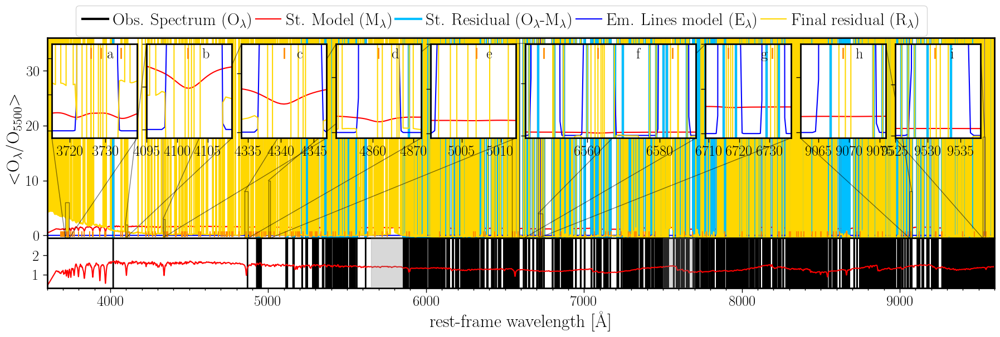

In [11]:
DIR='/disk-a/sanchez/LVM/LVM/ver_231113/output_dap_v1.1.0_tests/'

file='m_junk-00007337.output.fits'
#file='m_junk-00006109.output.fits'
#file='m_junk-orion.output.fits'

out_file_fit=f'{DIR}/{file}'
out_file_ps=f'{DIR}/m_junk-orion.rsp.txt'
output_path='figs/'
#outfile='test.pdf'
outfile=f'm_fit_sim.pdf'
tab_el=read_tab_EL('_legacy/emission_lines_long_list.LVM')
plot_spec(dir='',file=out_file_fit,\
            file_ssp = out_file_ps,\
                  name=None,text=None,output=f'{output_path}/{outfile}',\
                  insets=((0.005, 0.5, 0.09, 0.47,3715,3739,-0.5,6,'a'),\
                          (0.105, 0.5, 0.09, 0.47,4095,4109,-0.2,2,'b'),\
                          (0.205, 0.5, 0.09, 0.47,4334,4347,-0.2,3,'c'),\
                          (0.305, 0.5, 0.09, 0.47,4851,4872,-0.5,8,'d'),\
                          (0.405, 0.5, 0.09, 0.47,5001,5012,-0.5,10,'e'),\
                          (0.505, 0.5, 0.18, 0.47,6543,6590,-1,35,'f'),\
                          (0.695, 0.5, 0.09, 0.47,6709,6737,-0.2,4,'g'),\
                          (0.795, 0.5, 0.09, 0.47,9062,9076,-0.5,8,'h'),\
                          (0.895, 0.5, 0.09, 0.47,9525,9538,-0.5,18,'i')),
                          y_min=-0.5,y_max=36,y0_d=0.3,y1_d=2.9,\
              x_min=3600,x_max=9600,plot_el=True, tab_el=tab_el,\
              colors_in=['black','red','deepskyblue','blue','gold','forestgreen'],\
         plot_res=True)

/tmp/ipykernel_58362/1734954440.py:1453: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


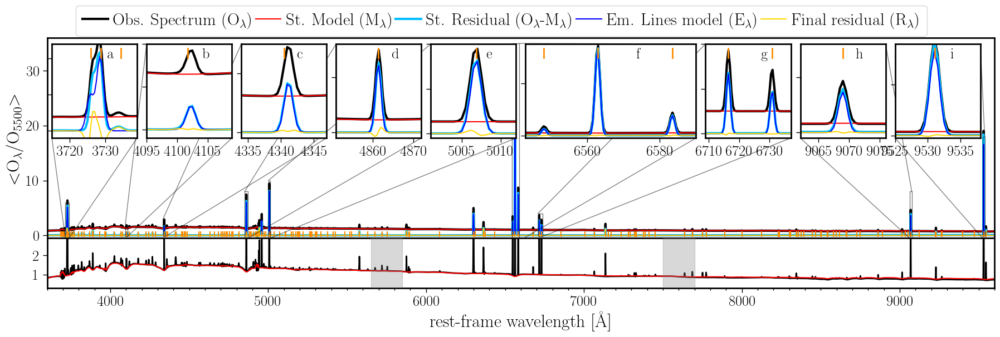

In [5]:
DIR='/disk-a/sanchez/LVM/LVM/ver_231113/output_dap/'
out_file_fit=f'{DIR}/m_test_el.output.fits'
out_file_ps=f'{DIR}/m_test_el.rsp.txt'
output_path='figs/'
#outfile='test.pdf'
outfile=f'm_fit_sim.pdf'
tab_el=read_tab_EL('_legacy/emission_lines_long_list.LVM')
plot_spec(dir='',file=out_file_fit,\
            file_ssp = out_file_ps,\
                  name=None,text=None,output=f'{output_path}/{outfile}',\
                  insets=((0.005, 0.5, 0.09, 0.47,3715,3739,-0.5,6,'a'),\
                          (0.105, 0.5, 0.09, 0.47,4095,4109,-0.2,2,'b'),\
                          (0.205, 0.5, 0.09, 0.47,4334,4347,-0.2,3,'c'),\
                          (0.305, 0.5, 0.09, 0.47,4851,4872,-0.5,8,'d'),\
                          (0.405, 0.5, 0.09, 0.47,5001,5012,-0.5,10,'e'),\
                          (0.505, 0.5, 0.18, 0.47,6543,6590,-1,35,'f'),\
                          (0.695, 0.5, 0.09, 0.47,6709,6737,-0.2,4,'g'),\
                          (0.795, 0.5, 0.09, 0.47,9062,9076,-0.5,8,'h'),\
                          (0.895, 0.5, 0.09, 0.47,9525,9538,-0.5,18,'i')),
                          y_min=-0.5,y_max=36,y0_d=0.3,y1_d=2.9,\
              x_min=3600,x_max=9600,plot_el=True, tab_el=tab_el,\
              colors_in=['black','red','deepskyblue','blue','gold','forestgreen'],\
         plot_res=True)

In [ ]:
DIR='/disk-a/sanchez/LVM/LVM/ver_231113/output_dap/'
out_file_fit=f'{DIR}/m_test_el.output.fits'
out_file_ps=f'{DIR}/m_test_el.rsp.txt'
output_path='figs/'
#outfile='test.pdf'
outfile=f'm_fit_sim.pdf'
tab_el=read_tab_EL('_legacy/emission_lines_long_list.LVM')
plot_spec(dir='',file=out_file_fit,\
            file_ssp = out_file_ps,\
                  name=None,text=None,output=f'{output_path}/{outfile}',\
                  insets=((0.005, 0.5, 0.09, 0.47,3715,3739,-0.5,6,'a'),\
                          (0.105, 0.5, 0.09, 0.47,4095,4109,-0.2,2,'b'),\
                          (0.205, 0.5, 0.09, 0.47,4334,4347,-0.2,3,'c'),\
                          (0.305, 0.5, 0.09, 0.47,4851,4872,-0.5,8,'d'),\
                          (0.405, 0.5, 0.09, 0.47,5001,5012,-0.5,10,'e'),\
                          (0.505, 0.5, 0.18, 0.47,6543,6590,-1,35,'f'),\
                          (0.695, 0.5, 0.09, 0.47,6709,6737,-0.2,4,'g'),\
                          (0.795, 0.5, 0.09, 0.47,9062,9076,-0.5,8,'h'),\
                          (0.895, 0.5, 0.09, 0.47,9525,9538,-0.5,18,'i')),
                          y_min=-0.5,y_max=36,y0_d=0.3,y1_d=2.9,\
              x_min=3600,x_max=9600,plot_el=True, tab_el=tab_el,\
              colors_in=['black','red','deepskyblue','blue','gold','forestgreen'],\
         plot_res=True)

1.1287904782194405e-06
12401


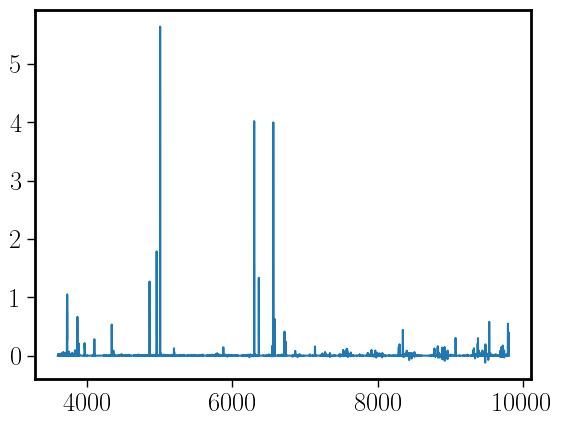

In [59]:
hdu=fits.open('output_dap_v1.1.0_tests/m_junk-00007337.output.fits')
wave = hdu[0].header['CRVAL1']+hdu[0].header['CDELT1']*np.arange(hdu[0].data.shape[1])
data=hdu[0].data
gas = data[0,:] - data[5,:]
smooth = data[3,:] - data[4,:] - gas        
ssp_model = data[1,:]-smooth
#plt.plot(wave,hdu[0].data[0,:])#/np.abs(np.nanmedian(hdu[0].data[0,300:1200])))
scale=np.abs(np.nanmedian(hdu[0].data[0,300:1200]))
print(scale)
#plt.plot(wave,hdu[0].data[0,:]/np.abs(np.nanmedian(hdu[0].data[0,300:1200])))

mask_Ha = (wave>6540) & (wave<6590)
print(len(mask_Ha))
plt.plot(wave,hdu[0].data[0,:]/np.abs(np.nanmax(hdu[0].data[0,:][mask_Ha]))*4)
#plt.plot(wave,hdu[0].data[0,:]/np.abs(np.nanmean(hdu[0].data[0,300:1200])))

In [62]:
def find_nearest(array, value):
    array = np.asarray(array)
    idx = (np.abs(array - value)).argmin()
    return array[idx]

i0 = (np.abs(wave - 6540)).argmin()
i1 = (np.abs(wave - 6590)).argmin() 
print(i0,i1)

5880 5980


(-1.0, 2.0)

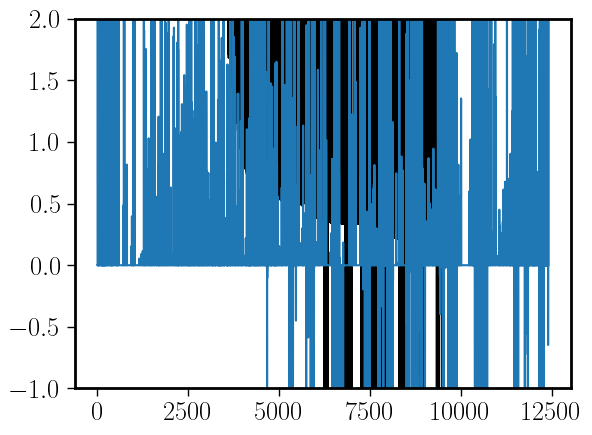

In [22]:
hdu=fits.open('output_dap_v1.1.0_tests/m_junk-00007337.output.fits')
wave = hdu[0].header['CRVAL1']+hdu[0].header['CDELT1']*np.arange(hdu[0].data.shape[1])
data=hdu[0].data

plt.plot(wave,hdu[0].data[0,:]/np.abs(np.nanmedian(hdu[0].data[0,300:1200])),color='black')


gas = data[0,:] - data[5,:]
smooth = data[3,:] - data[4,:] - gas        
ssp_model = data[1,:]-smooth
n_ord=0
if (n_ord>2):
    f_rat = ssp_model/data[0,:]
    c_rat0 = np.polyfit(wave, f_rat, n_ord)
    p_rat0 = np.poly1d(c_rat0)(wave)
    ssp_model = ssp_model*(1+1/p_rat0)*0.5
    ssp_model2 = ssp_model/p_rat0




#for I,spec in enumerate(hdu[0].data):
#    plt.plot(spec,alpha=0.3)
#    print(I)
plt.plot(hdu[0].data[0,:])#/np.abs(np.nanmedian(hdu[0].data[0,300:1200])))
#plt.plot(hdu[0].data[1,:]/np.abs(np.nanmedian(hdu[0].data[0,300:1200])))

data=hdu[0].data
gas = data[0,:] - data[5,:]
smooth = data[3,:] - data[4,:] - gas        
ssp_model = data[1,:]-smooth
#plt.plot(ssp_model/np.abs(np.nanmedian(hdu[0].data[0,300:1200])))

#plt.plot(hdu[0].data[6,:]/np.abs(np.nanmedian(hdu[0].data[0,300:1200])))
#plt.plot(ssp_model2,linewidth=3)
#plt.plot((hdu[0].data[0,:]-smooth)/p_rat0)
#plt.plot(p_rat0)
#plt.ylim(-100,500)
#plt.xlim(500,1500)

plt.ylim(-1,2)
#plt.plot(hdu[0].data[1,:]-hdu[0].data[4,:])
#plt.plot(hdu[0].data[5,:]-hdu[0].data[4,:])
#hdu[0].header


(-1.0, 2.0)

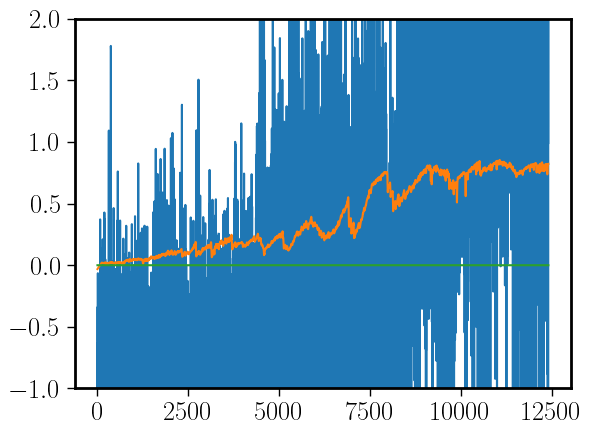

In [236]:
hdu=fits.open('output_dap_v1.0.3_atl/m_dap-rsp108-sn20-00003723.output.fits')
wave = hdu[0].header['CRVAL1']+hdu[0].header['CDELT1']*np.arange(hdu[0].data.shape[1])
data=hdu[0].data
gas = data[0,:] - data[5,:]
smooth = data[3,:] - data[4,:] - gas        
ssp_model = data[1,:]-smooth
n_ord=3
if (n_ord>2):
    f_rat = ssp_model/data[0,:]
    c_rat0 = np.polyfit(wave, f_rat, n_ord)
    p_rat0 = np.poly1d(c_rat0)(wave)
    ssp_model = ssp_model*(1+1/p_rat0)*0.5
    ssp_model2 = ssp_model/p_rat0




#for I,spec in enumerate(hdu[0].data):
#    plt.plot(spec,alpha=0.3)
#    print(I)
plt.plot(hdu[0].data[0,:]/np.abs(np.nanmedian(hdu[0].data[0,300:1200])))
plt.plot(hdu[0].data[1,:]/np.abs(np.nanmedian(hdu[0].data[0,300:1200])))

data=hdu[0].data
gas = data[0,:] - data[5,:]
smooth = data[3,:] - data[4,:] - gas        
ssp_model = data[1,:]-smooth
plt.plot(ssp_model/np.abs(np.nanmedian(hdu[0].data[0,300:1200])))

#plt.plot(hdu[0].data[6,:]/np.abs(np.nanmedian(hdu[0].data[0,300:1200])))
#plt.plot(ssp_model2,linewidth=3)
#plt.plot((hdu[0].data[0,:]-smooth)/p_rat0)
#plt.plot(p_rat0)
#plt.ylim(-100,500)
#plt.xlim(500,1500)

plt.ylim(-1,2)
#plt.plot(hdu[0].data[1,:]-hdu[0].data[4,:])
#plt.plot(hdu[0].data[5,:]-hdu[0].data[4,:])
#hdu[0].header


In [43]:
#
# routine to plot the spectra
#
def plot_spec_now(dir='output/',file='output.m_lvmSCFrame-00006109.fits.gz',\
              name='none',cmap=None,\
              x_min=3600,x_max=9600,y_min=-0.2,y_max=2,text='',\
              file_ssp = 'output/m_lvmSCFrame-00006109',no_st=False,no_model=False,log=False,\
              id_lines=None,output='junk.pdf',c_map='carlos',do_legend=True, insets=None,y0_d=0.5,y1_d=2.5,plot_el=False,tab_el=None,
              colors_in=['black','red','deepskyblue','blue','gold','forestgreen'],\
                  plot_res=False,\
                  show_scale=True,n_ord=11,gamma=0.3, props=dict(facecolor='lightgrey', alpha=0.5, edgecolor='darkgrey'),alpha=0.5):

    tab_SSP=read_rsp(file_ssp)
    
    if (cmap==None):
        color_cm_now = vel_map_CLC()
        cmap=color_cm_now
    file=dir+'/'+file
    hdu=fits.open(file)
    
#    hdu[0].data=gamma_scale(hdu[0].data,0.5)
#    gamma=1.0
    
    data=hdu[0].data
    (ny,nx)=data.shape
    
    
#    data=np.mean(data,axis=1)
#    i0 = int(nx*0.45)
#    i1 = int(nx*0.55)
    i0 = int(nx*0.15)
    i1 = int(nx*0.25)
    hdr=hdu[0].header
    crval = hdr['crval1']
    cdelt = hdr['cdelt1']
    crpix = hdr['crpix1']
    #print(data.shape)
    (ny,nx) = data.shape
    wave = crval+cdelt*(np.arange(0,nx)-(crpix-1))
    
    med_sc = np.abs(np.nanmedian(data[0,i0:i1]))
    std_sc = np.nanstd(data[0,i0:i1])
    SN_sc = med_sc / std_sc
    print(f'# S/N: {SN_sc} {med_sc} {std_sc}')
    
    data = data / np.abs(np.nanmedian(data[0,i0:i1]))
    if (ny==7):
        ssp_model=data[6,:]
    else:
        gas = data[0,:] - data[5,:]
        smooth = data[3,:] - data[4,:] - gas        
        ssp_model = data[1,:]-smooth

        mean_val_ssp = np.nanmean(ssp_model)
        print(f'# mean_val_ssp : {mean_val_ssp}')
        if (np.mean(ssp_model)<1e-5):
            ssp_model = data[1,:]
        
        if ((n_ord>2) and (SN_sc>3)):
            base = np.abs(data[0,:])
            f_rat = ssp_model/base
            #data[0,:]
            c_rat0 = np.polyfit(wave, f_rat, n_ord)
            p_rat0 = np.poly1d(c_rat0)(wave)
            ssp_model = ssp_model*(1+1/p_rat0)*0.5
            data[0,:]=(data[0,:]-smooth)*(1+1/p_rat0)*0.5
#            print(data[1,:])
            #except:
            #    show_scale=False  
            #    print('# Not scaling')
        if (show_scale==True):
            ssp_model = data[1,:]


    fig = plt.figure(figsize=(19,11)) 
    gs = fig.add_gridspec(nrows=10, ncols=6,  left=0.075, right=0.97, \
                          hspace=0.0, wspace=0.05, bottom=0.15, top=0.9)

    ax2 = fig.add_subplot(gs[:, :])
    ax0 = fig.add_subplot(gs[0:3, :])#, sharex=ax2)   
    ax2.set_xticks([])
    ax2.set_yticks([])
    plt.setp(ax2.spines.values(), color=None)
    
    
    #ax2.set_axis_off()
    #ax2.set_xticks([])
    #ax2.set_yticks([])
    #ax2.spines['top'].set_visible(False)
    #ax2.spines['bottom'].set_visible(False)
    #ax2.spines['right'].set_visible(False)
    #ax2.spines['left'].set_visible(False)


    #ax2.set_visible(False)
    #ax1 = fig.add_subplot(gs[3:5, :], sharex=ax0)   
    #ax2.yticklabels=[]
    ax0.set_xlim(x_min,x_max)
    #ax1.set_xlim(x_min,x_max)
    #ax2.set_xlim(x_min,x_max)
    if (y_min>=0):
        sign=1
    else:
        sign=-1
    ax0.set_ylim(sign*np.abs(y_min**gamma),y_max**gamma)        

        
 #   colors=['black','maroon','steelblue','darkorange','olive','grey']
#    colors=['black','palegreen','steelblue','darkorange','olive','grey']
#    colors=['black','lightsalmon','steelblue','darkorange','olive','grey']
    colors=colors_in
            #ax1.plot(wave,ssp_model,color=colors[1],alpha=1.0,linewidth=1.5,linestyle="solid")#,label=r'Model (M$_\lambda$)')
    res = data[0,:]-data[1,:]+smooth
    gas_model = data[2,:]-data[1,:]
    ax0.plot(wave,gamma_scale((data[0,:]+smooth),gamma)-gamma_scale(data[1,:],gamma),color=colors[2],alpha=alpha,\
             label=r'St. Residual (O$_\lambda$-M$_\lambda$)',linewidth=3)
    if (no_model==False):
        ax0.plot(wave,gamma_scale(data[2,:],gamma)-gamma_scale(data[1,:],gamma),color=colors[3],alpha=alpha,linewidth=1.5,\
                 label=r'Em. Lines model (E$_\lambda$)',linestyle="solid")
    if (plot_res==True):
#        ax0.plot(wave,data[4,:]**gamma,color=colors[4],alpha=1.0,linewidth=1.5,\
        ax0.plot(wave,gamma_scale((data[0,:]+smooth),gamma)-gamma_scale(data[1,:],gamma)-(gamma_scale(data[2,:],gamma)-gamma_scale(data[1,:],gamma)),color=colors[4],alpha=alpha,linewidth=1.5,\
                 label=r'Final residual (R$_\lambda$)',linestyle="solid")
    
    std_res = np.std(res[2000:2500])
    flux = np.median(data[1,2000:2500])
    #ax1.axvspan(5650, 5850, alpha=0.3, color='grey',zorder=10)
    #ax1.axvspan(7500, 7700, alpha=0.3, color='grey',zorder=10)
    if (no_st==False):
        ax0.plot(wave,gamma_scale(data[0,:],gamma),\
                 color=colors[0],alpha=1.0,linewidth=3.0,\
                 label=r'Obs. Spectrum (O$_\lambda$)')
        if (no_model==False):
            ax0.plot(wave,gamma_scale(ssp_model,gamma),color=colors[1],\
                     alpha=alpha,linewidth=1.5,\
                     label=r'St. Model (M$_\lambda$)',linestyle="solid")
    

    ax0.xaxis.set_minor_locator(MultipleLocator(100))
    #ax0.axes.get_xaxis().set_visible(False)
    handles, labels = ax0.get_legend_handles_labels()
    if (do_legend):
        ax0.legend(handles, labels,loc=(0.03,1.01),frameon=True,handlelength=1.5,\
                   ncol=5,columnspacing=0.15, prop={'size': 22})
    x = np.arange(x_min,1.1*x_max,100)
    y1 = 5+0*x
    y0 = -5+0*x

    if (id_lines != None):
        #colors=['black','lightsalmon','steelblue','darkorange','olive','grey']
        #        colors=['black','palegreen','steelblue','darkorange','olive','grey']
        #colors=['darkred','firebrick','indianred']
        mask_lines = (id_lines['wl'].value>=x_min) & (id_lines['wl'].value<x_max)
        tab_elines = id_lines[mask_lines]
        even=0
        for line in tab_elines:
            ax0.text(line['wl'],y_max-0.16*(even+1)*(y_max-y_min),\
                     f"{line['wl']}",color=colors[even],\
                     fontsize='16',horizontalalignment='center',rotation='vertical')
            even=even+1
            if (even>2):
                even=0
        #print(tab_elines)
        
    if (insets != None):
        for Iinst,inst in enumerate(insets):
            #x1, x2, y1, y2 = -1.5, -0.9, -2.5, -1.9  # subregion of the original image
            axins = ax0.inset_axes(
                [inst[0], inst[1], inst[2], inst[3]],
                xlim=(inst[4], inst[5]), ylim=(inst[6], inst[7]),yticklabels=[])#, xticklabels=[], yticklabels=[])
            if ((Iinst==0)|(Iinst==9)):
                axins.set_ylabel(r'Flux$_\lambda$', fontsize=23)

            if (no_st==False):
                axins.plot(wave,data[0,:],color=colors[0],alpha=1.0,linewidth=3,label=r'Observed (O$_\lambda$)')
            if (no_model==False):
                axins.plot(wave,ssp_model,color=colors[1],alpha=1.0,linewidth=1.5,label=r'Model (M$_\lambda$)',linestyle="solid")
            axins.plot(wave,res,color=colors[2],alpha=1.0,linewidth=3,\
                       label=r'Residual (O$_\lambda$-M$_\lambda$)')
            if (no_model==False):
                axins.plot(wave,gas_model,color=colors[3],alpha=1.0,linewidth=1.5,\
                           label=r'E. lines model',linestyle="solid")
            if (plot_res==True):
                axins.plot(wave,data[4,:],color=colors[4],alpha=1.0,linewidth=1.5,\
                           label=r'Em. lines model (E$_\lambda$)',linestyle="solid")
                
            if (plot_el == True):
                tab_el_now=tab_el[(tab_el['wl']>inst[4]) & (tab_el['wl']<inst[5])]
                for vals in tab_el_now:
                    axins.plot([vals['wl'],vals['wl']],\
                             [inst[7]-0.05*abs(inst[7]-inst[6]),\
                              inst[7]-0.15*abs(inst[7]-inst[6])],\
                             color='darkorange',linewidth=2)
                axins.text(inst[4]+0.1*np.abs(inst[5]-inst[4]),\
                           inst[7]-0.15*abs(inst[7]-inst[6]),fr'\bf {inst[8]}',bbox=props)#,\
                           #color='darkorange')
            #ax0.indicate_inset_zoom(axins, edgecolor="black")

        
    #ax0.set_ylabel(r'$<$O$_\lambda$/O$_{5500}$$>$', fontsize=23)
    ax0.text(x_min+0.05*(x_max-x_min),y_min+0.85*(y_max-y_min),text,fontsize=21)
    ax2.set_xlabel(r'rest-frame wavelength [\AA]', fontsize=23)
    ax2.set_ylim(y0_d,y1_d)
    if (plot_el == True):
        for vals in tab_el:
            ax0.plot([vals['wl'],vals['wl']],\
                     [y_max**gamma-0.02*abs(y_max**gamma-y_min**gamma),y_max**gamma-0.10*abs(y_max**gamma-y_min**gamma)],\
                     color='darkorange')
#            ax0.plot([vals['wl'],vals['wl']],\
#                     [y_max-0.05*abs(y_max-y_min),y_max-0.15*abs(y_max-y_min)],\
#                     color='darkorange')
    if (log==True):
        ax0.set_yscale('log')
    ax0.axvspan(5600, 5850, alpha=0.7, color='grey',zorder=10)
    ax0.axvspan(7400, 7800, alpha=0.7, color='grey',zorder=10)        
    sgamma=str(gamma)
#    ax0.set_ylabel(r'Flux$^{0.5}_\lambda$ [10$^{-16}$ erg/cm$^2$/s]', fontsize=23)  
    ax0.set_ylabel(r'Flux$^{0.5}_\lambda$', fontsize=23)  
    
    plt.tight_layout()
    fig.savefig(output, transparent=False, facecolor='white', edgecolor='white')#.pdf")

In [94]:
#
# routine to plot the spectra
#
def plot_spec_now_3pg(dir='output/',file='output.m_lvmSCFrame-00006109.fits.gz',\
              name='none',cmap=None,\
              x_min=3600,x_max=9600,y_min=-0.2,y_max=2,text='',\
              file_ssp = 'output/m_lvmSCFrame-00006109',no_st=False,no_model=False,log=False,\
              id_lines=None,output='junk.pdf',c_map='carlos',do_legend=True, insets=None,y0_d=0.5,y1_d=2.5,plot_el=False,tab_el=None,
              colors_in=['black','red','deepskyblue','blue','gold','forestgreen'],\
                  plot_res=False,\
                  show_scale=True,n_ord=11,gamma=0.3, props=dict(facecolor='lightgrey', alpha=0.5, edgecolor='darkgrey'),alpha=0.5):

    tab_SSP=read_rsp(file_ssp)
    
    if (cmap==None):
        color_cm_now = vel_map_CLC()
        cmap=color_cm_now
    file=dir+'/'+file
    hdu=fits.open(file)
    
#    hdu[0].data=gamma_scale(hdu[0].data,0.5)
#    gamma=1.0
    
    data=hdu[0].data
    (ny,nx)=data.shape
    
    
#    data=np.mean(data,axis=1)
#    i0 = int(nx*0.45)
#    i1 = int(nx*0.55)
    i0 = int(nx*0.15)
    i1 = int(nx*0.25)
    hdr=hdu[0].header
    crval = hdr['crval1']
    cdelt = hdr['cdelt1']
    crpix = hdr['crpix1']
    #print(data.shape)
    (ny,nx) = data.shape
    wave = crval+cdelt*(np.arange(0,nx)-(crpix-1))
    #i0 = (np.abs(wave - 6540)).argmin()
    #i1 = (np.abs(wave - 6590)).argmin() 
    med_sc = np.abs(np.nanmedian(data[0,i0:i1]))
    std_sc = np.nanstd(data[0,i0:i1])
    SN_sc = med_sc / std_sc
    print(f'# S/N: {SN_sc} {med_sc} {std_sc}')
    
    sc_data = np.abs(np.nanmedian(data[0,i0:i1]))+0.05*np.abs(np.nanstd(data[0,i0:i1]))
    #sc_data = np.abs(np.nanmax(data[0,i0:i1])/100)

    data = data / sc_data
    if (ny==7):
        ssp_model=data[6,:]
    else:
        gas = data[0,:] - data[5,:]
        smooth = data[3,:] - data[4,:] - gas        
        ssp_model = data[1,:]-smooth

        mean_val_ssp = np.nanmean(ssp_model)
        print(f'# mean_val_ssp : {mean_val_ssp}')
        if (np.mean(ssp_model)<1e-5):
            ssp_model = data[1,:]
        
        if ((n_ord>2) and (SN_sc>3)):
            base = np.abs(data[0,:])
            f_rat = ssp_model/base
            #data[0,:]
            c_rat0 = np.polyfit(wave, f_rat, n_ord)
            p_rat0 = np.poly1d(c_rat0)(wave)
            ssp_model = ssp_model*(1+1/p_rat0)*0.5
            data[0,:]=(data[0,:]-smooth)*(1+1/p_rat0)*0.5
#            print(data[1,:])
            #except:
            #    show_scale=False  
            #    print('# Not scaling')
        if (show_scale==True):
            ssp_model = data[1,:]


    fig = plt.figure(figsize=(19,19)) 
    gs = fig.add_gridspec(nrows=10, ncols=12,  left=0.175, right=0.97, \
                          hspace=0.35, wspace=0.05, bottom=0.15, top=0.9)

    ax2 = fig.add_subplot(gs[8:10, :])
    
    ax0 = fig.add_subplot(gs[0:2, :])#, sharex=ax2)   
    ax0m = fig.add_subplot(gs[2:4, :])
    ax0u = fig.add_subplot(gs[4:6, :])

    
    ax2.set_xticks([])
    ax2.set_yticks([])
    plt.setp(ax2.spines.values(), color=None)
    
    
    #ax2.set_axis_off()
    #ax2.set_xticks([])
    #ax2.set_yticks([])
    #ax2.spines['top'].set_visible(False)
    #ax2.spines['bottom'].set_visible(False)
    #ax2.spines['right'].set_visible(False)
    #ax2.spines['left'].set_visible(False)


    #ax2.set_visible(False)
    #ax1 = fig.add_subplot(gs[3:5, :], sharex=ax0)   
    #ax2.yticklabels=[]
    ax0.set_xlim(x_min[0],x_max[0])
    ax0m.set_xlim(x_min[1],x_max[1])
    ax0u.set_xlim(x_min[2],x_max[2])
    #ax1.set_xlim(x_min,x_max)
    #ax2.set_xlim(x_min,x_max)
    if (y_min>=0):
        sign=1
    else:
        sign=-1
    ax0.set_ylim(sign*np.abs(y_min**gamma),y_max**gamma)        
    ax0u.set_ylim(sign*np.abs(y_min**gamma),y_max**gamma)        
    ax0m.set_ylim(sign*np.abs(y_min**gamma),y_max**gamma)        

        
    colors=colors_in
            #ax1.plot(wave,ssp_model,color=colors[1],alpha=1.0,linewidth=1.5,linestyle="solid")#,label=r'Model (M$_\lambda$)')
    res = data[0,:]-data[1,:]+smooth
    gas_model = data[2,:]-data[1,:]
    ax0.plot(wave,gamma_scale((data[0,:]+smooth),gamma)-gamma_scale(data[1,:],gamma),color=colors[2],alpha=alpha,\
             label=r'St. Residual (O$_\lambda$-M$_\lambda$)',linewidth=3)
    ax0u.plot(wave,gamma_scale((data[0,:]+smooth),gamma)-gamma_scale(data[1,:],gamma),color=colors[2],alpha=alpha,\
             label=r'St. Residual (O$_\lambda$-M$_\lambda$)',linewidth=3)
    ax0m.plot(wave,gamma_scale((data[0,:]+smooth),gamma)-gamma_scale(data[1,:],gamma),color=colors[2],alpha=alpha,\
             label=r'St. Residual (O$_\lambda$-M$_\lambda$)',linewidth=3)
    if (no_model==False):
        ax0.plot(wave,gamma_scale(data[2,:],gamma)-gamma_scale(data[1,:],gamma),color=colors[3],alpha=alpha,linewidth=1.5,\
                 label=r'Em. Lines model (E$_\lambda$)',linestyle="solid")
        ax0u.plot(wave,gamma_scale(data[2,:],gamma)-gamma_scale(data[1,:],gamma),color=colors[3],alpha=alpha,linewidth=1.5,\
                 label=r'Em. Lines model (E$_\lambda$)',linestyle="solid")
        ax0m.plot(wave,gamma_scale(data[2,:],gamma)-gamma_scale(data[1,:],gamma),color=colors[3],alpha=alpha,linewidth=1.5,\
                 label=r'Em. Lines model (E$_\lambda$)',linestyle="solid")
    if (plot_res==True):
        ax0.plot(wave,gamma_scale((data[0,:]+smooth),gamma)-gamma_scale(data[1,:],gamma)-(gamma_scale(data[2,:],gamma)-gamma_scale(data[1,:],gamma)),color=colors[4],alpha=alpha,linewidth=1.5,\
                 label=r'Final residual (R$_\lambda$)',linestyle="solid")
        ax0u.plot(wave,gamma_scale((data[0,:]+smooth),gamma)-gamma_scale(data[1,:],gamma)-(gamma_scale(data[2,:],gamma)-gamma_scale(data[1,:],gamma)),color=colors[4],alpha=alpha,linewidth=1.5,\
                 label=r'Final residual (R$_\lambda$)',linestyle="solid")
        ax0m.plot(wave,gamma_scale((data[0,:]+smooth),gamma)-gamma_scale(data[1,:],gamma)-(gamma_scale(data[2,:],gamma)-gamma_scale(data[1,:],gamma)),color=colors[4],alpha=alpha,linewidth=1.5,\
                 label=r'Final residual (R$_\lambda$)',linestyle="solid")
    
    std_res = np.std(res[2000:2500])
    flux = np.median(data[1,2000:2500])
    #ax1.axvspan(5650, 5850, alpha=0.3, color='grey',zorder=10)
    #ax1.axvspan(7500, 7700, alpha=0.3, color='grey',zorder=10)
    if (no_st==False):
        ax0.plot(wave,gamma_scale(data[0,:],gamma),\
                 color=colors[0],alpha=1.0,linewidth=3.0,\
                 label=r'Obs. Spectrum (O$_\lambda$)')
        ax0u.plot(wave,gamma_scale(data[0,:],gamma),\
                 color=colors[0],alpha=1.0,linewidth=3.0,\
                 label=r'Obs. Spectrum (O$_\lambda$)')
        ax0m.plot(wave,gamma_scale(data[0,:],gamma),\
                 color=colors[0],alpha=1.0,linewidth=3.0,\
                 label=r'Obs. Spectrum (O$_\lambda$)')
        if (no_model==False):
            ax0.plot(wave,gamma_scale(ssp_model,gamma),color=colors[1],\
                     alpha=alpha,linewidth=1.5,\
                     label=r'St. Model (M$_\lambda$)',linestyle="solid")
            ax0u.plot(wave,gamma_scale(ssp_model,gamma),color=colors[1],\
                     alpha=alpha,linewidth=1.5,\
                     label=r'St. Model (M$_\lambda$)',linestyle="solid")
            ax0m.plot(wave,gamma_scale(ssp_model,gamma),color=colors[1],\
                     alpha=alpha,linewidth=1.5,\
                     label=r'St. Model (M$_\lambda$)',linestyle="solid")
    

    ax0.xaxis.set_minor_locator(MultipleLocator(100))
    #ax0.axes.get_xaxis().set_visible(False)
    handles, labels = ax0.get_legend_handles_labels()
    if (do_legend):
        ax0.legend(handles, labels,loc=(-0.005,1.01),frameon=True,handlelength=1.5,\
                   ncol=5,columnspacing=0.15, prop={'size': 22})
    x = np.arange(x_min[0],1.1*x_max[2],100)
    y1 = 5+0*x
    y0 = -5+0*x

    if (id_lines != None):
        #colors=['black','lightsalmon','steelblue','darkorange','olive','grey']
        #        colors=['black','palegreen','steelblue','darkorange','olive','grey']
        #colors=['darkred','firebrick','indianred']
        mask_lines = (id_lines['wl'].value>=x_min) & (id_lines['wl'].value<x_max)
        tab_elines = id_lines[mask_lines]
        even=0
        for line in tab_elines:
            ax0.text(line['wl'],y_max-0.16*(even+1)*(y_max-y_min),\
                     f"{line['wl']}",color=colors[even],\
                     fontsize='16',horizontalalignment='center',rotation='vertical')
            even=even+1
            if (even>2):
                even=0
        #print(tab_elines)
        
    if (insets != None):
        for Iinst,inst in enumerate(insets):
            #x1, x2, y1, y2 = -1.5, -0.9, -2.5, -1.9  # subregion of the original image
            axins = ax0.inset_axes(
                [inst[0], inst[1], inst[2], inst[3]],
                xlim=(inst[4], inst[5]), ylim=(inst[6], inst[7]),\
                yticklabels=[])#, xticklabels=[], yticklabels=[])
            if ((Iinst==0)|(Iinst==9)):
                axins.set_ylabel(r'Flux$_\lambda$', fontsize=23)

            if (no_st==False):
                axins.plot(wave,data[0,:],color=colors[0],alpha=1.0,linewidth=3,label=r'Observed (O$_\lambda$)')
            if (no_model==False):
                axins.plot(wave,ssp_model,color=colors[1],alpha=1.0,linewidth=1.5,label=r'Model (M$_\lambda$)',linestyle="solid")
            axins.plot(wave,res,color=colors[2],alpha=1.0,linewidth=3,\
                       label=r'Residual (O$_\lambda$-M$_\lambda$)')
            if (no_model==False):
                axins.plot(wave,gas_model,color=colors[3],alpha=1.0,linewidth=1.5,\
                           label=r'E. lines model',linestyle="solid")
            if (plot_res==True):
                axins.plot(wave,data[4,:],color=colors[4],alpha=1.0,linewidth=1.5,\
                           label=r'Em. lines model (E$_\lambda$)',linestyle="solid")
                
            if (plot_el == True):
                tab_el_now=tab_el[(tab_el['wl']>inst[4]) & (tab_el['wl']<inst[5])]
                for vals in tab_el_now:
                    axins.plot([vals['wl'],vals['wl']],\
                             [inst[7]-0.05*abs(inst[7]-inst[6]),\
                              inst[7]-0.15*abs(inst[7]-inst[6])],\
                             color='darkorange',linewidth=2)
                axins.text(inst[4]+0.1*np.abs(inst[5]-inst[4]),\
                           inst[7]-0.15*abs(inst[7]-inst[6]),fr'\bf {inst[8]}',bbox=props)#,\
                           #color='darkorange')
            #ax0.indicate_inset_zoom(axins, edgecolor="black")

        
    #ax0.set_ylabel(r'$<$O$_\lambda$/O$_{5500}$$>$', fontsize=23)
    ax0.text(x_min[0]+0.05*(x_max[0]-x_min[0]),y_min+0.85*(y_max-y_min),text,fontsize=21)
    ax0m.text(x_min[1]+0.05*(x_max[1]-x_min[1]),y_min+0.85*(y_max-y_min),text,fontsize=21)
    ax0u.text(x_min[2]+0.05*(x_max[2]-x_min[2]),y_min+0.85*(y_max-y_min),text,fontsize=21)
    ax2.set_xlabel(r'rest-frame wavelength [\AA]', fontsize=23)
#    ax2.set_xlabel(r'rest-frame wavelength [\AA]', fontsize=23)
#    ax2.set_ylim(y0_d,y1_d)
    if (plot_el == True):
        for vals in tab_el:
            ax0.plot([vals['wl'],vals['wl']],\
                     [y_max**gamma-0.02*abs(y_max**gamma-y_min**gamma),y_max**gamma-0.10*abs(y_max**gamma-y_min**gamma)],\
                     color='darkorange')
            ax0u.plot([vals['wl'],vals['wl']],\
                     [y_max**gamma-0.02*abs(y_max**gamma-y_min**gamma),y_max**gamma-0.10*abs(y_max**gamma-y_min**gamma)],\
                     color='darkorange')
            ax0m.plot([vals['wl'],vals['wl']],\
                     [y_max**gamma-0.02*abs(y_max**gamma-y_min**gamma),y_max**gamma-0.10*abs(y_max**gamma-y_min**gamma)],\
                     color='darkorange')

    if (log==True):
        ax0.set_yscale('log')
    ax0.axvspan(5600, 5850, alpha=0.7, color='grey',zorder=10)
    ax0.axvspan(7400, 7800, alpha=0.7, color='grey',zorder=10)        
    ax0u.axvspan(5600, 5850, alpha=0.7, color='grey',zorder=10)
    ax0u.axvspan(7400, 7800, alpha=0.7, color='grey',zorder=10)        
    ax0m.axvspan(5600, 5850, alpha=0.7, color='grey',zorder=10)
    ax0m.axvspan(7400, 7800, alpha=0.7, color='grey',zorder=10)        
    sgamma=str(gamma)
#    ax0.set_ylabel(r'Flux$^{0.5}_\lambda$ [10$^{-16}$ erg/cm$^2$/s]', fontsize=23)  
    ax0.set_ylabel(r'Flux$^{0.5}_\lambda$', fontsize=23)  
    ax0u.set_ylabel(r'Flux$^{0.5}_\lambda$', fontsize=23)  
    ax0m.set_ylabel(r'Flux$^{0.5}_\lambda$', fontsize=23)  
    
    plt.tight_layout()
    fig.savefig(output, transparent=False, facecolor='white', edgecolor='white')#.pdf")

# S/N: 0.8209542416484678 124.73649514277852 151.94086200506
# mean_val_ssp : 0.6084697681403763


/tmp/ipykernel_58362/4094484561.py:5: RuntimeWarning: invalid value encountered in divide
  return (flux/np.abs(flux))*(np.abs(flux))**gamma
/tmp/ipykernel_58362/3705255258.py:267: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


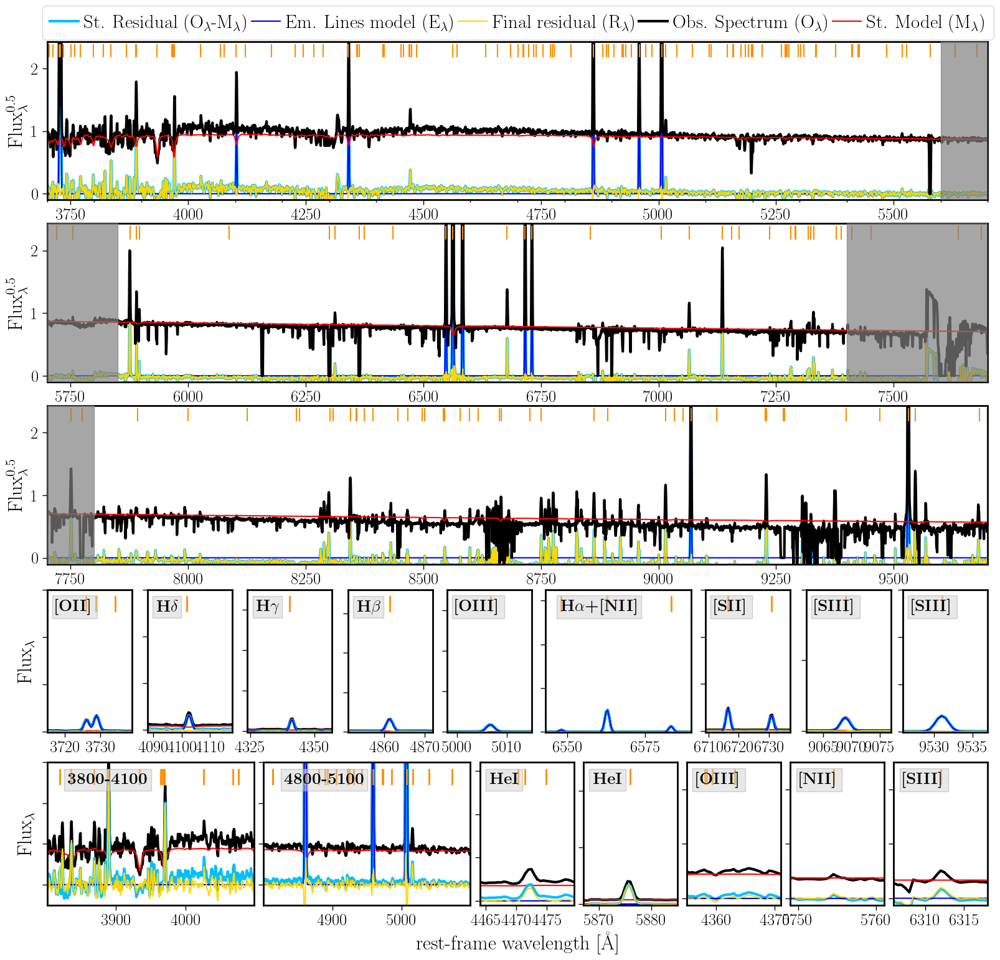

In [101]:

#file='m_junk-00007337.output.fits'
file='m_junk-00006109.output.fits'
#file='m_junk-orion.output.fits'



y_off = -2.27-1.09
y_off2 = -2.27-2.18
plot_spec_now_3pg(dir='output_dap_v1.1.0_tests/',file=file,\
          file_ssp = 'output_dap/m_sel-ORION.rsp.txt',\
          name='6110',text='',c_map='CMRmap',output='figs/m_sel-test.png',\
              insets=((0.00, y_off, 0.09, 0.9,3715,3739,-1,150,'[OII]'),\
                          (0.107, y_off, 0.09, 0.9,4088,4118,-0.5,30,r'H$\delta$'),\
                          (0.213, y_off, 0.09, 0.9,4324,4357,-0.5,70,r'H$\gamma$'),\
                          (0.320, y_off, 0.09, 0.9,4851,4872,-1.0,180,r'H$\beta$'),\
                          (0.425, y_off, 0.09, 0.9,4998,5015,-1.0,350,'[OIII]'),\
                          (0.530, y_off, 0.155, 0.9,6543,6590,-2,650,r'H$\alpha$+[NII]'),\
                          (0.700, y_off, 0.09, 0.9,6709,6737,-0.5,60,'[SII]'),\
                          (0.807, y_off, 0.09, 0.9,9062,9077,-1.0,100,'[SIII]'),\
                          (0.910, y_off, 0.09, 0.9,9526,9537,-1.5,300,'[SIII]'),\
                      (0.00, y_off2, 0.22, 0.9,3801,4099,-0.5,3,'3800-4100'),\
                      (0.23, y_off2, 0.22, 0.9,4801,5099,-0.5,3,'4800-5100'),\
                      (0.46, y_off2, 0.10, 0.9,4472-8,4472+7.5,-0.25,8,'HeI'),\
                      (0.57, y_off2, 0.10, 0.9,5876-9,5876+9,-0.2,25,'HeI'),\
                      (0.68, y_off2, 0.10, 0.9,4363-8,4363+8,-0.25,5,'[OIII]'),\
                      (0.79, y_off2, 0.10, 0.9,5755-6,5755+6,-0.25,5,'[NII]'),\
                      (0.90, y_off2, 0.10, 0.9,6312-6,6312+6,-0.25,5,'[SIII]')
                     ),
                          y_min=-0.01,y_max=5.9,y0_d=0.3,y1_d=2.9,\
              x_min=(3700,5700,7700),x_max=(5700,7700,9700),plot_el=True, tab_el=tab_el,plot_res=True,show_scale=False,n_ord=31,gamma=0.5,alpha=1.0)#,x_min=3600,x_max=9600)
# (0.55, 0.5, 0.2, 0.47,6303,6325,0.85,1.7)

# S/N: 0.05331028147414349 5325.732177970534 99900.65763493702
# mean_val_ssp : 0.3510230798062392


/tmp/ipykernel_58362/3705255258.py:267: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


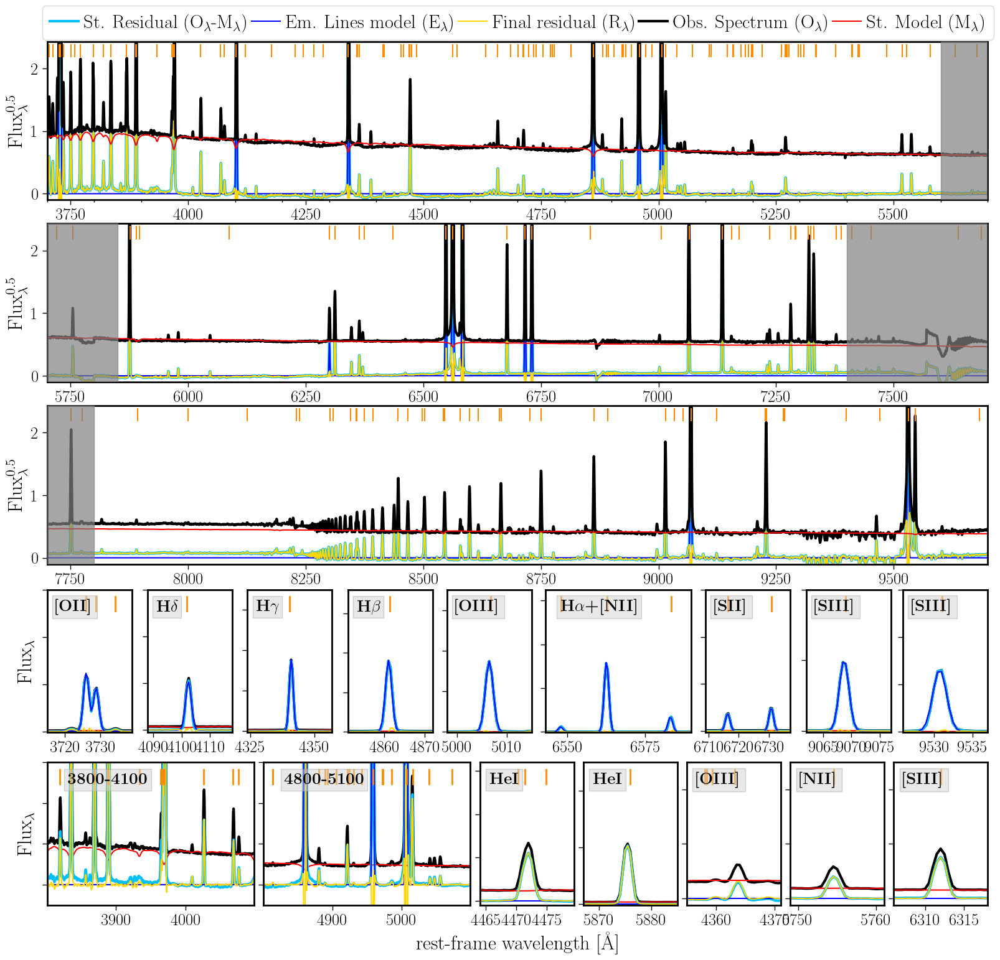

In [98]:
y_off = -2.27-1.09
y_off2 = -2.27-2.18
plot_spec_now_3pg(dir='output_dap',file='m_sel-ORION.output.fits',\
          file_ssp = 'output_dap/m_sel-ORION.rsp.txt',\
          name='6110',text='',c_map='CMRmap',output='figs/m_sel-ORION.png',\
              insets=((0.00, y_off, 0.09, 0.9,3715,3739,-1,150,'[OII]'),\
                          (0.107, y_off, 0.09, 0.9,4088,4118,-0.5,30,r'H$\delta$'),\
                          (0.213, y_off, 0.09, 0.9,4324,4357,-0.5,70,r'H$\gamma$'),\
                          (0.320, y_off, 0.09, 0.9,4851,4872,-1.0,180,r'H$\beta$'),\
                          (0.425, y_off, 0.09, 0.9,4998,5015,-1.0,350,'[OIII]'),\
                          (0.530, y_off, 0.155, 0.9,6543,6590,-2,650,r'H$\alpha$+[NII]'),\
                          (0.700, y_off, 0.09, 0.9,6709,6737,-0.5,60,'[SII]'),\
                          (0.807, y_off, 0.09, 0.9,9062,9077,-1.0,100,'[SIII]'),\
                          (0.910, y_off, 0.09, 0.9,9526,9537,-1.5,300,'[SIII]'),\
                      (0.00, y_off2, 0.22, 0.9,3801,4099,-0.5,3,'3800-4100'),\
                      (0.23, y_off2, 0.22, 0.9,4801,5099,-0.5,3,'4800-5100'),\
                      (0.46, y_off2, 0.10, 0.9,4472-8,4472+7.5,-0.25,8,'HeI'),\
                      (0.57, y_off2, 0.10, 0.9,5876-9,5876+9,-0.2,25,'HeI'),\
                      (0.68, y_off2, 0.10, 0.9,4363-8,4363+8,-0.25,5,'[OIII]'),\
                      (0.79, y_off2, 0.10, 0.9,5755-6,5755+6,-0.25,5,'[NII]'),\
                      (0.90, y_off2, 0.10, 0.9,6312-6,6312+6,-0.25,5,'[SIII]')
                     ),
                          y_min=-0.01,y_max=5.9,y0_d=0.3,y1_d=2.9,\
              x_min=(3700,5700,7700),x_max=(5700,7700,9700),plot_el=True, tab_el=tab_el,plot_res=True,show_scale=False,n_ord=115,gamma=0.5,alpha=1.0)#,x_min=3600,x_max=9600)
# (0.55, 0.5, 0.2, 0.47,6303,6325,0.85,1.7)

# S/N: 0.307404044366145 579.6447790960625 1885.6120786935876
# mean_val_ssp : 0.6477404950780895


/tmp/ipykernel_58362/4094484561.py:5: RuntimeWarning: invalid value encountered in divide
  return (flux/np.abs(flux))*(np.abs(flux))**gamma
/tmp/ipykernel_58362/3705255258.py:267: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


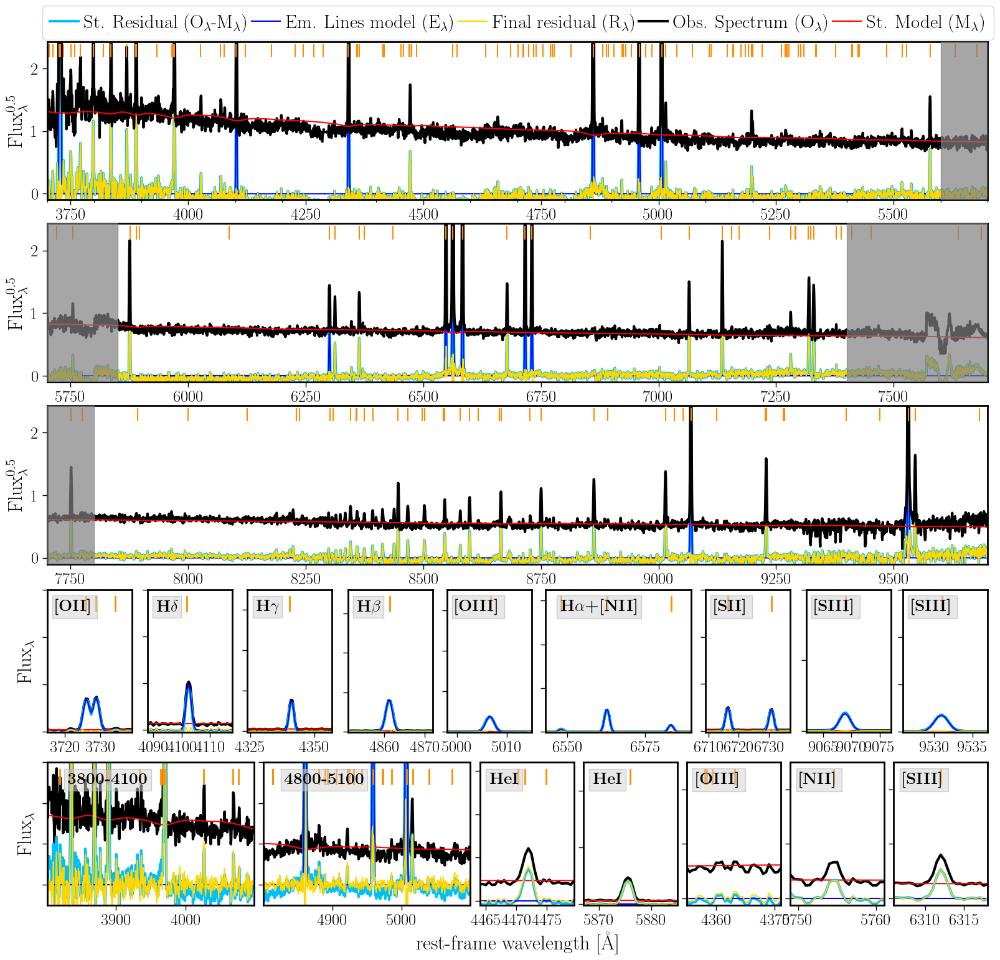

In [102]:
y_off = -2.27-1.09
y_off2 = -2.27-2.18
plot_spec_now_3pg(dir='orion',file='m_orion_all.output.fits',\
          file_ssp = 'orion/m_orion_all.rsp.txt',\
          name='6110',text='',c_map='CMRmap',output='figs/m_all-ORION.png',\
              insets=((0.00, y_off, 0.09, 0.9,3715,3739,-1,150,'[OII]'),\
                          (0.107, y_off, 0.09, 0.9,4088,4118,-0.5,30,r'H$\delta$'),\
                          (0.213, y_off, 0.09, 0.9,4324,4357,-0.5,70,r'H$\gamma$'),\
                          (0.320, y_off, 0.09, 0.9,4851,4872,-1.0,180,r'H$\beta$'),\
                          (0.425, y_off, 0.09, 0.9,4998,5015,-1.0,350,'[OIII]'),\
                          (0.530, y_off, 0.155, 0.9,6543,6590,-2,650,r'H$\alpha$+[NII]'),\
                          (0.700, y_off, 0.09, 0.9,6709,6737,-0.5,60,'[SII]'),\
                          (0.807, y_off, 0.09, 0.9,9062,9077,-1.0,100,'[SIII]'),\
                          (0.910, y_off, 0.09, 0.9,9526,9537,-1.5,300,'[SIII]'),\
                      (0.00, y_off2, 0.22, 0.9,3801,4099,-0.5,3,'3800-4100'),\
                      (0.23, y_off2, 0.22, 0.9,4801,5099,-0.5,3,'4800-5100'),\
                      (0.46, y_off2, 0.10, 0.9,4472-8,4472+7.5,-0.25,8,'HeI'),\
                      (0.57, y_off2, 0.10, 0.9,5876-9,5876+9,-0.2,25,'HeI'),\
                      (0.68, y_off2, 0.10, 0.9,4363-8,4363+8,-0.25,5,'[OIII]'),\
                      (0.79, y_off2, 0.10, 0.9,5755-6,5755+6,-0.25,5,'[NII]'),\
                      (0.90, y_off2, 0.10, 0.9,6312-6,6312+6,-0.25,5,'[SIII]')
                     ),
                          y_min=-0.01,y_max=5.9,y0_d=0.3,y1_d=2.9,\
              x_min=(3700,5700,7700),x_max=(5700,7700,9700),plot_el=True, tab_el=tab_el,plot_res=True,show_scale=False,n_ord=5,gamma=0.5,alpha=1.0)#,x_min=3600,x_max=9600)
# (0.55, 0.5, 0.2, 0.47,6303,6325,0.85,1.7)

# S/N: 0.307404044366145 579.6447790960625 1885.6120786935876
# mean_val_ssp : 0.753097029409592


/tmp/ipykernel_58362/4094484561.py:5: RuntimeWarning: invalid value encountered in divide
  return (flux/np.abs(flux))*(np.abs(flux))**gamma
/tmp/ipykernel_58362/3194250560.py:220: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


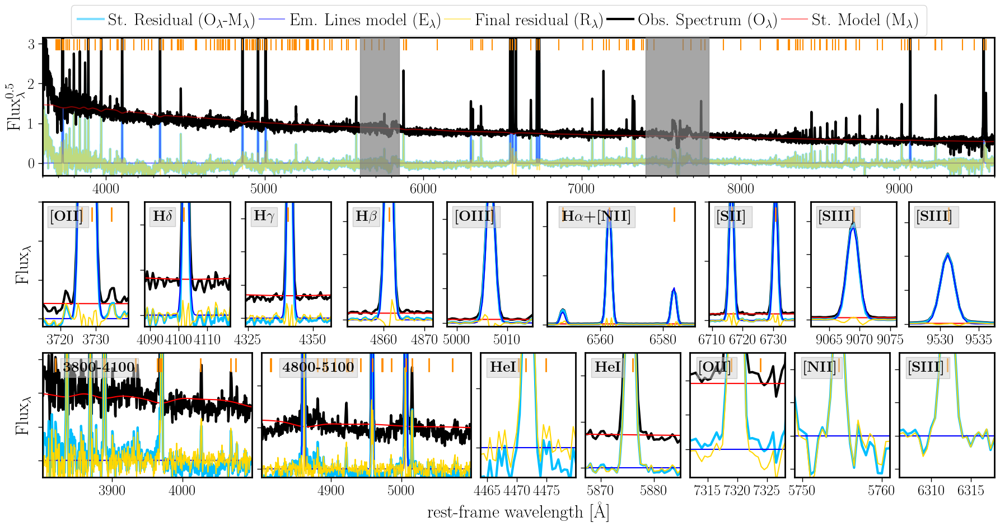

In [103]:
y_off = -1.09
y_off2 = -2.18
plot_spec_now(dir='orion',file='m_orion_all.output.fits',\
          file_ssp = 'orion/m_orion_all.rsp.txt',\
          name='6110',text='',c_map='CMRmap',output='figs/m_all_s-ORION.png',\
              insets=((0.00, y_off, 0.09, 0.9,3715,3739,-1,15,'[OII]'),\
                          (0.107, y_off, 0.09, 0.9,4088,4118,-0.5,5,r'H$\delta$'),\
                          (0.213, y_off, 0.09, 0.9,4324,4357,-0.5,7,r'H$\gamma$'),\
                          (0.320, y_off, 0.09, 0.9,4851,4872,-1.0,18,r'H$\beta$'),\
                          (0.425, y_off, 0.09, 0.9,4998,5015,-1.0,35,'[OIII]'),\
                          (0.530, y_off, 0.155, 0.9,6543,6590,-2,125,r'H$\alpha$+[NII]'),\
                          (0.700, y_off, 0.09, 0.9,6709,6737,-0.5,10,'[SII]'),\
                          (0.807, y_off, 0.09, 0.9,9062,9076,-1.0,18,'[SIII]'),\
                          (0.910, y_off, 0.09, 0.9,9526,9537,-1.5,72,'[SIII]'),\
                      (0.00, y_off2, 0.22, 0.9,3801,4099,-0.5,3.2,'3800-4100'),\
                      (0.23, y_off2, 0.22, 0.9,4801,5099,-0.2,2.8,'4800-5100'),\
                      (0.46, y_off2, 0.10, 0.9,4472-8.1,4472+7.9,-0.25,0.8,'HeI'),\
                      (0.57, y_off2, 0.10, 0.9,5876-9,5876+9,-0.2,2.5,'HeI'),\
                      (0.68, y_off2, 0.10, 0.9,7320-8,7320+8,-0.2,0.7,'[OII]'),\
                      (0.79, y_off2, 0.10, 0.9,5755-6,5755+6,-0.25,0.5,'[NII]'),\
                      (0.90, y_off2, 0.10, 0.9,6312-6,6312+6,-0.25,0.5,'[SIII]')
                     ),
                          y_min=-0.1,y_max=10,y0_d=0.3,y1_d=2.9,\
              x_min=3600,x_max=9600,plot_el=True, tab_el=tab_el,plot_res=True,show_scale=False,n_ord=0,gamma=0.5)#,x_min=3600,x_max=9600)
# (0.55, 0.5, 0.2, 0.47,6303,6325,0.85,1.7)

# S/N: 1.4621611045184144 254.4288787841797 174.00878603454564
# mean_val_ssp : 0.6481705250543778


/tmp/ipykernel_112978/4094484561.py:5: RuntimeWarning: invalid value encountered in divide
  return (flux/np.abs(flux))*(np.abs(flux))**gamma
/tmp/ipykernel_112978/3194250560.py:220: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


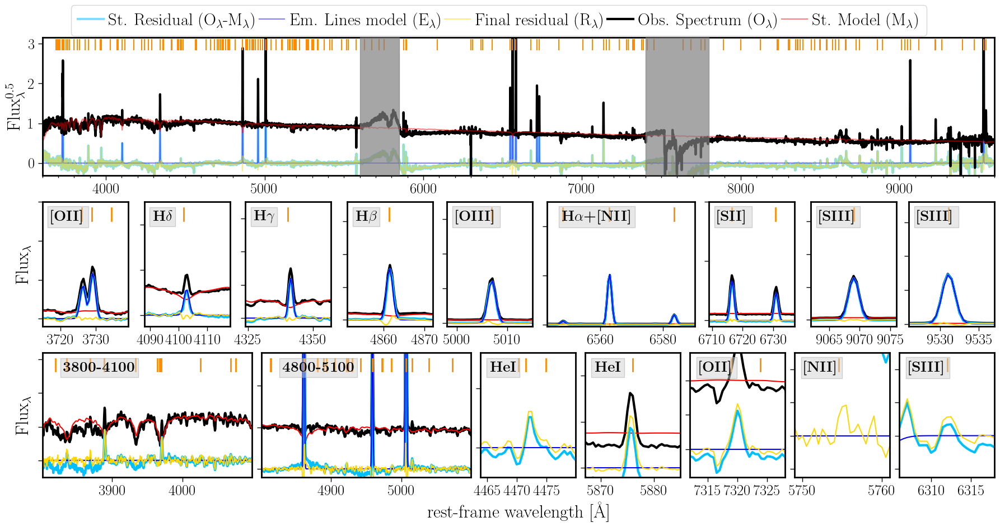

In [244]:
y_off = -1.09
y_off2 = -2.18
plot_spec_now(dir='output_dap',file='m_dap-rs36-SF-00006110.output.fits',\
          file_ssp = 'output_dap/m_CF-00006110.rsp.txt',\
          name='6110',text='',c_map='CMRmap',output='figs/nRT_spec_6110.png',\
              insets=((0.00, y_off, 0.09, 0.9,3715,3739,-1,15,'[OII]'),\
                          (0.107, y_off, 0.09, 0.9,4088,4118,-0.5,5,r'H$\delta$'),\
                          (0.213, y_off, 0.09, 0.9,4324,4357,-0.5,7,r'H$\gamma$'),\
                          (0.320, y_off, 0.09, 0.9,4851,4872,-1.0,18,r'H$\beta$'),\
                          (0.425, y_off, 0.09, 0.9,4998,5015,-1.0,35,'[OIII]'),\
                          (0.530, y_off, 0.155, 0.9,6543,6590,-2,125,r'H$\alpha$+[NII]'),\
                          (0.700, y_off, 0.09, 0.9,6709,6737,-0.5,10,'[SII]'),\
                          (0.807, y_off, 0.09, 0.9,9062,9076,-1.0,18,'[SIII]'),\
                          (0.910, y_off, 0.09, 0.9,9526,9537,-1.5,72,'[SIII]'),\
                      (0.00, y_off2, 0.22, 0.9,3801,4099,-0.5,3.2,'3800-4100'),\
                      (0.23, y_off2, 0.22, 0.9,4801,5099,-0.2,2.8,'4800-5100'),\
                      (0.46, y_off2, 0.10, 0.9,4472-8.1,4472+7.9,-0.25,0.8,'HeI'),\
                      (0.57, y_off2, 0.10, 0.9,5876-9,5876+9,-0.2,2.5,'HeI'),\
                      (0.68, y_off2, 0.10, 0.9,7320-8,7320+8,-0.2,0.7,'[OII]'),\
                      (0.79, y_off2, 0.10, 0.9,5755-6,5755+6,-0.25,0.5,'[NII]'),\
                      (0.90, y_off2, 0.10, 0.9,6312-6,6312+6,-0.25,0.5,'[SIII]')
                     ),
                          y_min=-0.1,y_max=10,y0_d=0.3,y1_d=2.9,\
              x_min=3600,x_max=9600,plot_el=True, tab_el=tab_el,plot_res=True,show_scale=False,n_ord=0,gamma=0.5)#,x_min=3600,x_max=9600)
# (0.55, 0.5, 0.2, 0.47,6303,6325,0.85,1.7)

# S/N: 1.599106259990072 4.668102028768051e+16 2.9191943934964228e+16
# mean_val_ssp : 8.594254060629644e-19


/tmp/ipykernel_112978/3194250560.py:220: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


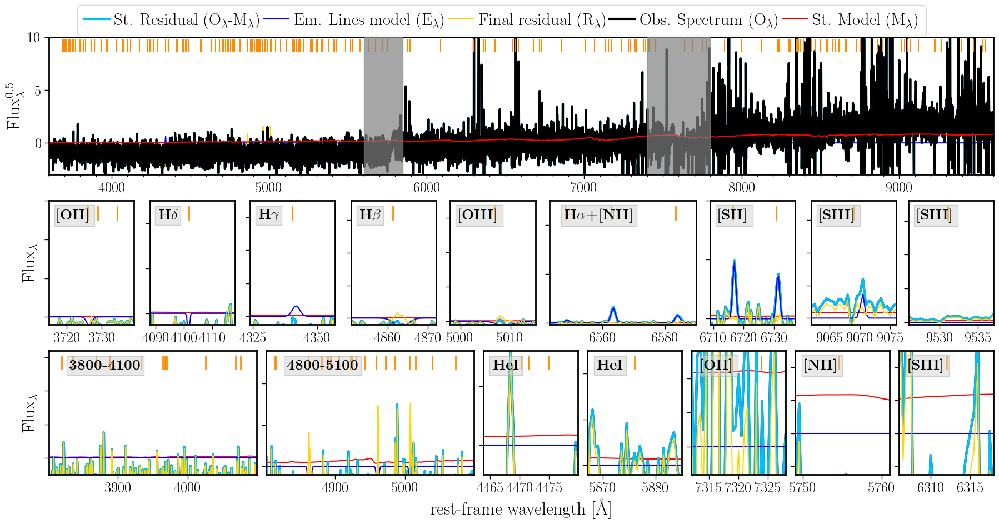

In [247]:
y_off = -1.09
y_off2 = -2.18
# output_dap_v1.0.3_atl/m_dap-rsp108-sn20-00003469.output.fits

plot_spec_now(dir='output_dap_v1.0.3_atl',file='m_dap-rsp108-sn20-00003723.output.fits',\
          file_ssp = 'output_dap/m_CF-00006110.rsp.txt',\
          name='6110',text='',c_map='CMRmap',output='figs/nRT_spec_00003723.png',\
              insets=((0.00, y_off, 0.09, 0.9,3715,3739,-1,15,'[OII]'),\
                          (0.107, y_off, 0.09, 0.9,4088,4118,-0.5,5,r'H$\delta$'),\
                          (0.213, y_off, 0.09, 0.9,4324,4357,-0.5,7,r'H$\gamma$'),\
                          (0.320, y_off, 0.09, 0.9,4851,4872,-1.0,18,r'H$\beta$'),\
                          (0.425, y_off, 0.09, 0.9,4998,5015,-1.0,35,'[OIII]'),\
                          (0.530, y_off, 0.155, 0.9,6543,6590,-2,125,r'H$\alpha$+[NII]'),\
                          (0.700, y_off, 0.09, 0.9,6709,6737,-0.5,10,'[SII]'),\
                          (0.807, y_off, 0.09, 0.9,9062,9076,-1.0,18,'[SIII]'),\
                          (0.910, y_off, 0.09, 0.9,9526,9537,-1.5,72,'[SIII]'),\
                      (0.00, y_off2, 0.22, 0.9,3801,4099,-0.5,3.2,'3800-4100'),\
                      (0.23, y_off2, 0.22, 0.9,4801,5099,-0.2,2.8,'4800-5100'),\
                      (0.46, y_off2, 0.10, 0.9,4472-8.1,4472+7.9,-0.25,0.8,'HeI'),\
                      (0.57, y_off2, 0.10, 0.9,5876-9,5876+9,-0.2,2.5,'HeI'),\
                      (0.68, y_off2, 0.10, 0.9,7320-8,7320+8,-0.2,0.7,'[OII]'),\
                      (0.79, y_off2, 0.10, 0.9,5755-6,5755+6,-0.25,0.5,'[NII]'),\
                      (0.90, y_off2, 0.10, 0.9,6312-6,6312+6,-0.25,0.5,'[SIII]')
                     ),
                          y_min=-3,y_max=10,y0_d=0.3,y1_d=2.9,\
              x_min=3600,x_max=9600,plot_el=True, tab_el=tab_el,plot_res=True,show_scale=False,n_ord=0,gamma=1.0,alpha=1.0)#,x_min=3600,x_max=9600)
# (0.55, 0.5, 0.2, 0.47,6303,6325,0.85,1.7)

# S/N: 0.5874768497632726 129.2806625366211 220.06086297479726
# mean_val_ssp : 0.6517568318754879


/tmp/ipykernel_112978/4094484561.py:5: RuntimeWarning: invalid value encountered in divide
  return (flux/np.abs(flux))*(np.abs(flux))**gamma
/tmp/ipykernel_112978/3194250560.py:220: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


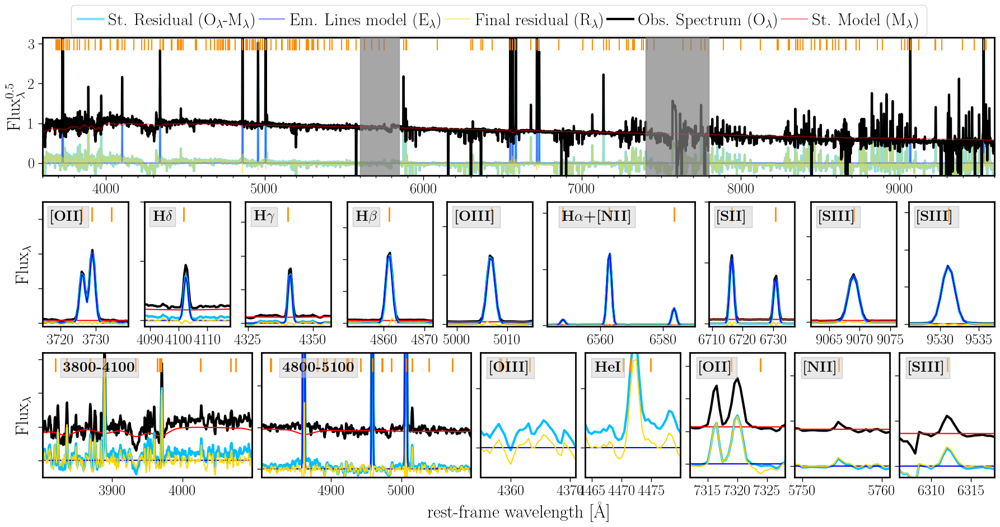

In [241]:
### y_off = -1.09
y_off2 = -2.18
plot_spec_now(dir='output_dap_v1.0',file='m_dap-rsp108-sn20-00006109.output.fits',\
          file_ssp = 'output_dap/m_CF-00006110.rsp.txt',\
          name='6110',text='',c_map='CMRmap',output='figs/v1-00006109.png',\
              insets=((0.00, y_off, 0.09, 0.9,3715,3739,-1,35,'[OII]'),\
                          (0.107, y_off, 0.09, 0.9,4088,4118,-0.5,10,r'H$\delta$'),\
                          (0.213, y_off, 0.09, 0.9,4324,4357,-0.5,18,r'H$\gamma$'),\
                          (0.320, y_off, 0.09, 0.9,4851,4872,-1.0,38,r'H$\beta$'),\
                          (0.425, y_off, 0.09, 0.9,4998,5015,-1.0,50,'[OIII]'),\
                          (0.530, y_off, 0.155, 0.9,6543,6590,-2,220,r'H$\alpha$+[NII]'),\
                          (0.700, y_off, 0.09, 0.9,6709,6737,-0.5,20,'[SII]'),\
                          (0.807, y_off, 0.09, 0.9,9062,9076,-1.0,28,'[SIII]'),\
                          (0.910, y_off, 0.09, 0.9,9526,9537,-1.5,82,'[SIII]'),\
                      (0.00, y_off2, 0.22, 0.9,3801,4099,-0.5,3.2,'3800-4100'),\
                      (0.23, y_off2, 0.22, 0.9,4801,5099,-0.2,2.8,'4800-5100'),\
                      (0.46, y_off2, 0.10, 0.9,4363-8.1,4363+7.9,-0.25,0.8,'[OIII]'),\
                      (0.57, y_off2, 0.10, 0.9,4472-8.1,4472+7.9,-0.25,0.8,'HeI'),\
                      (0.68, y_off2, 0.10, 0.9,7320-8,7320+8,-0.2,1.7,'[OII]'),\
                      (0.79, y_off2, 0.10, 0.9,5755-6,5755+6,-0.25,2.5,'[NII]'),\
                      (0.90, y_off2, 0.10, 0.9,6312-6,6312+6,-0.25,2.5,'[SIII]')
                     ),
                          y_min=-0.1,y_max=10,y0_d=0.3,y1_d=2.9,\
              x_min=3600,x_max=9600,plot_el=True, tab_el=tab_el,plot_res=True,show_scale=False,n_ord=3,gamma=0.5)#,x_min=3600,x_max=9600)
# (0.55, 0.5, 0.2, 0.47,6303,6325,0.85,1.7)

# S/N: 3.53931456032965 11.687006059894031 3.302053508011876
# mean_val_ssp : -0.003472225533300508


/tmp/ipykernel_112978/3194250560.py:220: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


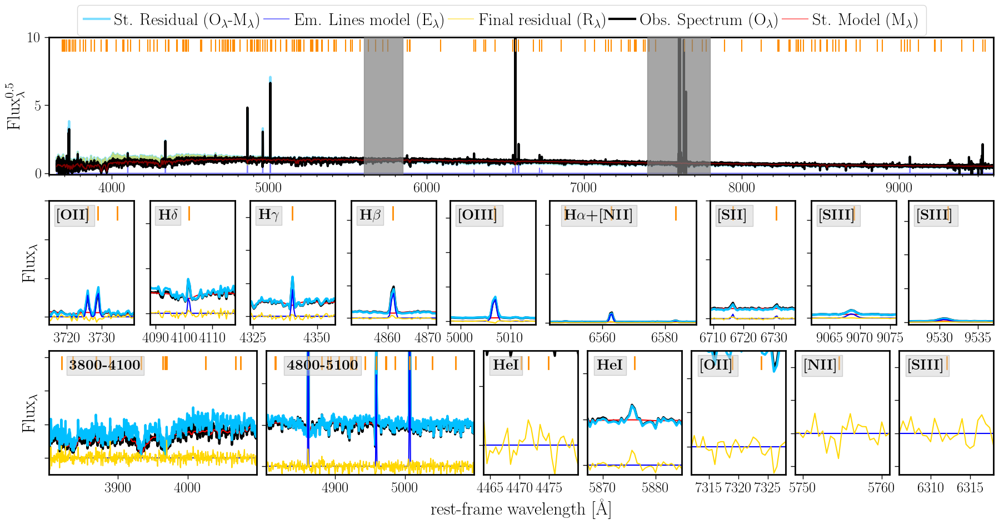

In [243]:
y_off = -1.09
y_off2 = -2.18
DIR='/disk-a/sanchez/LVM/LVM/ver_231113/output_sim/'
label='Scene1'

plot_spec_now(dir=DIR,file=f'm_{label}.output.fits',\
          file_ssp = 'output_dap/m_CF-00006110.rsp.txt',\
          name='6110',text='',c_map='CMRmap',output=f'figs/m_fit_{label}.pdf',\
              insets=((0.00, y_off, 0.09, 0.9,3715,3739,-1,15,'[OII]'),\
                          (0.107, y_off, 0.09, 0.9,4088,4118,-0.5,5,r'H$\delta$'),\
                          (0.213, y_off, 0.09, 0.9,4324,4357,-0.5,7,r'H$\gamma$'),\
                          (0.320, y_off, 0.09, 0.9,4851,4872,-1.0,18,r'H$\beta$'),\
                          (0.425, y_off, 0.09, 0.9,4998,5015,-1.0,35,'[OIII]'),\
                          (0.530, y_off, 0.155, 0.9,6543,6590,-2,125,r'H$\alpha$+[NII]'),\
                          (0.700, y_off, 0.09, 0.9,6709,6737,-0.5,10,'[SII]'),\
                          (0.807, y_off, 0.09, 0.9,9062,9076,-1.0,18,'[SIII]'),\
                          (0.910, y_off, 0.09, 0.9,9526,9537,-1.5,72,'[SIII]'),\
                      (0.00, y_off2, 0.22, 0.9,3801,4099,-0.5,3.2,'3800-4100'),\
                      (0.23, y_off2, 0.22, 0.9,4801,5099,-0.2,2.8,'4800-5100'),\
                      (0.46, y_off2, 0.10, 0.9,4472-8.1,4472+7.9,-0.25,0.8,'HeI'),\
                      (0.57, y_off2, 0.10, 0.9,5876-9,5876+9,-0.2,2.5,'HeI'),\
                      (0.68, y_off2, 0.10, 0.9,7320-8,7320+8,-0.2,0.7,'[OII]'),\
                      (0.79, y_off2, 0.10, 0.9,5755-6,5755+6,-0.25,0.5,'[NII]'),\
                      (0.90, y_off2, 0.10, 0.9,6312-6,6312+6,-0.25,0.5,'[SIII]')
                     ),
                          y_min=-0.1,y_max=10,y0_d=0.3,y1_d=2.9,\
              x_min=3600,x_max=9600,plot_el=True, tab_el=tab_el,plot_res=True,show_scale=False,n_ord=0,gamma=1.0)#,x_min=3600,x_max=9600)
# (0.55, 0.5, 0.2, 0.47,6303,6325,0.85,1.7)

/tmp/ipykernel_354939/3834567443.py:92: RuntimeWarning: invalid value encountered in power
  ax0.plot(wave,data[0,:]**gamma,color=colors[0],alpha=1.0,linewidth=3.0,label=r'Obs. Spectrum (O$_\lambda$)')
/tmp/ipykernel_354939/3834567443.py:99: RuntimeWarning: invalid value encountered in power
  ax0.plot(wave,(data[0,:]+smooth)**gamma-data[1,:]**gamma,color=colors[2],alpha=1.0,\
/tmp/ipykernel_354939/3834567443.py:106: RuntimeWarning: invalid value encountered in power
  ax0.plot(wave,(data[0,:]+smooth)**gamma-data[1,:]**gamma-(data[2,:]**gamma-data[1,:]**gamma),color=colors[4],alpha=1.0,linewidth=1.5,\
/tmp/ipykernel_354939/3834567443.py:196: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


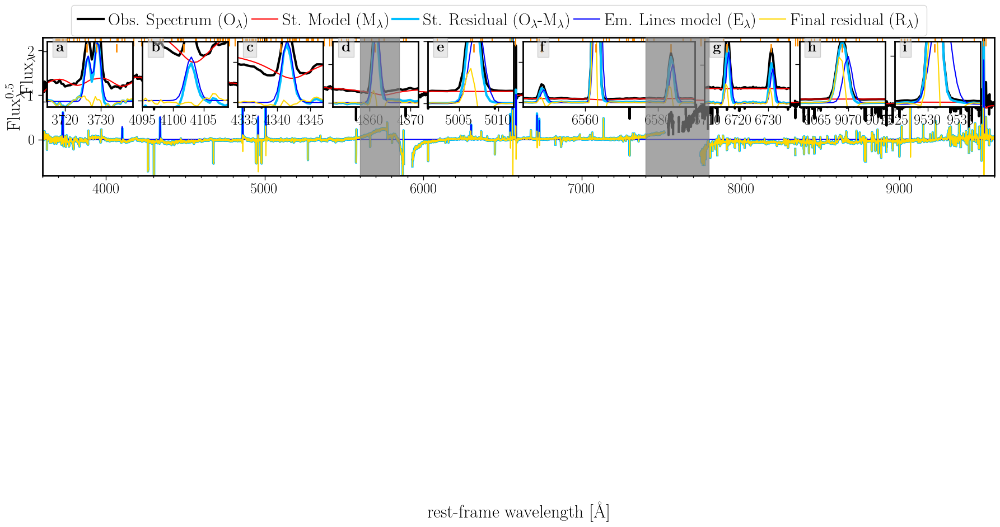

In [420]:
plot_spec_now(dir='output_dap',file='m_dap-sec-SF-00006110-2.output.fits',\
          file_ssp = 'output_dap/m_CF-00006110.rsp.txt',\
          name='6110',text='',c_map='CMRmap',output='figs/nRT_spec_6110-2.png',\
              insets=((0.005, 0.5, 0.09, 0.47,3715,3739,-0.5,6,'a'),\
                          (0.105, 0.5, 0.09, 0.47,4095,4109,-0.2,2,'b'),\
                          (0.205, 0.5, 0.09, 0.47,4334,4347,-0.2,3,'c'),\
                          (0.305, 0.5, 0.09, 0.47,4851,4872,-0.5,8,'d'),\
                          (0.405, 0.5, 0.09, 0.47,5001,5012,-0.5,10,'e'),\
                          (0.505, 0.5, 0.18, 0.47,6543,6590,-1,15,'f'),\
                          (0.695, 0.5, 0.09, 0.47,6709,6737,-0.2,4,'g'),\
                          (0.795, 0.5, 0.09, 0.47,9062,9076,-0.5,8,'h'),\
                          (0.895, 0.5, 0.09, 0.47,9525,9538,-0.5,13,'i')),
                          y_min=-0.5,y_max=16,y0_d=0.3,y1_d=2.9,\
              x_min=3600,x_max=9600,plot_el=True, tab_el=tab_el,plot_res=True,show_scale=False,n_ord=1)#,x_min=3600,x_max=9600)
# (0.55, 0.5, 0.2, 0.47,6303,6325,0.85,1.7)

/tmp/ipykernel_354939/580899657.py:1451: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


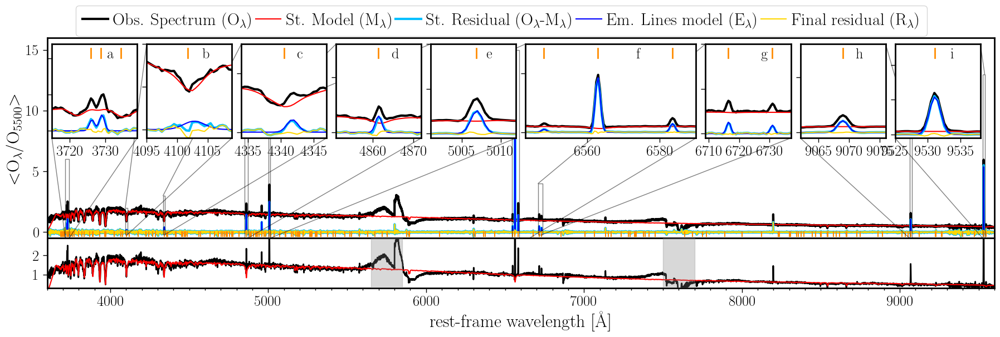

In [38]:
plot_spec(dir='output_dap',file='m_dap-sec-SF-00006110.output.fits',\
          file_ssp = 'output_dap/m_CF-00006110.rsp.txt',\
          name='6110',text='',c_map='CMRmap',output='figs/nRT_spec_6110.png',\
              insets=((0.005, 0.5, 0.09, 0.47,3715,3739,-0.5,6,'a'),\
                          (0.105, 0.5, 0.09, 0.47,4095,4109,-0.2,2,'b'),\
                          (0.205, 0.5, 0.09, 0.47,4334,4347,-0.2,3,'c'),\
                          (0.305, 0.5, 0.09, 0.47,4851,4872,-0.5,8,'d'),\
                          (0.405, 0.5, 0.09, 0.47,5001,5012,-0.5,10,'e'),\
                          (0.505, 0.5, 0.18, 0.47,6543,6590,-1,15,'f'),\
                          (0.695, 0.5, 0.09, 0.47,6709,6737,-0.2,4,'g'),\
                          (0.795, 0.5, 0.09, 0.47,9062,9076,-0.5,8,'h'),\
                          (0.895, 0.5, 0.09, 0.47,9525,9538,-0.5,13,'i')),
                          y_min=-0.5,y_max=16,y0_d=0.3,y1_d=2.9,\
              x_min=3600,x_max=9600,plot_el=True, tab_el=tab_el,plot_res=True,show_scale=False,n_ord=5)#,x_min=3600,x_max=9600)
# (0.55, 0.5, 0.2, 0.47,6303,6325,0.85,1.7)

/tmp/ipykernel_354939/580899657.py:1451: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


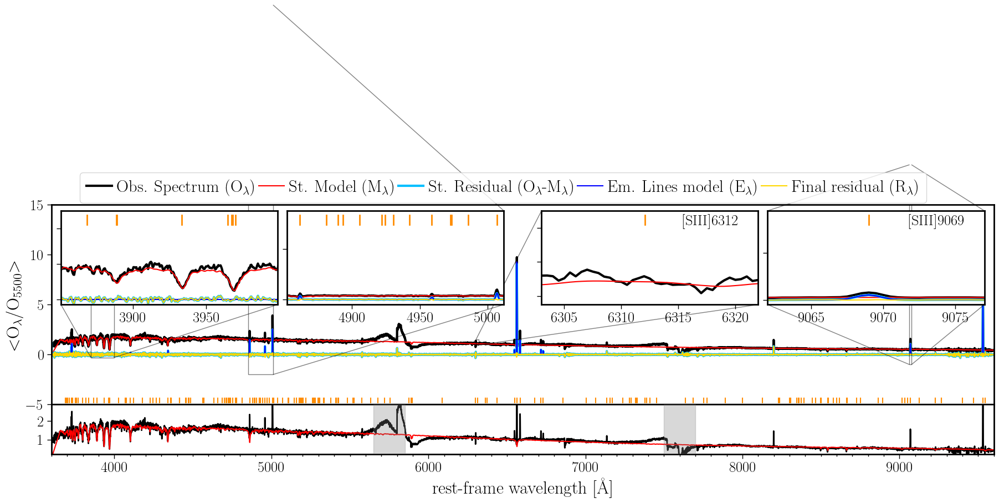

In [39]:
plot_spec(dir='output_dap',file='m_dap-sec-SF-00006110.output.fits',\
          file_ssp = 'output_dap/m_CF-00006110.rsp.txt',\
          name='6110',text='',c_map='CMRmap',output='figs/nRT_spec_6110.png',\
              insets=((0.25, 0.5, 0.23, 0.47,4852,5012,-2,35,''),\
                      (0.01, 0.5, 0.23, 0.47,3851,3999,-0.3,5,''),\
                      (0.52, 0.5, 0.23, 0.47,6303,6322,0.95,1.5,'[SIII]6312'),\
                      (0.76, 0.5, 0.23, 0.47,9062,9077,-1,19,'[SIII]9069')),\
              y_min=-5,y_max=15,y0_d=0.2,y1_d=2.9,\
              x_min=3600,x_max=9600,plot_el=True, tab_el=tab_el,plot_res=True,show_scale=False,n_ord=5)#,x_min=3600,x_max=9600)
# (0.55, 0.5, 0.2, 0.47,6303,6325,0.85,1.7)

/home/sanchez/.local/lib/python3.11/site-packages/lvmdap/dap_tools.py:1524: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


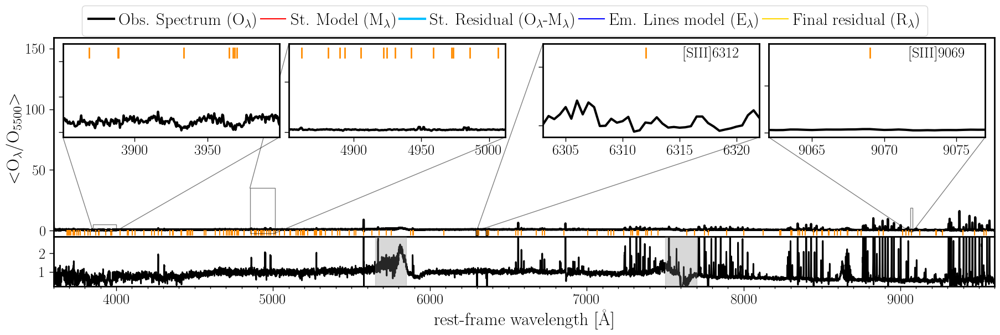

In [17]:
plot_spec(dir='output_dap',file='m_dap-sec-SF-00006110-1.output.fits',\
          file_ssp = 'output_dap/m_CF-00006110.rsp.txt',\
          name='6110',text='',c_map='CMRmap',output='figs/nRT_spec_6110.png',\
              insets=((0.25, 0.5, 0.23, 0.47,4852,5012,-2,35,''),\
                      (0.01, 0.5, 0.23, 0.47,3851,3999,-0.3,5,''),\
                      (0.52, 0.5, 0.23, 0.47,6303,6322,0.9,1.7,'[SIII]6312'),\
                      (0.76, 0.5, 0.23, 0.47,9062,9077,-1,19,'[SIII]9069')),\
              y_min=-5,y_max=159,y0_d=0.2,y1_d=2.9,\
              x_min=3600,x_max=9600,plot_el=True, tab_el=tab_el,plot_res=True,show_scale=False,n_ord=1)#,x_min=3600,x_max=9600)
# (0.55, 0.5, 0.2, 0.47,6303,6325,0.85,1.7)

/home/sanchez/.local/lib/python3.11/site-packages/lvmdap/dap_tools.py:1524: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


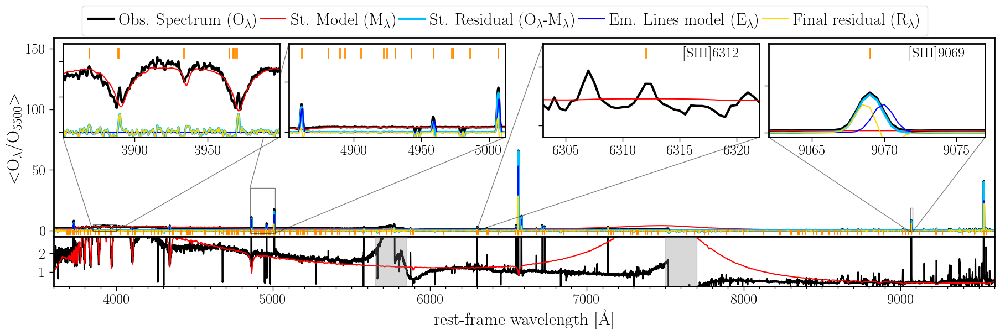

In [28]:
plot_spec(dir='output_dap',file='m_dap-sec-SF-00006110-2.output.fits',\
          file_ssp = 'output_dap/m_CF-00006110.rsp.txt',\
          name='6110',text='',c_map='CMRmap',output='figs/nRT_spec_6110.png',\
              insets=((0.25, 0.5, 0.23, 0.47,4852,5012,-2,35,''),\
                      (0.01, 0.5, 0.23, 0.47,3851,3999,-0.3,5,''),\
                      (0.52, 0.5, 0.23, 0.47,6303,6322,0.9,1.7,'[SIII]6312'),\
                      (0.76, 0.5, 0.23, 0.47,9062,9077,-1,19,'[SIII]9069')),\
              y_min=-5,y_max=159,y0_d=0.2,y1_d=2.9,\
              x_min=3600,x_max=9600,plot_el=True, tab_el=tab_el,plot_res=True,show_scale=False,n_ord=5)#,x_min=3600,x_max=9600)
# (0.55, 0.5, 0.2, 0.47,6303,6325,0.85,1.7)

In [ ]:
plot_spec(dir='output_dap',file='m_dap-sec-SF-00006110-2.output.fits',\
          file_ssp = 'output_dap/m_CF-00006110.rsp.txt',\
          name='6110',text='',c_map='CMRmap',output='figs/nRT_spec_6110.png',\
              insets=((0.25, 0.5, 0.23, 0.47,4852,5012,-2,35,''),\
                      (0.01, 0.5, 0.23, 0.47,3851,3999,-0.3,5,''),\
                      (0.52, 0.5, 0.23, 0.47,6303,6322,0.9,1.7,'[SIII]6312'),\
                      (0.76, 0.5, 0.23, 0.47,9062,9077,-1,19,'[SIII]9069')),\
              y_min=-5,y_max=159,y0_d=0.2,y1_d=2.9,\
              x_min=3600,x_max=9600,plot_el=True, tab_el=tab_el,plot_res=True,show_scale=False,n_ord=5)#,x_min=3600,x_max=9600)
# (0.55, 0.5, 0.2, 0.47,6303,6325,0.85,1.7)

/home/sanchez/.local/lib/python3.11/site-packages/lvmdap/dap_tools.py:1524: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


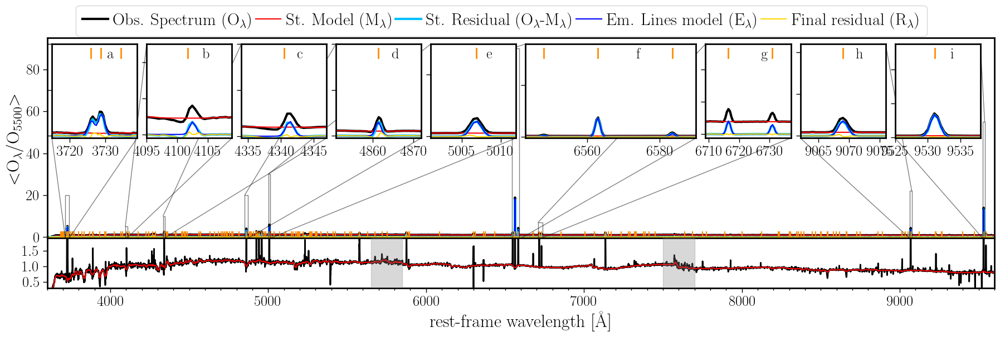

In [86]:
DIR='/disk-a/sanchez/LVM/LVM/ver_231113/output_sim/'

#DIR='/disk-a/sanchez/LVM/LVM/ver_231113/output_dap/'
label='00006109_cl_SN1_342_20_5_20.0'


out_file_fit=f'{DIR}/m_{label}.output.fits'
out_file_ps=f'{DIR}/m_{label}.rsp.txt'
output_path='figs/'
outfile=f'm_fit_{label}.pdf'
tab_el=read_tab_EL('_legacy/emission_lines_long_list.LVM')
plot_spec(dir='',file=out_file_fit,\
            file_ssp = out_file_ps,\
                  name=None,text=None,output=f'{output_path}/{outfile}',\
                  insets=((0.005, 0.5, 0.09, 0.47,3715,3739,-0.5,20,'a'),\
                          (0.105, 0.5, 0.09, 0.47,4095,4109,-0.2,5,'b'),\
                          (0.205, 0.5, 0.09, 0.47,4334,4347,-0.2,10,'c'),\
                          (0.305, 0.5, 0.09, 0.47,4851,4872,-0.5,20,'d'),\
                          (0.405, 0.5, 0.09, 0.47,5001,5012,-0.5,30,'e'),\
                          (0.505, 0.5, 0.18, 0.47,6543,6590,-1,90,'f'),\
                          (0.695, 0.5, 0.09, 0.47,6709,6737,-0.3,7,'g'),\
                          (0.795, 0.5, 0.09, 0.47,9062,9076,-0.5,22,'h'),\
                          (0.895, 0.5, 0.09, 0.47,9525,9538,-0.5,55,'i')),
                          y_min=-0.5,y_max=95,y0_d=0.3,y1_d=1.9,\
              x_min=3600,x_max=9600,plot_el=True, tab_el=tab_el,\
              colors_in=['black','red','deepskyblue','blue','gold','forestgreen'],\
         plot_res=True)

(-1.0, 2.0)

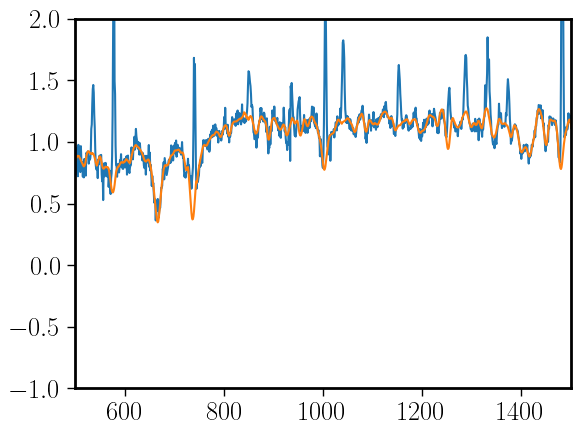

In [22]:
#file = 00006109_cl_SN1_342_5_5_20.0
#file = '/disk-a/sanchez/LVM/LVM/ver_231113/output_sim/m_00006109_cl_SN1_342_5_5_20.0.output.fits'
file = '/disk-a/sanchez/LVM/LVM/ver_231113/output_dap_v1.0.3_tests/m_junk-sim-00006109_5_5_20.0_5.0.output.fits'
hdu=fits.open(file)
wave = hdu[0].header['CRVAL1']+hdu[0].header['CDELT1']*np.arange(hdu[0].data.shape[1])
data=hdu[0].data
gas = data[0,:] - data[5,:]
smooth = data[3,:] - data[4,:] - gas        
ssp_model = data[1,:]-smooth
n_ord=3
if (n_ord>2):
    f_rat = ssp_model/data[0,:]
    c_rat0 = np.polyfit(wave, f_rat, n_ord)
    p_rat0 = np.poly1d(c_rat0)(wave)
    ssp_model = ssp_model*(1+1/p_rat0)*0.5
    ssp_model2 = ssp_model/p_rat0




#for I,spec in enumerate(hdu[0].data):
#    plt.plot(spec,alpha=0.3)
#    print(I)
plt.plot(hdu[0].data[0,:]/np.abs(np.nanmedian(hdu[0].data[0,300:1200])))
plt.plot(hdu[0].data[1,:]/np.abs(np.nanmedian(hdu[0].data[0,300:1200])))

data=hdu[0].data
gas = data[0,:] - data[5,:]
smooth = data[3,:] - data[4,:] - gas        
ssp_model = data[1,:]-smooth

#plt.plot(ssp_model/np.abs(np.nanmedian(hdu[0].data[0,300:1200])))

#plt.plot(hdu[0].data[6,:]/np.abs(np.nanmedian(hdu[0].data[0,300:1200])))
#plt.plot(ssp_model2,linewidth=3)
#plt.plot((hdu[0].data[0,:]-smooth)/p_rat0)
#plt.plot(p_rat0)
#plt.ylim(-100,500)
plt.xlim(500,1500)

plt.ylim(-1,2)
#plt.plot(hdu[0].data[1,:]-hdu[0].data[4,:])
#plt.plot(hdu[0].data[5,:]-hdu[0].data[4,:])
#hdu[0].header


In [23]:
#
# routine to plot the spectra
#
def plot_spec(dir='output/',file='output.m_lvmSCFrame-00006109.fits.gz',\
              name='none',cmap=None,\
              x_min=3600,x_max=9600,y_min=-0.2,y_max=2,text='',\
              file_ssp = 'output/m_lvmSCFrame-00006109',no_st=False,no_model=False,log=False,\
              id_lines=None,output='junk.pdf',c_map='carlos',do_legend=True, insets=None,y0_d=0.5,y1_d=2.5,plot_el=False,tab_el=None,
              colors_in=['black','red-smooth','deepskyblue','blue','gold','forestgreen'],plot_res=False,show_scale=True,n_ord=11):

    tab_SSP=read_rsp(file_ssp)
    
    if (cmap==None):
        color_cm_now = vel_map_CLC()
        cmap=color_cm_now
    file=dir+'/'+file
    hdu=fits.open(file)
    data=hdu[0].data
    (ny,nx)=data.shape
    
    
#    data=np.mean(data,axis=1)
    i0 = int(nx*0.45)
    i1 = int(nx*0.55)
    hdr=hdu[0].header
    crval = hdr['crval1']
    cdelt = hdr['cdelt1']
    crpix = hdr['crpix1']
    #print(data.shape)
    (ny,nx) = data.shape
    wave = crval+cdelt*(np.arange(0,nx)-(crpix-1))
    
    data = data / np.median(data[0,i0:i1])
    if (ny==7):
        ssp_model=data[6,:]
    else:
        gas = data[0,:] - data[5,:]
        smooth = data[3,:] - data[4,:] - gas        
        ssp_model = data[1,:]-smooth
        if (n_ord>2):
            try:
                f_rat = ssp_model/data[0,:]
                c_rat0 = np.polyfit(wave, f_rat, n_ord)
                p_rat0 = np.poly1d(c_rat0)(wave)
                ssp_model = ssp_model*(1+1/p_rat0)*0.5
                data[0,:]=(data[0,:]-smooth)*(1+1/p_rat0)*0.5
            except:
                show_scale=False
        if (show_scale==True):
            ssp_model = data[1,:]


    fig = plt.figure(figsize=(19,6)) 
    gs = fig.add_gridspec(nrows=5, ncols=6,  left=0.075, right=0.97, \
                          hspace=0.0, wspace=0.05, bottom=0.15, top=0.9)
    ax0 = fig.add_subplot(gs[:-1, :])
    ax1 = fig.add_subplot(gs[-1:, :], sharex=ax0)   
    ax0.set_xlim(x_min,x_max)
    ax1.set_xlim(x_min,x_max)
    ax0.set_ylim(y_min,y_max)        

        
 #   colors=['black','maroon','steelblue','darkorange','olive','grey']
#    colors=['black','palegreen','steelblue','darkorange','olive','grey']
#    colors=['black','lightsalmon','steelblue','darkorange','olive','grey']
    colors=colors_in
    if (no_st==False):
        ax0.plot(wave,data[0,:],color=colors[0],alpha=1.0,linewidth=3.0,label=r'Obs. Spectrum (O$_\lambda$)')
        ax1.plot(wave,data[0,:],color=colors[0],alpha=1.0,linewidth=2.0)#,label=r'Observed (O$_\lambda$)')
        if (no_model==False):
            ax0.plot(wave,ssp_model,color=colors[1],alpha=1.0,linewidth=1.5,label=r'St. Model (M$_\lambda$)',linestyle="solid")
            ax1.plot(wave,ssp_model,color=colors[1],alpha=1.0,linewidth=1.5,linestyle="solid")#,label=r'Model (M$_\lambda$)')
    res = data[0,:]-data[1,:]+smooth
    gas_model = data[2,:]-data[1,:]
    ax0.plot(wave,res,color=colors[2],alpha=1.0,\
             label=r'St. Residual (O$_\lambda$-M$_\lambda$)',linewidth=3)
    if (no_model==False):
        ax0.plot(wave,gas_model,color=colors[3],alpha=1.0,linewidth=1.5,\
                 label=r'Em. Lines model (E$_\lambda$)',linestyle="solid")
    if (plot_res==True):
        ax0.plot(wave,data[4,:],color=colors[4],alpha=1.0,linewidth=1.5,\
                 label=r'Final residual (R$_\lambda$)',linestyle="solid")
    
    std_res = np.std(res[2000:2500])
    flux = np.median(data[1,2000:2500])
    ax1.axvspan(5650, 5850, alpha=0.3, color='grey',zorder=10)
    ax1.axvspan(7500, 7700, alpha=0.3, color='grey',zorder=10)
    

    ax0.xaxis.set_minor_locator(MultipleLocator(100))
    #ax0.axes.get_xaxis().set_visible(False)
    handles, labels = ax0.get_legend_handles_labels()
    if (do_legend):
        ax0.legend(handles, labels,loc=(0.03,1.01),frameon=True,handlelength=1.5,\
                   ncol=5,columnspacing=0.15, prop={'size': 22})
    x = np.arange(x_min,1.1*x_max,100)
    y1 = 5+0*x
    y0 = -5+0*x

    if (id_lines != None):
        #colors=['black','lightsalmon','steelblue','darkorange','olive','grey']
        #        colors=['black','palegreen','steelblue','darkorange','olive','grey']
        #colors=['darkred','firebrick','indianred']
        mask_lines = (id_lines['wl'].value>=x_min) & (id_lines['wl'].value<x_max)
        tab_elines = id_lines[mask_lines]
        even=0
        for line in tab_elines:
            ax0.text(line['wl'],y_max-0.16*(even+1)*(y_max-y_min),\
                     f"{line['wl']}",color=colors[even],\
                     fontsize='16',horizontalalignment='center',rotation='vertical')
            even=even+1
            if (even>2):
                even=0
        #print(tab_elines)
        
    if (insets != None):
        for inst in insets:
            #x1, x2, y1, y2 = -1.5, -0.9, -2.5, -1.9  # subregion of the original image
            axins = ax0.inset_axes(
                [inst[0], inst[1], inst[2], inst[3]],
                xlim=(inst[4], inst[5]), ylim=(inst[6], inst[7]),yticklabels=[])#, xticklabels=[], yticklabels=[])
            if (no_st==False):
                axins.plot(wave,data[0,:],color=colors[0],alpha=1.0,linewidth=3,label=r'Observed (O$_\lambda$)')
            if (no_model==False):
                axins.plot(wave,ssp_model,color=colors[1],alpha=1.0,linewidth=1.5,label=r'Model (M$_\lambda$)',linestyle="solid")
            axins.plot(wave,res,color=colors[2],alpha=1.0,linewidth=3,\
                       label=r'Residual (O$_\lambda$-M$_\lambda$)')
            if (no_model==False):
                axins.plot(wave,gas_model,color=colors[3],alpha=1.0,linewidth=1.5,\
                           label=r'E. lines model',linestyle="solid")
            if (plot_res==True):
                axins.plot(wave,data[4,:],color=colors[4],alpha=1.0,linewidth=1.5,\
                           label=r'Em. lines model (E$_\lambda$)',linestyle="solid")
                
            if (plot_el == True):
                tab_el_now=tab_el[(tab_el['wl']>inst[4]) & (tab_el['wl']<inst[5])]
                for vals in tab_el_now:
                    axins.plot([vals['wl'],vals['wl']],\
                             [inst[7]-0.05*abs(inst[7]-inst[6]),\
                              inst[7]-0.15*abs(inst[7]-inst[6])],\
                             color='darkorange',linewidth=2)
                axins.text(inst[4]+0.65*np.abs(inst[5]-inst[4]),\
                           inst[7]-0.15*abs(inst[7]-inst[6]),f'{inst[8]}')#,\
                           #color='darkorange')
            ax0.indicate_inset_zoom(axins, edgecolor="black")

        
    ax0.set_ylabel(r'$<$O$_\lambda$/O$_{5500}$$>$', fontsize=23)
    ax0.text(x_min+0.05*(x_max-x_min),y_min+0.85*(y_max-y_min),text,fontsize=21)
    ax1.set_xlabel(r'rest-frame wavelength [\AA]', fontsize=23)
    ax1.set_ylim(y0_d,y1_d)
    if (plot_el == True):
        for vals in tab_el:
            ax0.plot([vals['wl'],vals['wl']],\
                     [y_min+0.01*abs(y_max-y_min),y_min+0.03*abs(y_max-y_min)],\
                     color='darkorange')
    if (log==True):
        ax0.set_yscale('log')
    plt.tight_layout()
    fig.savefig(output, transparent=False, facecolor='white', edgecolor='white')#.pdf")


/tmp/ipykernel_100787/3912389526.py:159: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


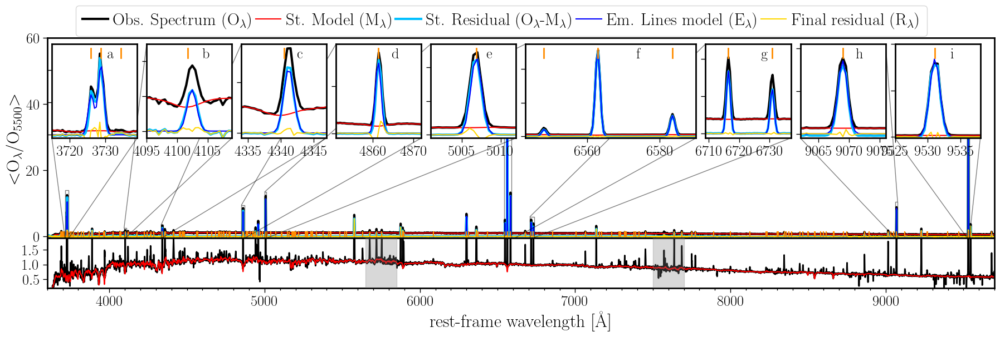

In [57]:
DIR='/disk-a/sanchez/LVM/LVM/ver_231113/output_dap_v1.0.3_tests/'

#DIR='/disk-a/sanchez/LVM/LVM/ver_231113/output_dap/'
label='00006109_cl_SN1_342_5_5_20.0'
#label='m_junk-sim-00006109_5_5_20.0_5.0'
#file = '/disk-a/sanchez/LVM/LVM/ver_231113/output_dap_v1.0.3_tests/m_junk-sim-00006109_5_5_20.0_5.0.output.fits'

out_file_fit=f'{DIR}/m_junk-sim-00006109_5_5_20.0_5.0.output.fits'
out_file_ps=f'output_sim/m_{label}.rsp.txt'
output_path='figs/'
outfile=f'm_fit_{label}.pdf'
tab_el=read_tab_EL('_legacy/emission_lines_long_list.LVM')
plot_spec(dir='',file=out_file_fit,\
            file_ssp = out_file_ps,\
                  name=None,text=None,output=f'{output_path}/{outfile}',\
                  insets=((0.005, 0.5, 0.09, 0.47,3715,3739,-0.5,14,'a'),\
                          (0.105, 0.5, 0.09, 0.47,4095,4109,-0.2,2.5,'b'),\
                          (0.205, 0.5, 0.09, 0.47,4334,4347,-0.2,3.5,'c'),\
                          (0.305, 0.5, 0.09, 0.47,4851,4872,-0.5,9.5,'d'),\
                          (0.405, 0.5, 0.09, 0.47,5001,5012,-0.5,13.5,'e'),\
                          (0.505, 0.5, 0.18, 0.47,6543,6590,-1,55,'f'),\
                          (0.695, 0.5, 0.09, 0.47,6709,6737,-0.3,6,'g'),\
                          (0.795, 0.5, 0.09, 0.47,9062,9076,-0.5,10.5,'h'),\
                          (0.895, 0.5, 0.09, 0.47,9525,9538,-0.5,40,'i')),
                          y_min=-0.5,y_max=60,y0_d=0.2,y1_d=1.9,\
              x_min=3600,x_max=9700,plot_el=True, tab_el=tab_el,\
              colors_in=['black','red','deepskyblue','blue','gold','forestgreen'],\
         plot_res=True,show_scale=True,n_ord=0)

/tmp/ipykernel_100787/1734954440.py:1453: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


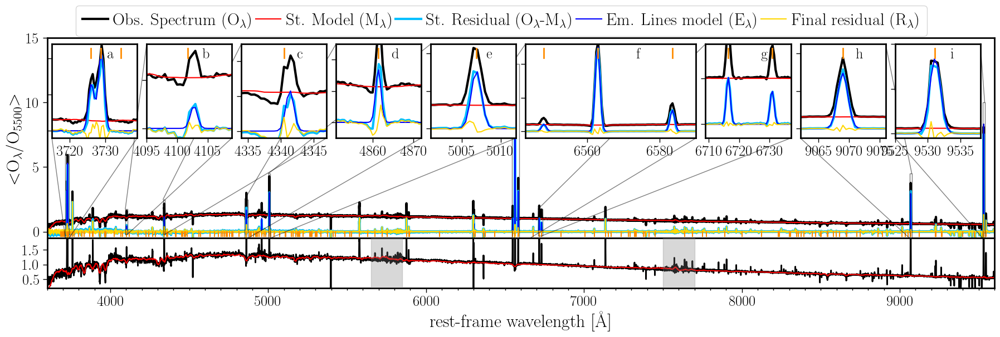

In [17]:
DIR='/disk-a/sanchez/LVM/LVM/ver_231113/output_sim/'

#DIR='/disk-a/sanchez/LVM/LVM/ver_231113/output_dap/'
label='00006109_cl_SN1_342_5_5_20.0'


file = '/disk-a/sanchez/LVM/LVM/ver_231113/output_dap_v1.0.3_tests/m_junk-sim-00006109_5_5_20.0_5.0.output.fits'

out_file_fit=f'{DIR}/m_{label}.output.fits'
out_file_ps=f'{DIR}/m_{label}.rsp.txt'
output_path='figs/'
outfile=f'm_fit_{label}.pdf'
tab_el=read_tab_EL('_legacy/emission_lines_long_list.LVM')
plot_spec(dir='',file=out_file_fit,\
            file_ssp = out_file_ps,\
                  name=None,text=None,output=f'{output_path}/{outfile}',\
                  insets=((0.005, 0.5, 0.09, 0.47,3715,3739,-0.5,6,'a'),\
                          (0.105, 0.5, 0.09, 0.47,4095,4109,-0.2,1.75,'b'),\
                          (0.205, 0.5, 0.09, 0.47,4334,4347,-0.2,2.5,'c'),\
                          (0.305, 0.5, 0.09, 0.47,4851,4872,-0.5,2.5,'d'),\
                          (0.405, 0.5, 0.09, 0.47,5001,5012,-0.5,4.5,'e'),\
                          (0.505, 0.5, 0.18, 0.47,6543,6590,-1,13,'f'),\
                          (0.695, 0.5, 0.09, 0.47,6709,6737,-0.3,1.75,'g'),\
                          (0.795, 0.5, 0.09, 0.47,9062,9076,-0.5,4.5,'h'),\
                          (0.895, 0.5, 0.09, 0.47,9525,9538,-0.5,10,'i')),
                          y_min=-0.5,y_max=15,y0_d=0.2,y1_d=1.9,\
              x_min=3600,x_max=9600,plot_el=True, tab_el=tab_el,\
              colors_in=['black','red','deepskyblue','blue','gold','forestgreen'],\
         plot_res=True)

/tmp/ipykernel_100787/1734954440.py:1453: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


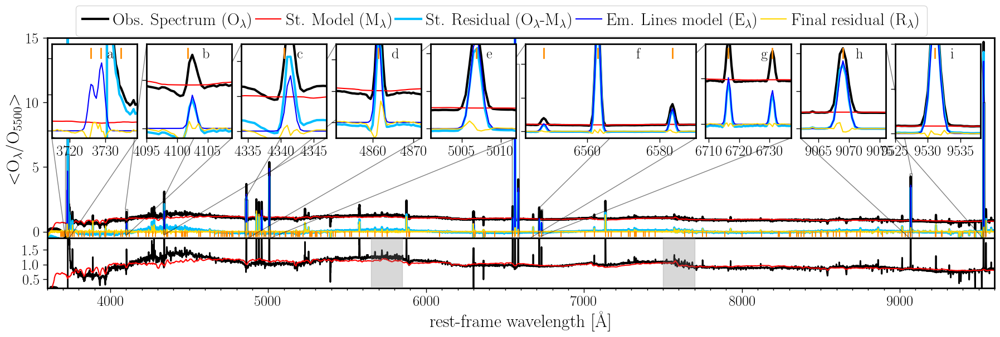

In [11]:
DIR='/disk-a/sanchez/LVM/LVM/ver_231113/output_sim/'

#DIR='/disk-a/sanchez/LVM/LVM/ver_231113/output_dap/'
label='00006109_cl_SN1_342_20_5_20.0'


out_file_fit=f'{DIR}/m_{label}.output.fits'
out_file_ps=f'{DIR}/m_{label}.rsp.txt'
output_path='figs/'
outfile=f'm_fit_{label}.pdf'
tab_el=read_tab_EL('_legacy/emission_lines_long_list.LVM')
plot_spec(dir='',file=out_file_fit,\
            file_ssp = out_file_ps,\
                  name=None,text=None,output=f'{output_path}/{outfile}',\
                  insets=((0.005, 0.5, 0.09, 0.47,3715,3739,-0.5,6,'a'),\
                          (0.105, 0.5, 0.09, 0.47,4095,4109,-0.2,1.75,'b'),\
                          (0.205, 0.5, 0.09, 0.47,4334,4347,-0.2,2.5,'c'),\
                          (0.305, 0.5, 0.09, 0.47,4851,4872,-0.5,2.5,'d'),\
                          (0.405, 0.5, 0.09, 0.47,5001,5012,-0.5,4.5,'e'),\
                          (0.505, 0.5, 0.18, 0.47,6543,6590,-1,13,'f'),\
                          (0.695, 0.5, 0.09, 0.47,6709,6737,-0.3,1.75,'g'),\
                          (0.795, 0.5, 0.09, 0.47,9062,9076,-0.5,4.5,'h'),\
                          (0.895, 0.5, 0.09, 0.47,9525,9538,-0.5,10,'i')),
                          y_min=-0.5,y_max=15,y0_d=0.2,y1_d=1.9,\
              x_min=3600,x_max=9600,plot_el=True, tab_el=tab_el,\
              colors_in=['black','red','deepskyblue','blue','gold','forestgreen'],\
         plot_res=True)

/tmp/ipykernel_354939/3973251035.py:1452: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


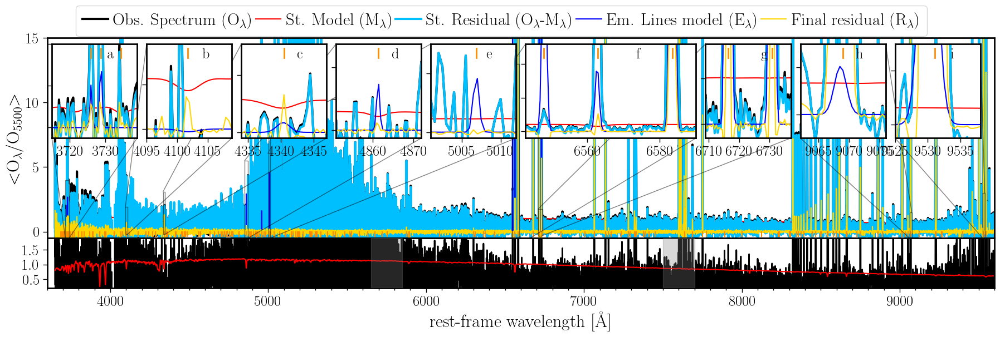

In [437]:
DIR='/disk-a/sanchez/LVM/LVM/ver_231113/output_sim_240214/'

#DIR='/disk-a/sanchez/LVM/LVM/ver_231113/output_dap/'
label='Scene1'
#m_Scene2.output.fits

out_file_fit=f'{DIR}/m_{label}.output.fits'
out_file_ps=f'{DIR}/m_{label}.rsp.txt'
output_path='figs/'
outfile=f'm_fit_{label}.pdf'
tab_el=read_tab_EL('_legacy/emission_lines_long_list.LVM')
plot_spec(dir='',file=out_file_fit,\
            file_ssp = out_file_ps,\
                  name=None,text=None,output=f'{output_path}/{outfile}',\
                  insets=((0.005, 0.5, 0.09, 0.47,3715,3739,-0.5,4,'a'),\
                          (0.105, 0.5, 0.09, 0.47,4095,4109,-0.2,1.9,'b'),\
                          (0.205, 0.5, 0.09, 0.47,4334,4347,-0.2,3.1,'c'),\
                          (0.305, 0.5, 0.09, 0.47,4851,4872,-0.5,5.5,'d'),\
                          (0.405, 0.5, 0.09, 0.47,5001,5012,-0.5,7.5,'e'),\
                          (0.505, 0.5, 0.18, 0.47,6543,6590,-1,13,'f'),\
                          (0.695, 0.5, 0.09, 0.47,6709,6737,-0.3,1.75,'g'),\
                          (0.795, 0.5, 0.09, 0.47,9062,9076,-0.5,1.5,'h'),\
                          (0.895, 0.5, 0.09, 0.47,9525,9538,-0.5,3,'i')),
                          y_min=-0.5,y_max=15,y0_d=0.2,y1_d=1.9,\
              x_min=3600,x_max=9600,plot_el=True, tab_el=tab_el,\
              colors_in=['black','red','deepskyblue','blue','gold','forestgreen'],\
         plot_res=True)

In [ ]:
#outfile=f'm_fit_{label}.pdf'
label='m_00006109_cl_SN1_342_1_5_100.0'

/home/sanchez/.local/lib/python3.11/site-packages/lvmdap/dap_tools.py:1518: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


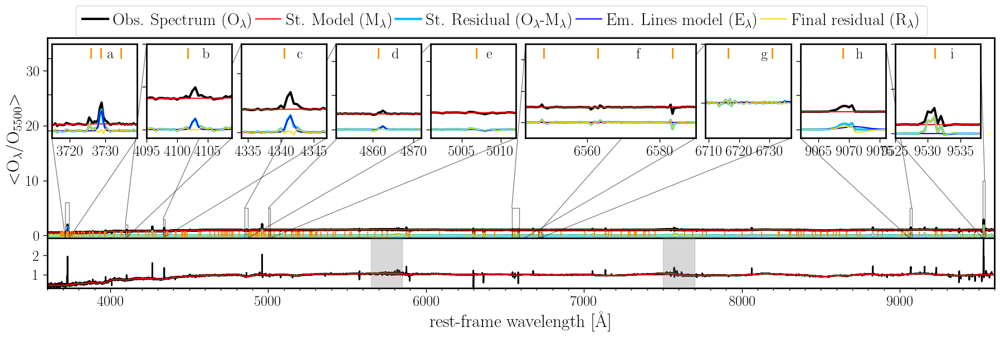

In [36]:
label='00006109_cl_SN1_342_1_125_100.0'

DIR='/disk-a/sanchez/LVM/LVM/ver_231113/output_sim/'
#DIR='/disk-a/sanchez/LVM/LVM/ver_231113/output_dap/'
#label='00006109_cl_SN1_342_1700_125_20.0'
out_file_fit=f'{DIR}/m_{label}.output.fits'
out_file_ps=f'{DIR}/m_{label}.rsp.txt'
output_path='figs/'
outfile=f'm_fit_{label}.pdf'
tab_el=read_tab_EL('_legacy/emission_lines_long_list.LVM')
plot_spec(dir='',file=out_file_fit,\
            file_ssp = out_file_ps,\
                  name=None,text=None,output=f'{output_path}/{outfile}',\
                  insets=((0.005, 0.5, 0.09, 0.47,3715,3739,-0.5,6,'a'),\
                          (0.105, 0.5, 0.09, 0.47,4095,4109,-0.2,2,'b'),\
                          (0.205, 0.5, 0.09, 0.47,4334,4347,-0.2,3,'c'),\
                          (0.305, 0.5, 0.09, 0.47,4851,4872,-0.5,5,'d'),\
                          (0.405, 0.5, 0.09, 0.47,5001,5012,-0.5,5,'e'),\
                          (0.505, 0.5, 0.18, 0.47,6543,6590,-1,5,'f'),\
                          (0.695, 0.5, 0.09, 0.47,6709,6737,-0.3,0.5,'g'),\
                          (0.795, 0.5, 0.09, 0.47,9062,9076,-0.5,5,'h'),\
                          (0.895, 0.5, 0.09, 0.47,9525,9538,-0.5,10,'i')),
                          y_min=-0.5,y_max=36,y0_d=0.3,y1_d=2.9,\
              x_min=3600,x_max=9600,plot_el=True, tab_el=tab_el,\
              colors_in=['black','red','deepskyblue','blue','gold','forestgreen'],\
         plot_res=True)

/home/sanchez/.local/lib/python3.11/site-packages/lvmdap/dap_tools.py:1518: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


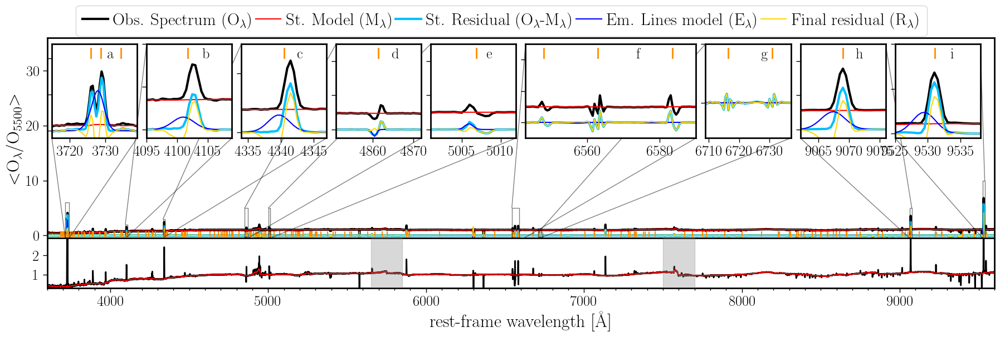

In [24]:
DIR='/disk-a/sanchez/LVM/LVM/ver_231113/output_sim/'

#DIR='/disk-a/sanchez/LVM/LVM/ver_231113/output_dap/'
out_file_fit=f'{DIR}/m_00006109_cl_SN1_342_1700_25_20.0.output.fits'
out_file_ps=f'{DIR}/m_00006109_cl_SN1_342_1700_125_20.0.rsp.txt'
output_path='figs/'
outfile='test.pdf'
tab_el=read_tab_EL('_legacy/emission_lines_long_list.LVM')
plot_spec(dir='',file=out_file_fit,\
            file_ssp = out_file_ps,\
                  name=None,text=None,output=f'{output_path}/{outfile}',\
                  insets=((0.005, 0.5, 0.09, 0.47,3715,3739,-0.5,6,'a'),\
                          (0.105, 0.5, 0.09, 0.47,4095,4109,-0.2,2,'b'),\
                          (0.205, 0.5, 0.09, 0.47,4334,4347,-0.2,3,'c'),\
                          (0.305, 0.5, 0.09, 0.47,4851,4872,-0.5,5,'d'),\
                          (0.405, 0.5, 0.09, 0.47,5001,5012,-0.5,5,'e'),\
                          (0.505, 0.5, 0.18, 0.47,6543,6590,-1,5,'f'),\
                          (0.695, 0.5, 0.09, 0.47,6709,6737,-0.3,0.5,'g'),\
                          (0.795, 0.5, 0.09, 0.47,9062,9076,-0.5,5,'h'),\
                          (0.895, 0.5, 0.09, 0.47,9525,9538,-0.5,10,'i')),
                          y_min=-0.5,y_max=36,y0_d=0.3,y1_d=2.9,\
              x_min=3600,x_max=9600,plot_el=True, tab_el=tab_el,\
              colors_in=['black','red','deepskyblue','blue','gold','forestgreen'],\
         plot_res=True)

/home/sanchez/.local/lib/python3.11/site-packages/lvmdap/dap_tools.py:1518: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


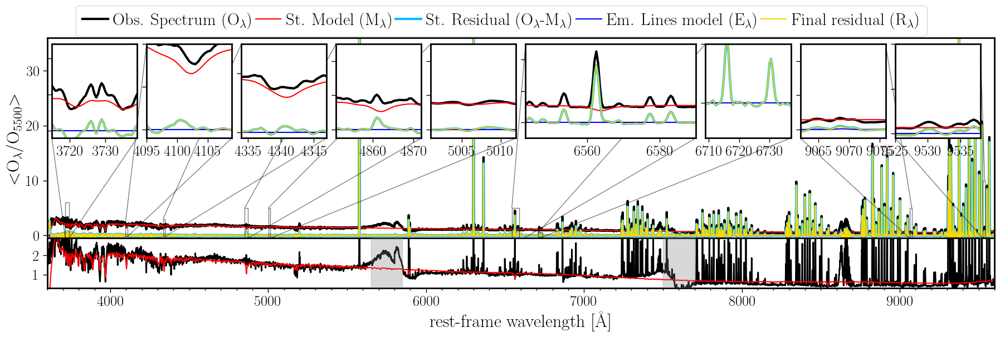

In [98]:
DIR='/disk-a/sanchez/LVM/LVM/ver_231113/output_sky/'

#DIR='/disk-a/sanchez/LVM/LVM/ver_231113/output_dap/'
out_file_fit=f'{DIR}/m_junk_sky.output.fits'
out_file_ps=f'{DIR}/m_junk_sky.rsp.txt'
output_path='figs/'
outfile='test_sky.pdf'
tab_el=read_tab_EL('_legacy/emission_lines_long_list.LVM')
plot_spec(dir='',file=out_file_fit,\
            file_ssp = out_file_ps,\
                  name=None,text=None,output=f'{output_path}/{outfile}',\
                  insets=((0.005, 0.5, 0.09, 0.47,3715,3739,-0.5,6,'a'),\
                          (0.105, 0.5, 0.09, 0.47,4095,4109,-0.2,2,'b'),\
                          (0.205, 0.5, 0.09, 0.47,4334,4347,-0.2,3,'c'),\
                          (0.305, 0.5, 0.09, 0.47,4851,4872,-0.5,5,'d'),\
                          (0.405, 0.5, 0.09, 0.47,5001,5012,-0.5,5,'e'),\
                          (0.505, 0.5, 0.18, 0.47,6543,6590,-1,5,'f'),\
                          (0.695, 0.5, 0.09, 0.47,6709,6737,-0.3,0.5,'g'),\
                          (0.795, 0.5, 0.09, 0.47,9062,9076,-0.5,5,'h'),\
                          (0.895, 0.5, 0.09, 0.47,9525,9538,-0.5,10,'i')),
                          y_min=-0.5,y_max=36,y0_d=0.3,y1_d=2.9,\
              x_min=3600,x_max=9600,plot_el=False, tab_el=tab_el,\
              colors_in=['black','red','deepskyblue','blue','gold','forestgreen'],\
         plot_res=True,show_scale=False)

/tmp/ipykernel_115041/1703237350.py:9: RankWarning: Polyfit may be poorly conditioned
  plot_spec(dir='',file=out_file_fit,\
/home/sanchez/.local/lib/python3.11/site-packages/lvmdap/dap_tools.py:1518: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


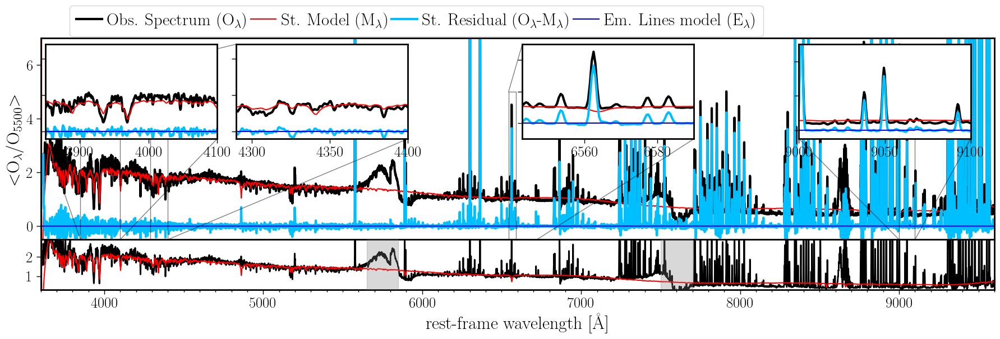

In [174]:
DIR='/disk-a/sanchez/LVM/LVM/ver_231113/output_sky/'

#DIR='/disk-a/sanchez/LVM/LVM/ver_231113/output_dap/'
out_file_fit=f'{DIR}/m_junk_sky.output.fits'
out_file_ps=f'{DIR}/m_junk_sky.rsp.txt'
output_path='figs/'
outfile='test_sky.pdf'
tab_el=read_tab_EL('_legacy/emission_lines_long_list.LVM')
plot_spec(dir='',file=out_file_fit,\
            file_ssp = out_file_ps,\
                  name=None,text=None,output=f'{output_path}/{outfile}',\
                  insets=((0.005, 0.5, 0.18, 0.47,3850,4100,-0.5,6,'a'),\
                          (0.205, 0.5, 0.18, 0.47,4290,4400,-0.5,6,'b'),\
                          (0.505, 0.5, 0.18, 0.47,6543,6590,-1,5,'c'),\
                          (0.795, 0.5, 0.18, 0.47,9000,9100,-0.5,5,'d')),
                          y_min=-0.5,y_max=7,y0_d=0.3,y1_d=2.9,\
              x_min=3600,x_max=9600,plot_el=False, tab_el=tab_el,\
              colors_in=['black','red','deepskyblue','blue','gold','forestgreen'],\
         plot_res=False,show_scale=False,n_ord=31)

/tmp/ipykernel_115041/332012849.py:9: RankWarning: Polyfit may be poorly conditioned
  plot_spec(dir='',file=out_file_fit,\
/home/sanchez/.local/lib/python3.11/site-packages/lvmdap/dap_tools.py:1518: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


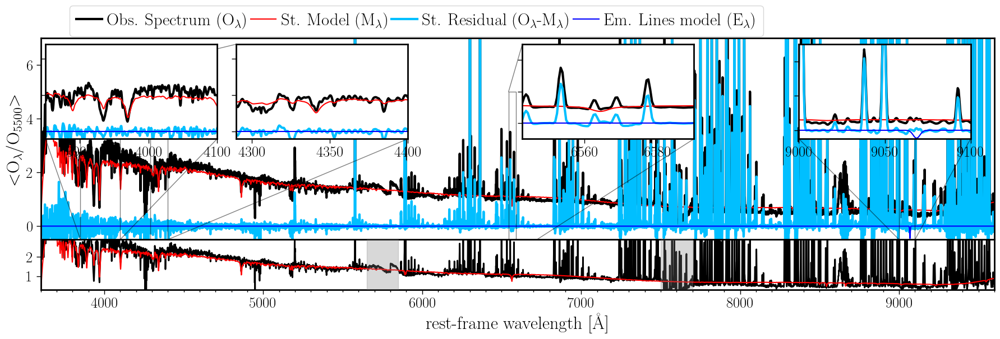

In [140]:
DIR='/disk-a/sanchez/LVM/LVM/ver_231113/output_sky/'

#DIR='/disk-a/sanchez/LVM/LVM/ver_231113/output_dap/'
out_file_fit=f'{DIR}/m_skyS-compilation.output.fits'
out_file_ps=f'{DIR}/m_skyS-compilation.rsp.txt'
output_path='figs/'
outfile='test_sky.pdf'
tab_el=read_tab_EL('_legacy/emission_lines_long_list.LVM')
plot_spec(dir='',file=out_file_fit,\
            file_ssp = out_file_ps,\
                  name=None,text=None,output=f'{output_path}/{outfile}',\
                  insets=((0.005, 0.5, 0.18, 0.47,3850,4100,-0.5,6,'a'),\
                          (0.205, 0.5, 0.18, 0.47,4290,4400,-0.5,6,'b'),\
                          (0.505, 0.5, 0.18, 0.47,6543,6590,-1,5,'c'),\
                          (0.795, 0.5, 0.18, 0.47,9000,9100,-0.5,5,'d')),
                          y_min=-0.5,y_max=7,y0_d=0.3,y1_d=2.9,\
              x_min=3600,x_max=9600,plot_el=False, tab_el=tab_el,\
              colors_in=['black','red','deepskyblue','blue','gold','forestgreen'],\
         plot_res=False,show_scale=False,n_ord=31)

/tmp/ipykernel_115041/3470055905.py:9: RankWarning: Polyfit may be poorly conditioned
  plot_spec(dir='',file=out_file_fit,\
/home/sanchez/.local/lib/python3.11/site-packages/lvmdap/dap_tools.py:1518: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


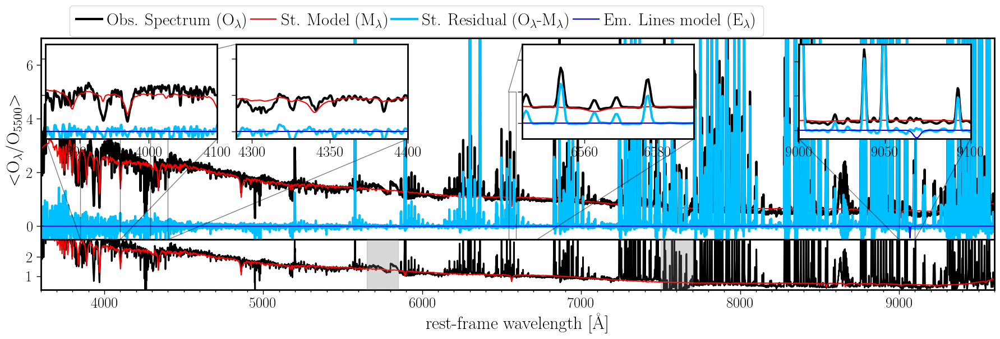

In [139]:
DIR='/disk-a/sanchez/LVM/LVM/ver_231113/output_sky/'

#DIR='/disk-a/sanchez/LVM/LVM/ver_231113/output_dap/'
out_file_fit=f'{DIR}/m_skyS-compilation2.output.fits'
out_file_ps=f'{DIR}/m_skyS-compilation2.rsp.txt'
output_path='figs/'
outfile='test_sky.pdf'
tab_el=read_tab_EL('_legacy/emission_lines_long_list.LVM')
plot_spec(dir='',file=out_file_fit,\
            file_ssp = out_file_ps,\
                  name=None,text=None,output=f'{output_path}/{outfile}',\
                  insets=((0.005, 0.5, 0.18, 0.47,3850,4100,-0.5,6,'a'),\
                          (0.205, 0.5, 0.18, 0.47,4290,4400,-0.5,6,'b'),\
                          (0.505, 0.5, 0.18, 0.47,6543,6590,-1,5,'c'),\
                          (0.795, 0.5, 0.18, 0.47,9000,9100,-0.5,5,'d')),
                          y_min=-0.5,y_max=7,y0_d=0.3,y1_d=2.9,\
              x_min=3600,x_max=9600,plot_el=False, tab_el=tab_el,\
              colors_in=['black','red','deepskyblue','blue','gold','forestgreen'],\
         plot_res=False,show_scale=False,n_ord=31)

/tmp/ipykernel_112978/3464849582.py:1615: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


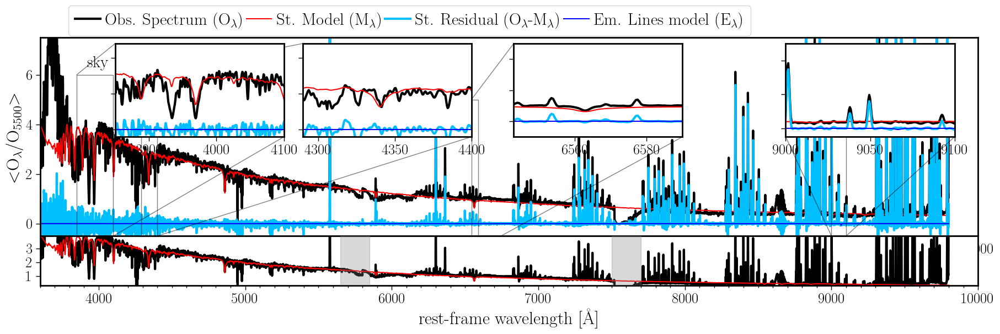

In [217]:
n_sp = 1
out_file_fit='output_sky/skyS-compilation2.output.fits.gz'
plot_spectra(dir='./',n_sp=n_sp,file=out_file_fit,\
             insets=((0.08, 0.5, 0.18, 0.47,3850,4100,-0.5,6,'a'),\
                          (0.28, 0.5, 0.18, 0.47,4290,4400,-0.5,6,'b'),\
                          (0.505, 0.5, 0.18, 0.47,6543,6590,-1,5,'c'),\
                          (0.795, 0.5, 0.18, 0.47,9000,9100,-0.5,5,'d')),
                   file_ssp = None,\
                   x_min=3600,x_max=10000,y_min=-0.5,y_max=7.5,\
                   y0_d=0.3,y1_d=3.9,
                   name='sky',text='sky',output=f'figs/skyS_{n_sp}.pdf',show_scale=False,n_ord=11)

In [182]:
from pyFIT3D.common.stats import median_filter

SIMPLE  =                    T / conforms to FITS standard                      BITPIX  =                  -64 / array data type                                NAXIS   =                    2 / number of array dimensions                     NAXIS1  =                12401                                                  NAXIS2  =                    6                                                  EXTEND  =                    T                                                  PIPELINE= 'pyPipe3D v1.1.5'                                                     UNIXTIME=           1713470623 / 2024-04-18 13:03:43.289736                     CRPIX1  =                    1                                                  CRVAL1  =    3599.999999999999                                                  CDELT1  =                  0.5                                                  NAME0   = 'org_spec'                                                            NAME1   = 'model_spec'                  

/tmp/ipykernel_115041/3141260473.py:20: RuntimeWarning: invalid value encountered in power
  plt.plot(spec_s**gamma)


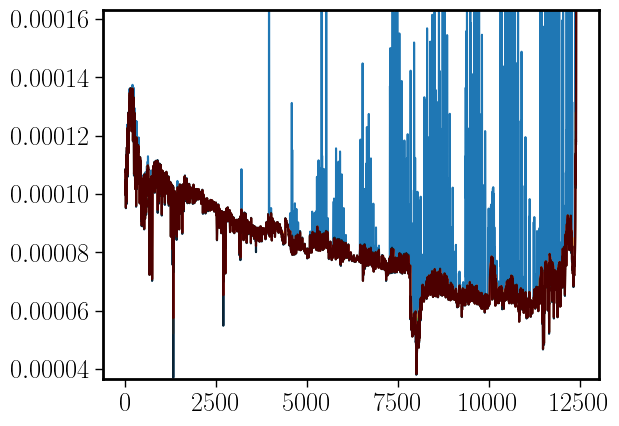

In [311]:
hdu=fits.open('output_sky/m_skyS-compilation.output.fits')

print(hdu[0].header)
print(np.nanmax(hdu[0].data[:,:]))
print(hdu[0].data.shape)

spec_s = hdu[0].data[0,:]
spec_s_org = spec_s.copy()
median_box = 100
niter = 15
scale = 1.0
gamma = 0.3
thresh = 0.8
median_box_min=1
mask = (spec_s>(-1)*np.abs(np.min(spec_s)))
print ('0',len(spec_s_org[mask]))
#print(mask)
m_spec_s = median_filter(median_box, spec_s)
pixels = np.arange(0,spec_s.shape[0])
plt.plot(spec_s**gamma)
i_len_in = len(spec_s_org[mask])
for i in range(niter):
    mask = mask & (np.divide(m_spec_s, spec_s, where=spec_s != 0, out=np.zeros_like(spec_s)) > thresh)
    i_len = len(spec_s_org[mask])
    if (i_len==i_len_in):
        break
    else:
        i_len_in=i_len
    spec_s = np.interp(pixels, pixels[mask], spec_s[mask])
    m_spec_s = median_filter(median_box, spec_s)
    plt.plot(m_spec_s**gamma,alpha=0.7)
    median_box = int(median_box*0.5)
    if (median_box<median_box_min):
        median_box=median_box_min

plt.plot(m_spec_s**gamma,color='r')
spec_s = np.interp(pixels, pixels[mask], spec_s_org[mask])
plt.plot(spec_s**gamma,color='k',alpha=0.7)

#mask_end = (spec_s < m_spec_s)
#spec_s_plot = np.interp(pixels, pixels[mask_end], spec_s_org[mask_end])
#plt.plot(spec_s_plot**gamma,color='k')
#spec_s = np.interp(pixels, pixels[mask], spec_s_org[mask])
    
plt.ylim(0.95*np.min(m_spec_s**gamma),0.8*np.max(m_spec_s**gamma))
#plt.xlim(8000,10000)
hdu[0].data[1,:]=spec_s
hdu[0].data[2,:]=spec_s
hdu.writeto('output_sky/test_min.fits',overwrite=True)



/tmp/ipykernel_115041/1641205657.py:86: RuntimeWarning: invalid value encountered in power
  plt.plot(spec_s**0.3)


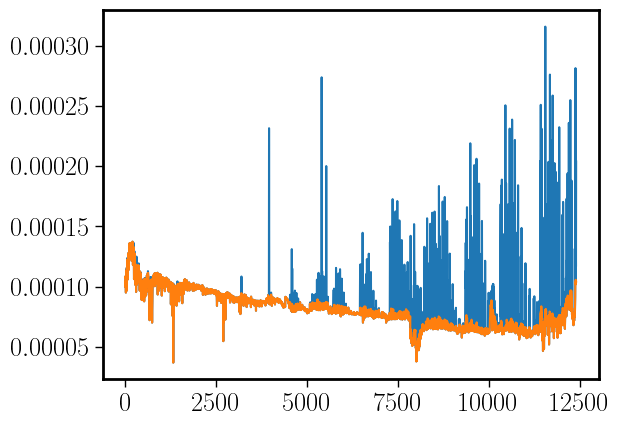

In [346]:
#
# spec_s is just the data array
#
def adaptive_smooth(data, start_width, end_width):
    """
    Smooth an array with a filter that adapts in size from start_width to end_width.
    
    Parameters:
    - data (np.array): The input array to be smoothed.
    - start_width (int): The width of the smoothing kernel at the beginning of the array.
    - end_width (int): The width of the smoothing kernel at the end of the array.
    
    Returns:
    - np.array: The smoothed array.
    """
    # Create an array of kernel sizes changing linearly from start_width to end_width
    n_points = len(data)
    kernel_sizes = np.linspace(start_width, end_width, n_points).astype(int)
    # Output array initialization
    smoothed_data = np.zeros_like(data)
    
    # Apply varying filter
    for i in range(n_points):
        # Handle boundary effects by determining effective kernel size
        half_width = kernel_sizes[i] // 2
        start_index = max(0, i - half_width)
        end_index = min(n_points, i + half_width + 1)
        
        # Apply uniform filter to the local segment of the data
        smoothed_data[i] = np.median(data[start_index:end_index])
    
    return smoothed_data



def find_continuum(spec_s,niter=15,thresh=0.8,median_box_max=100,median_box_min=1):
    """
    find the continuum from a spectrum by smoothing and masking the values above
    the smoothed version in an iterative way.
    
    Parameters:
    - data (np.array): The input array from which we would like to find the continuum.
    - niter  (int): Maximum number of iterations
    - thresh (float): Threshold to compare the smoothed an unsmoother version
    - median_box_max (float): Maximum size of the smoothing box
    - median_box_min (float): Minumum size of the smoothing box    

    Returns:
    - np.array: continuum spectrum.
    """
    median_box=median_box_max
    spec_s_org = spec_s.copy()
    mask = (spec_s>(-1)*np.abs(np.min(spec_s)))
    #m_spec_s = adaptive_smooth(spec_s, median_box, int(median_box_max*0.5))
    m_spec_s = median_filter(median_box, spec_s)
    pixels = np.arange(0,spec_s.shape[0])
    i_len_in = len(spec_s_org[mask])
    for i in range(niter):
        mask = mask & (np.divide(m_spec_s, spec_s, where=spec_s != 0, out=np.zeros_like(spec_s)) > thresh)
        i_len = len(spec_s_org[mask])
        if (i_len==i_len_in):
            break
        else:
            i_len_in=i_len
        spec_s = np.interp(pixels, pixels[mask], spec_s[mask])
        m_spec_s = adaptive_smooth(spec_s, median_box, median_box_max)
#        m_spec_s = median_filter(median_box, spec_s)
        median_box = int(median_box*0.5)
        if (median_box<median_box_min):
            median_box=median_box_min
        

    spec_s = np.interp(pixels, pixels[mask], spec_s_org[mask])
    spec_s_out = spec_s
#    s_spec_s = adaptive_smooth(spec_s, median_box_min, int(median_box_max*0.5))
#    w1 = 1/(1+pixels)
#    w2 = pixels
#    wN = w1+w2
#    w1 = w1/wN
#    w2 = w2/wN
#    print(w1,w2)
#    spec_s_out = w1*spec_s + w2*s_spec_s
    return spec_s_out

spec_s = hdu[0].data[0,:]
plt.plot(spec_s**0.3)
spec_s = find_continuum(spec_s,niter=15,thresh=0.8,median_box_max=50,median_box_min=1)
s_spec_s = s_spec_s #adaptive_smooth(spec_s, 1, 20)
plt.plot(spec_s**0.3)
hdu[0].data[1,:]=s_spec_s
hdu[0].data[2,:]=s_spec_s
hdu.writeto('output_sky/test_min.fits',overwrite=True)



/home/sanchez/.local/lib/python3.11/site-packages/lvmdap/dap_tools.py:1518: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


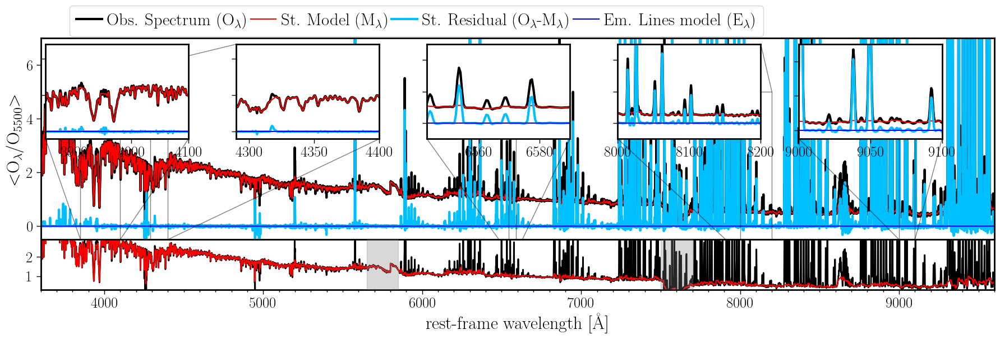

In [347]:
DIR='/disk-a/sanchez/LVM/LVM/ver_231113/output_sky/'

#DIR='/disk-a/sanchez/LVM/LVM/ver_231113/output_dap/'
out_file_fit=f'{DIR}/test_min.fits'
out_file_ps=f'{DIR}/m_skyS-compilation2.rsp.txt'
output_path='figs/'
outfile='test_sky.pdf'
tab_el=read_tab_EL('_legacy/emission_lines_long_list.LVM')
plot_spec(dir='',file=out_file_fit,\
            file_ssp = out_file_ps,\
                  name=None,text=None,output=f'{output_path}/{outfile}',\
                  insets=((0.005, 0.5, 0.15, 0.47,3850,4100,-0.5,6,'a'),\
                          (0.205, 0.5, 0.15, 0.47,4290,4400,-0.5,6,'b'),\
                          (0.405, 0.5, 0.15, 0.47,6543,6590,-1,5,'c'),\
                          (0.605, 0.5, 0.15, 0.47,8000,8200,-1,5,'d'),\
                          (0.795, 0.5, 0.15, 0.47,9000,9100,-0.5,5,'e')),
                          y_min=-0.5,y_max=7,y0_d=0.3,y1_d=2.9,\
              x_min=3600,x_max=9600,plot_el=False, tab_el=tab_el,\
              colors_in=['black','red','deepskyblue','blue','gold','forestgreen'],\
         plot_res=False)#,show_scale=False,n_ord=31)

In [165]:
hdu=fits.open('output_sky/skyS-compilation.output.fits.gz')
print(hdu[0].header)
print(np.nanmax(hdu[0].data[:,6,:]))
print(hdu[0].data.shape)

SIMPLE  =                    T / conforms to FITS standard                      BITPIX  =                  -64 / array data type                                NAXIS   =                    3 / number of array dimensions                     NAXIS1  =                12401                                                  NAXIS2  =                    8                                                  NAXIS3  =                    6                                                  EXTEND  =                    T                                                  PIPELINE= 'pyPipe3D v1.1.5'                                                     UNIXTIME=           1713470969 / 2024-04-18 13:09:29.313078                     CRPIX1  =                    1                                                  CRVAL1  =    3599.999999999999                                                  CDELT1  =                  0.5                                                  NAME0   = 'org_spec'                    

/home/sanchez/.local/lib/python3.11/site-packages/lvmdap/dap_tools.py:1680: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


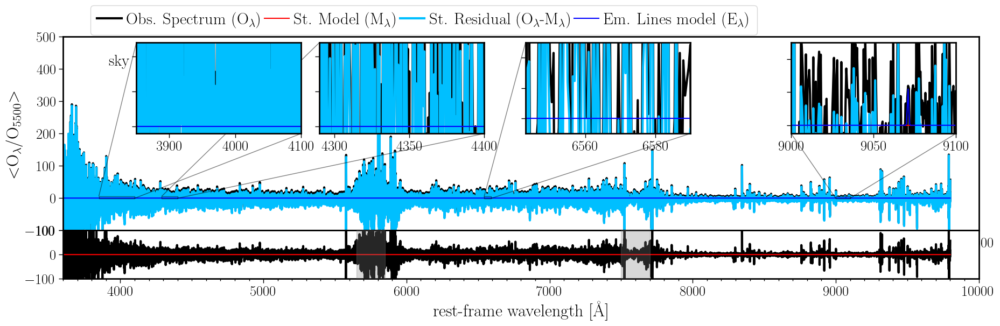

In [170]:
n_sp = 6
out_file_fit='output_sky/skyS-compilation.output.fits.gz'
plot_spectra(dir='./',n_sp=n_sp,file=out_file_fit,\
             insets=((0.08, 0.5, 0.18, 0.47,3850,4100,-0.5,6,'a'),\
                          (0.28, 0.5, 0.18, 0.47,4290,4400,-0.5,6,'b'),\
                          (0.505, 0.5, 0.18, 0.47,6543,6590,-1,5,'c'),\
                          (0.795, 0.5, 0.18, 0.47,9000,9100,-0.5,5,'d')),
                   file_ssp = None,\
                   x_min=3600,x_max=10000,y_min=-100,y_max=500,\
                   y0_d=-100,y1_d=100,
                   name='sky',text='sky',output=f'figs/skyS_{n_sp}.pdf',show_scale=False,n_ord=11)

--------- SkyE_4852.fits -------


/home/sanchez/.local/lib/python3.11/site-packages/lvmdap/dap_tools.py:1680: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


--------- SkyM_5554_s.fits -------


/home/sanchez/.local/lib/python3.11/site-packages/lvmdap/dap_tools.py:1680: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


--------- SkyW_5554_s.fits -------


/home/sanchez/.local/lib/python3.11/site-packages/lvmdap/dap_tools.py:1680: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


--------- SkyW_4852.fits -------


/home/sanchez/.local/lib/python3.11/site-packages/lvmdap/dap_tools.py:1680: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


--------- Sci_5554_s.fits -------


/home/sanchez/.local/lib/python3.11/site-packages/lvmdap/dap_tools.py:1680: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


--------- Sci_4852.fits -------


/home/sanchez/.local/lib/python3.11/site-packages/lvmdap/dap_tools.py:1680: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


--------- SkyE_5554_s.fits -------


/home/sanchez/.local/lib/python3.11/site-packages/lvmdap/dap_tools.py:1680: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


--------- SkyM_4852.fits -------


/home/sanchez/.local/lib/python3.11/site-packages/lvmdap/dap_tools.py:1680: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


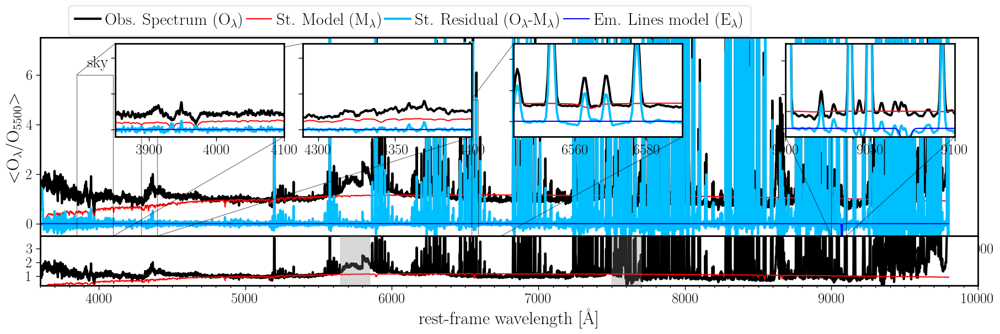

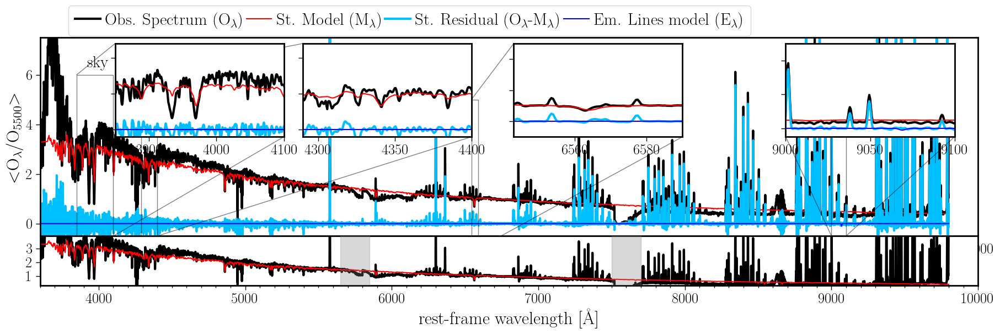

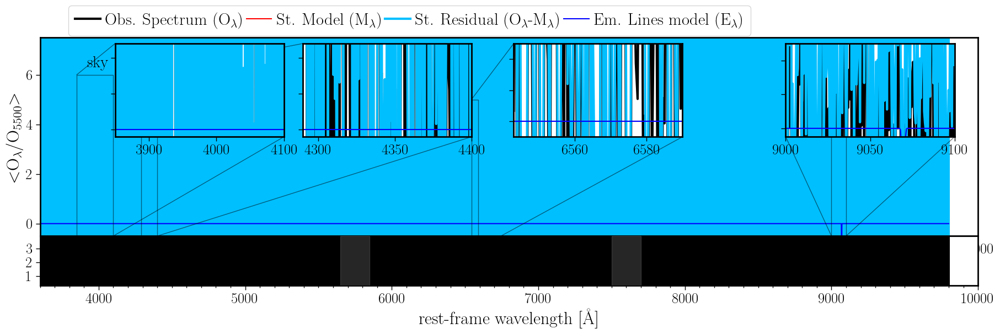

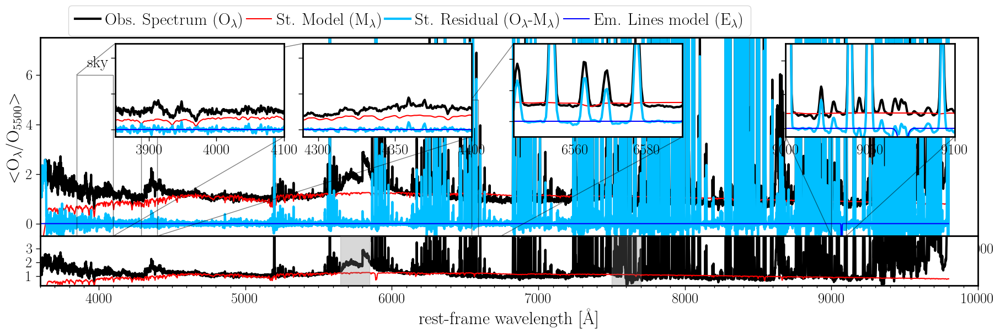

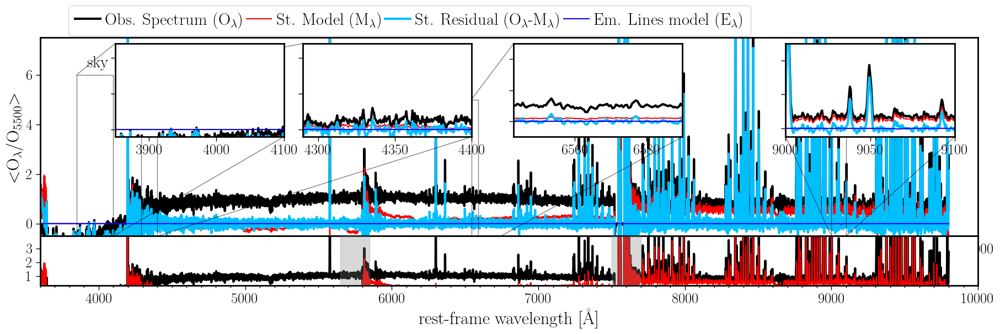

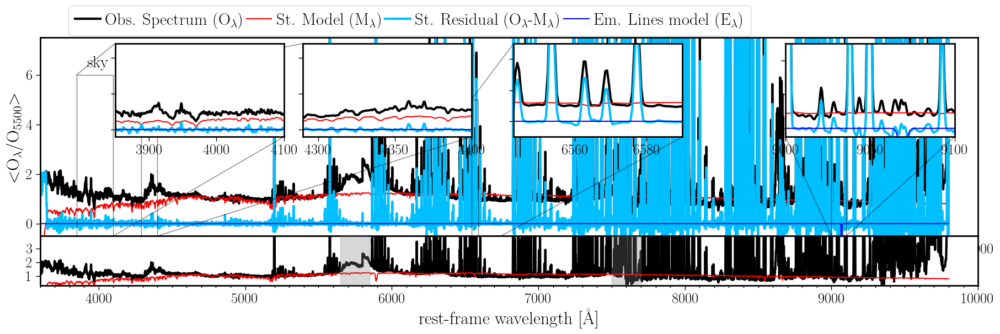

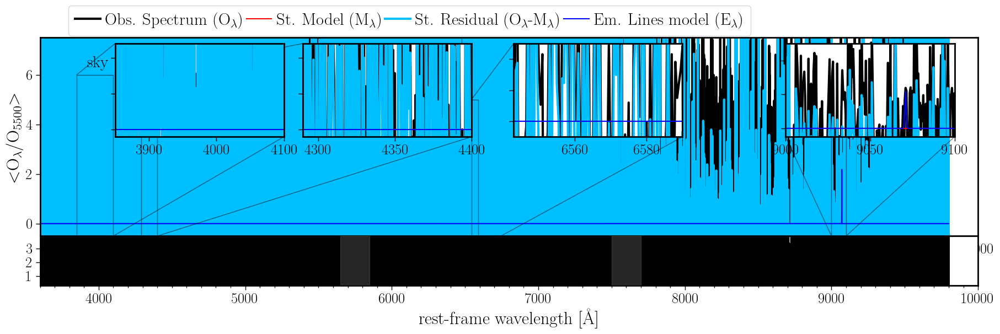

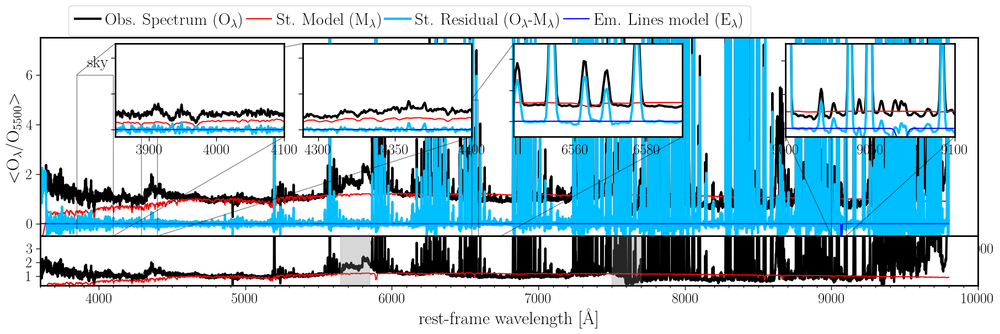

In [135]:
fnames = ('SkyE_4852.fits','SkyM_5554_s.fits','SkyW_5554_s.fits','SkyW_4852.fits','Sci_5554_s.fits','Sci_4852.fits','SkyE_5554_s.fits','SkyM_4852.fits')
for n_sp,fname in enumerate(fnames):
    print(f'--------- {fname} -------')
    out_file_fit='output_sky/skyS-compilation.output.fits.gz'
    plot_spectra(dir='./',n_sp=n_sp,file=out_file_fit,\
                 insets=((0.08, 0.5, 0.18, 0.47,3850,4100,-0.5,6,'a'),\
                         (0.28, 0.5, 0.18, 0.47,4290,4400,-0.5,6,'b'),\
                         (0.505, 0.5, 0.18, 0.47,6543,6590,-1,5,'c'),\
                         (0.795, 0.5, 0.18, 0.47,9000,9100,-0.5,5,'d')),
                 file_ssp = None,\
                 x_min=3600,x_max=10000,y_min=-0.5,y_max=7.5,\
                 y0_d=0.3,y1_d=3.9, 
                 name=f'{fname}',text='sky',output=f'figs/fit_{fname}.pdf',show_scale=False,n_ord=11)


--------- SkyE_4852.fits -------


/home/sanchez/.local/lib/python3.11/site-packages/lvmdap/dap_tools.py:1680: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


--------- SkyM_5554_s.fits -------


/home/sanchez/.local/lib/python3.11/site-packages/lvmdap/dap_tools.py:1680: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


--------- SkyW_5554_s.fits -------


/home/sanchez/.local/lib/python3.11/site-packages/lvmdap/dap_tools.py:1680: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


--------- SkyW_4852.fits -------


/home/sanchez/.local/lib/python3.11/site-packages/lvmdap/dap_tools.py:1680: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


--------- Sci_5554_s.fits -------


/home/sanchez/.local/lib/python3.11/site-packages/lvmdap/dap_tools.py:1680: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


--------- Sci_4852.fits -------


/home/sanchez/.local/lib/python3.11/site-packages/lvmdap/dap_tools.py:1680: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


--------- SkyE_5554_s.fits -------


/home/sanchez/.local/lib/python3.11/site-packages/lvmdap/dap_tools.py:1680: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


--------- SkyM_4852.fits -------


/home/sanchez/.local/lib/python3.11/site-packages/lvmdap/dap_tools.py:1680: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


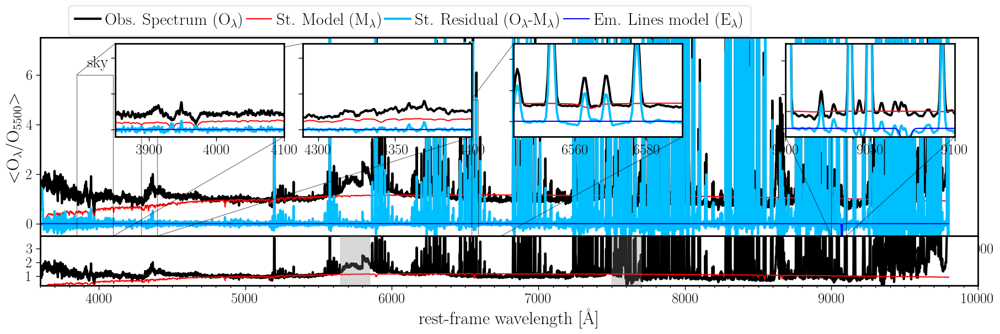

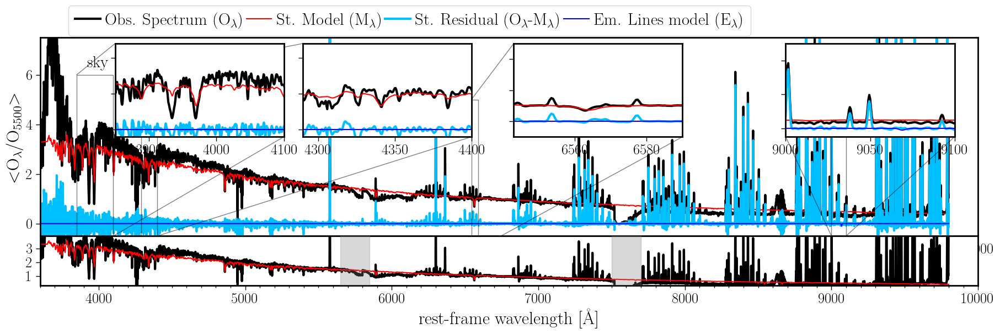

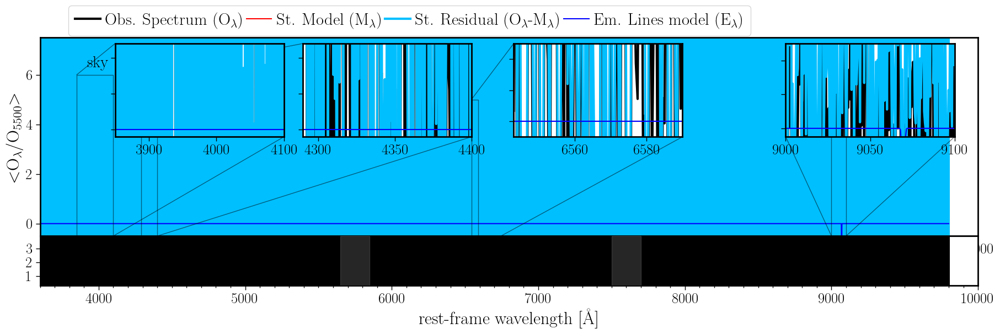

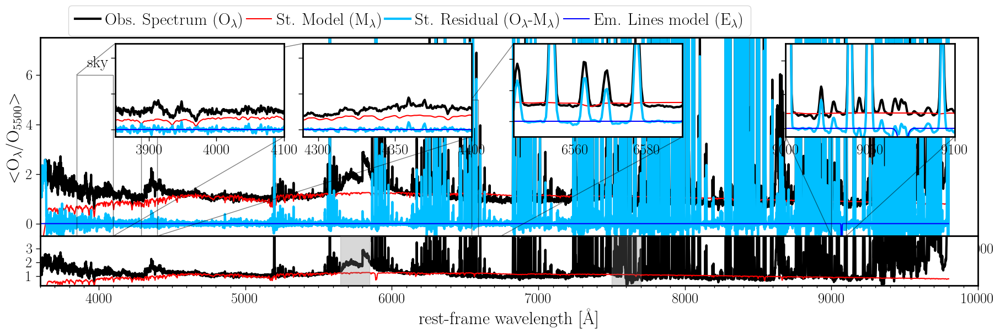

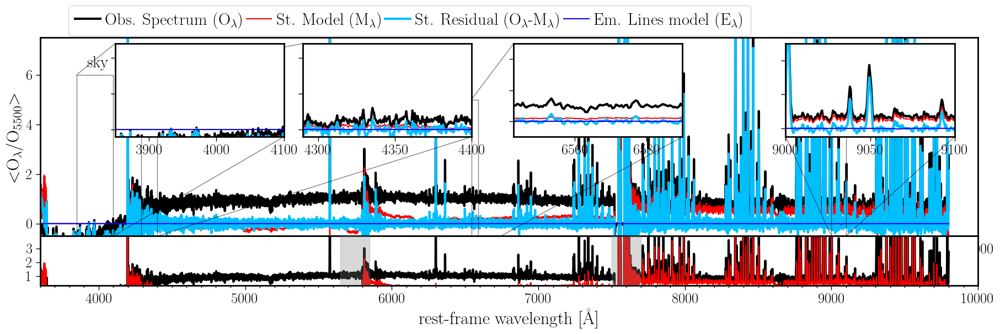

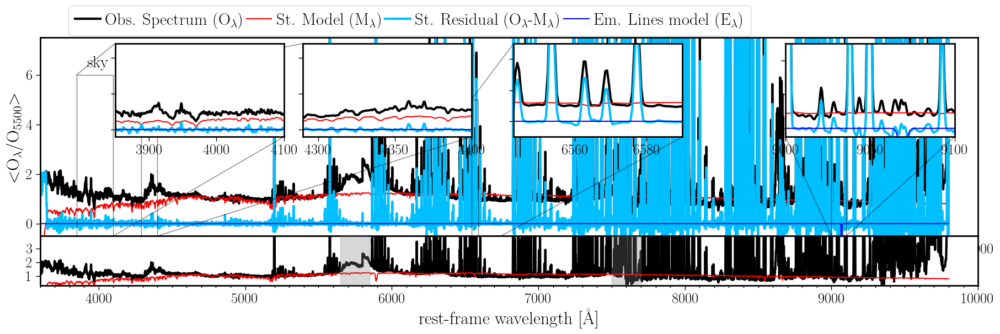

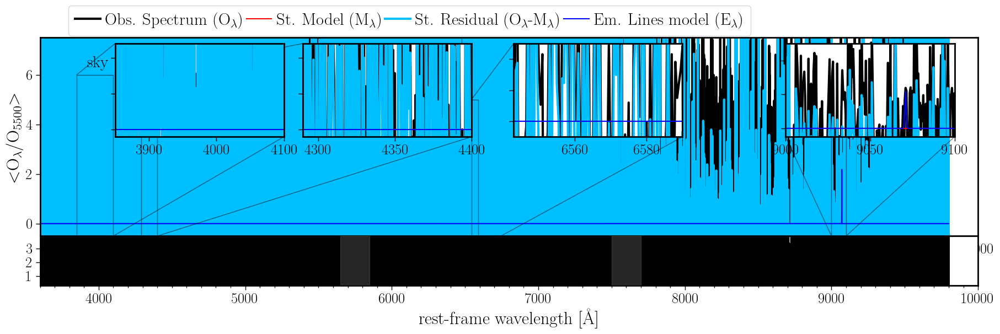

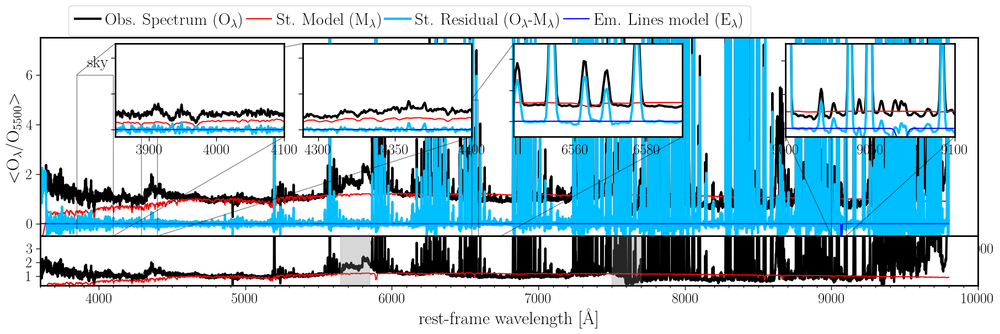

In [136]:
fnames = ('SkyE_4852.fits','SkyM_5554_s.fits','SkyW_5554_s.fits','SkyW_4852.fits','Sci_5554_s.fits','Sci_4852.fits','SkyE_5554_s.fits','SkyM_4852.fits')
for n_sp,fname in enumerate(fnames):
    print(f'--------- {fname} -------')
    out_file_fit='output_sky/skyS-compilation.output.fits.gz'
    plot_spectra(dir='./',n_sp=n_sp,file=out_file_fit,\
                 insets=((0.08, 0.5, 0.18, 0.47,3850,4100,-0.5,6,'a'),\
                         (0.28, 0.5, 0.18, 0.47,4290,4400,-0.5,6,'b'),\
                         (0.505, 0.5, 0.18, 0.47,6543,6590,-1,5,'c'),\
                         (0.795, 0.5, 0.18, 0.47,9000,9100,-0.5,5,'d')),
                 file_ssp = None,\
                 x_min=3600,x_max=10000,y_min=-0.5,y_max=7.5,\
                 y0_d=0.3,y1_d=3.9, 
                 name=f'{fname}',text='sky',output=f'figs/fit_sc_{fname}.pdf')#,show_scale=False,n_ord=11)


--------- SkyE_4852.fits -------


/home/sanchez/.local/lib/python3.11/site-packages/lvmdap/dap_tools.py:1680: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


--------- SkyM_5554_s.fits -------


/home/sanchez/.local/lib/python3.11/site-packages/lvmdap/dap_tools.py:1680: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


--------- SkyW_5554_s.fits -------


/home/sanchez/.local/lib/python3.11/site-packages/lvmdap/dap_tools.py:1680: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


--------- SkyW_4852.fits -------


/home/sanchez/.local/lib/python3.11/site-packages/lvmdap/dap_tools.py:1680: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


--------- Sci_5554_s.fits -------


/home/sanchez/.local/lib/python3.11/site-packages/lvmdap/dap_tools.py:1680: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


--------- Sci_4852.fits -------


/home/sanchez/.local/lib/python3.11/site-packages/lvmdap/dap_tools.py:1680: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


--------- SkyE_5554_s.fits -------


/home/sanchez/.local/lib/python3.11/site-packages/lvmdap/dap_tools.py:1680: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


--------- SkyM_4852.fits -------


/home/sanchez/.local/lib/python3.11/site-packages/lvmdap/dap_tools.py:1680: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


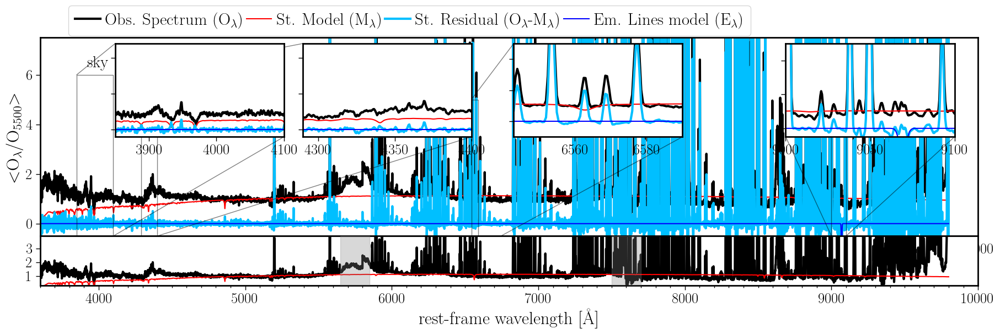

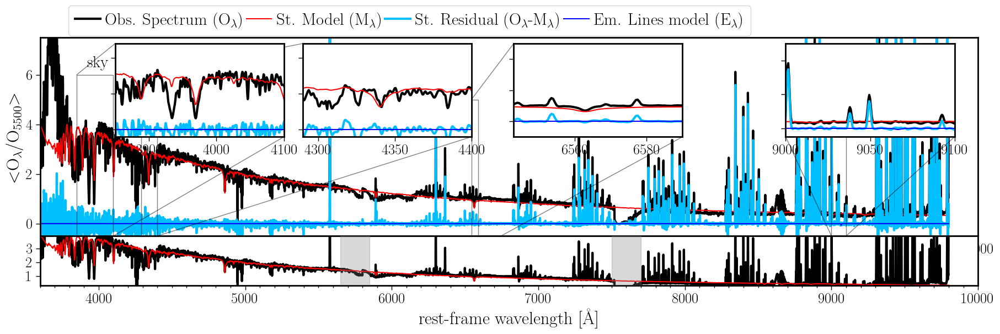

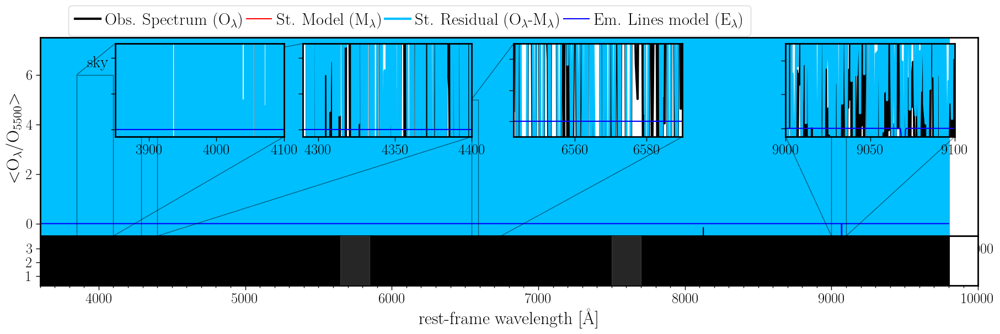

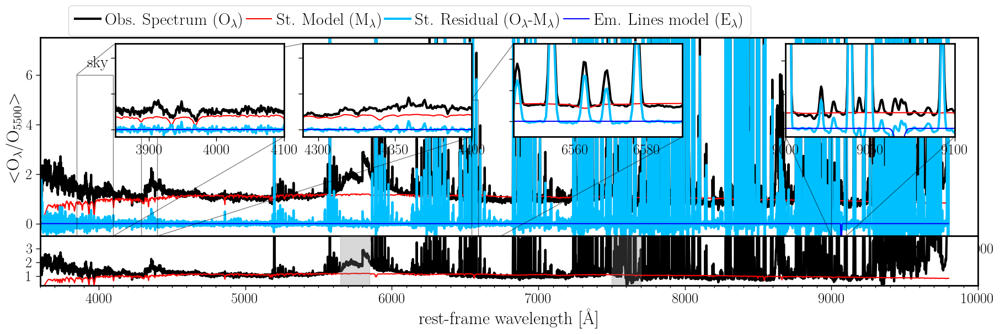

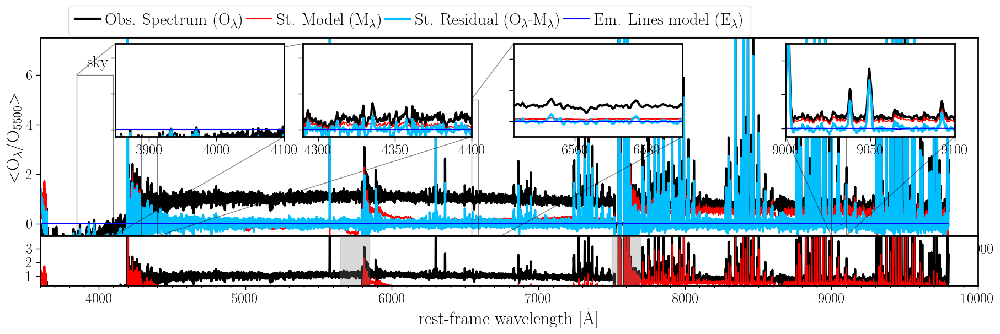

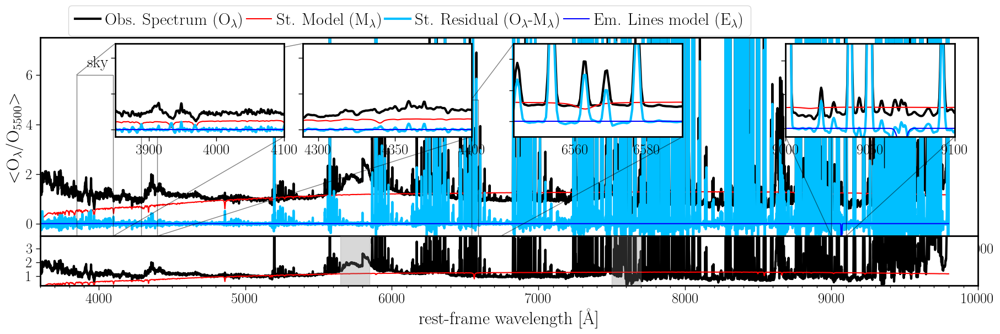

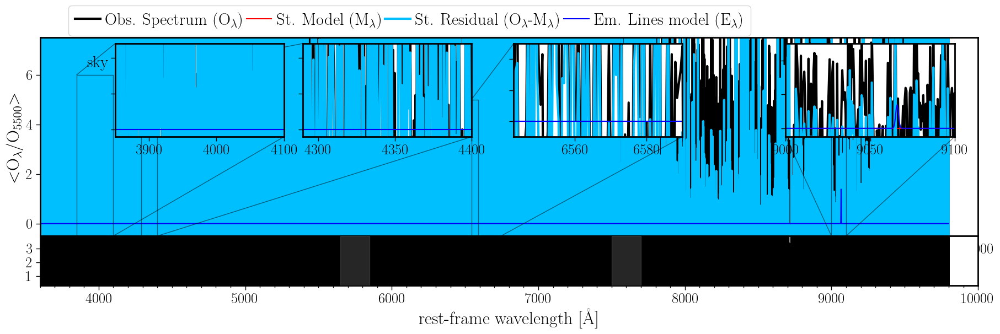

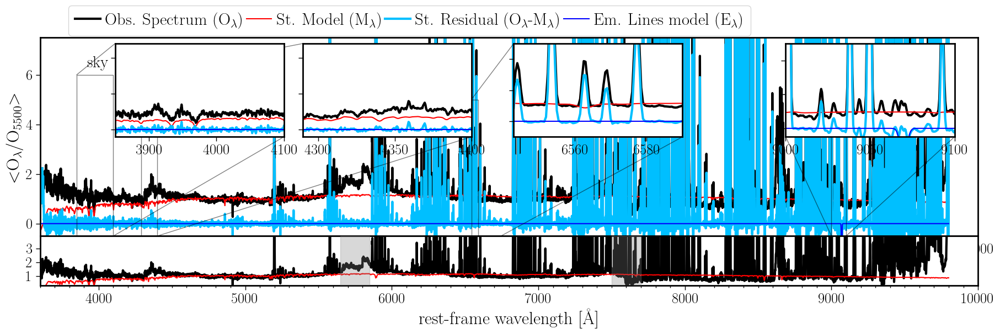

In [171]:
fnames = ('SkyE_4852.fits','SkyM_5554_s.fits','SkyW_5554_s.fits','SkyW_4852.fits','Sci_5554_s.fits','Sci_4852.fits','SkyE_5554_s.fits','SkyM_4852.fits')
for n_sp,fname in enumerate(fnames):
    print(f'--------- {fname} -------')
    out_file_fit='output_sky/skyS-compilation2.output.fits.gz'
    plot_spectra(dir='./',n_sp=n_sp,file=out_file_fit,\
                 insets=((0.08, 0.5, 0.18, 0.47,3850,4100,-0.5,6,'a'),\
                         (0.28, 0.5, 0.18, 0.47,4290,4400,-0.5,6,'b'),\
                         (0.505, 0.5, 0.18, 0.47,6543,6590,-1,5,'c'),\
                         (0.795, 0.5, 0.18, 0.47,9000,9100,-0.5,5,'d')),
                 file_ssp = None,\
                 x_min=3600,x_max=10000,y_min=-0.5,y_max=7.5,\
                 y0_d=0.3,y1_d=3.9, 
                 name=f'{fname}',text='sky',output=f'figs/fit_sc_{fname}_2.pdf')#,show_scale=False,n_ord=11)


In [ ]:
fnames = ('SkyE_4852.fits','SkyM_5554_s.fits','SkyW_5554_s.fits','SkyW_4852.fits','Sci_5554_s.fits','Sci_4852.fits','SkyE_5554_s.fits','SkyM_4852.fits')
for I,fname in enumerate(fnames):
    

In [ ]:
out_file_fit='output_ofelia_new/dap-rsp30-sn20-00006109.output.fits.gz'
plot_spectra(dir='./',n_sp=875,file=out_file_fit,\
             insets=((0.005, 0.5, 0.09, 0.47,3715,3739,-0.5,6,'a'),\
                          (0.105, 0.5, 0.09, 0.47,4095,4109,-0.2,2,'b'),\
                          (0.205, 0.5, 0.09, 0.47,4334,4347,-0.2,3,'c'),\
                          (0.305, 0.5, 0.09, 0.47,4851,4872,-0.5,8,'d'),\
                          (0.405, 0.5, 0.09, 0.47,5001,5012,-0.5,10,'e'),\
                          (0.505, 0.5, 0.18, 0.47,6543,6590,-1,35,'f'),\
                          (0.695, 0.5, 0.09, 0.47,6709,6737,-0.2,4,'g'),\
                          (0.795, 0.5, 0.09, 0.47,9062,9076,-0.5,8,'h'),\
                          (0.895, 0.5, 0.09, 0.47,9525,9538,-0.5,18,'i')),
                   file_ssp = None,\
                   x_min=3600,x_max=10000,y_min=-10,y_max=15.5,\
                   y0_d=-2,y1_d=2.9, 
                   name='junk',text='junk',output=f'junk_nsc.pdf',show_scale=False)

In [4]:
DIR='/disk-a/sanchez/LVM/LVM/ver_231113/output_dap/'
out_file_fit=f'{DIR}/m_junk6109.output.fits'
out_file_ps=f'{DIR}/m_junk6109.rsp.txt'
output_path='figs/'
outfile='test.pdf'
tab_el=read_tab_EL('_legacy/emission_lines_long_list.LVM')
plot_spec(dir='',file=out_file_fit,\
            file_ssp = out_file_ps,\
                  name=None,text=None,output=f'{output_path}/{outfile}',\
                  insets=((0.005, 0.5, 0.09, 0.47,3715,3739,-0.5,6,'a'),\
                          (0.105, 0.5, 0.09, 0.47,4095,4109,-0.2,2,'b'),\
                          (0.205, 0.5, 0.09, 0.47,4334,4347,-0.2,3,'c'),\
                          (0.305, 0.5, 0.09, 0.47,4851,4872,-0.5,8,'d'),\
                          (0.405, 0.5, 0.09, 0.47,5001,5012,-0.5,10,'e'),\
                          (0.505, 0.5, 0.18, 0.47,6543,6590,-1,35,'f'),\
                          (0.695, 0.5, 0.09, 0.47,6709,6737,-0.2,4,'g'),\
                          (0.795, 0.5, 0.09, 0.47,9062,9076,-0.5,8,'h'),\
                          (0.895, 0.5, 0.09, 0.47,9525,9538,-0.5,18,'i')),
                          y_min=-0.5,y_max=36,y0_d=0.3,y1_d=2.9,\
              x_min=3600,x_max=9600,plot_el=True, tab_el=tab_el,\
              colors_in=['black','red','deepskyblue','blue','gold','forestgreen'],\
         plot_res=True,show_scale=False,n_ord=2)

FileNotFoundError: [Errno 2] No such file or directory: '/disk-a/sanchez/LVM/LVM/ver_231113/output_dap//m_junk6109.rsp.txt'

In [ ]:
DIR='/disk-a/sanchez/LVM/LVM/ver_231113/output_dap/'
out_file_fit=f'{DIR}/m_test_cl100.output.fits'
out_file_ps=f'{DIR}/m_test_cl100.rsp.txt'
output_path='figs/'
outfile='test.pdf'
tab_el=read_tab_EL('_legacy/emission_lines_long_list.LVM')
plot_spec(dir='',file=out_file_fit,\
            file_ssp = out_file_ps,\
                  name=None,text=None,output=f'{output_path}/{outfile}',\
                  insets=((0.005, 0.5, 0.09, 0.47,3715,3739,-0.5,6,'a'),\
                          (0.105, 0.5, 0.09, 0.47,4095,4109,-0.2,2,'b'),\
                          (0.205, 0.5, 0.09, 0.47,4334,4347,-0.2,3,'c'),\
                          (0.305, 0.5, 0.09, 0.47,4851,4872,-0.5,8,'d'),\
                          (0.405, 0.5, 0.09, 0.47,5001,5012,-0.5,10,'e'),\
                          (0.505, 0.5, 0.18, 0.47,6543,6590,-1,35,'f'),\
                          (0.695, 0.5, 0.09, 0.47,6709,6737,-0.2,4,'g'),\
                          (0.795, 0.5, 0.09, 0.47,9062,9076,-0.5,8,'h'),\
                          (0.895, 0.5, 0.09, 0.47,9525,9538,-0.5,18,'i')),
                          y_min=-0.5,y_max=36,y0_d=0.3,y1_d=2.9,\
              x_min=3600,x_max=9600,plot_el=True, tab_el=tab_el,\
              colors_in=['black','red','deepskyblue','blue','gold','forestgreen'],\
         plot_res=True, show_scale=False,n_ord=0)

/home/sanchez/.local/lib/python3.10/site-packages/lvmdap/dap_tools.py:1407: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


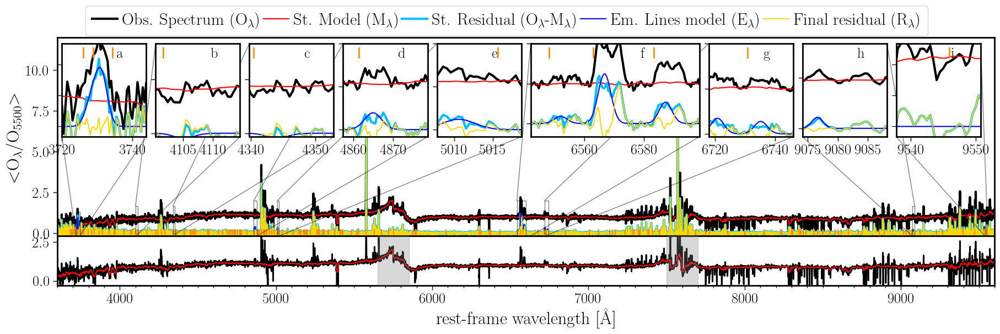

In [36]:
DIR='/disk-a/sanchez/LVM/LVM/ver_231113/output_dap/'
out_file_fit=f'{DIR}/m_dap-rsp30-sn20-00006590.output.fits'
out_file_ps=f'{DIR}/m_test_cl100.rsp.txt'
output_path='figs/'
outfile='test.pdf'
tab_el=read_tab_EL('_legacy/emission_lines_long_list.LVM')
zs=1.00134
fs=1/3
plot_spec(dir='',file=out_file_fit,\
            file_ssp = out_file_ps,\
                  name=None,text=None,output=f'{output_path}/{outfile}',\
                  insets=((0.005, 0.5, 0.09, 0.47,3715*zs,3739*zs,-0.5*fs,4*fs,'a'),\
                          (0.105, 0.5, 0.09, 0.47,4095*zs,4109*zs,-0.2*fs,5*fs,'b'),\
                          (0.205, 0.5, 0.09, 0.47,4334*zs,4347*zs,-0.2*fs,5*fs,'c'),\
                          (0.305, 0.5, 0.09, 0.47,4851*zs,4872*zs,-0.5*fs,6*fs,'d'),\
                          (0.405, 0.5, 0.09, 0.47,5001*zs,5012*zs,-0.5*fs,6*fs,'e'),\
                          (0.505, 0.5, 0.18, 0.47,6533*zs,6590*zs,-1*fs,6*fs,'f'),\
                          (0.695, 0.5, 0.09, 0.47,6709*zs,6737*zs,-0.2*fs,6*fs,'g'),\
                          (0.795, 0.5, 0.09, 0.47,9062*zs,9076*zs,-0.5*fs,5*fs,'h'),\
                          (0.895, 0.5, 0.09, 0.47,9525*zs,9538*zs,-0.5*fs,4*fs,'i')),
                          y_min=-0.5*fs,y_max=36*fs,y0_d=-0.3,y1_d=2.9,\
              x_min=3600,x_max=9600,plot_el=True, tab_el=tab_el,\
              colors_in=['black','red','deepskyblue','blue','gold','forestgreen'],\
         plot_res=True, show_scale=True,n_ord=1)

/home/sanchez/.local/lib/python3.10/site-packages/lvmdap/dap_tools.py:1407: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


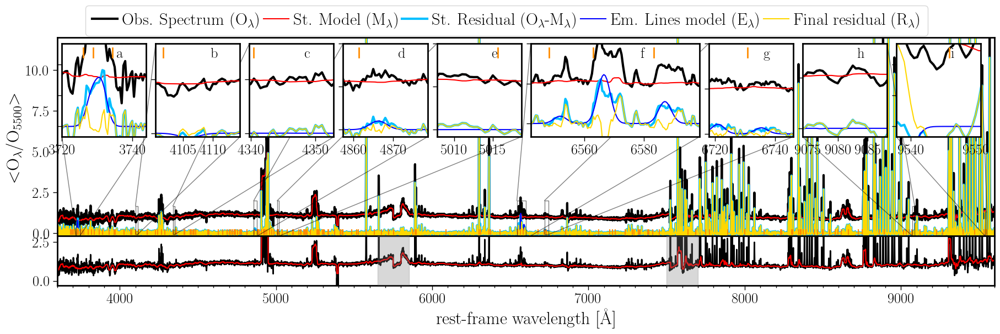

In [37]:
DIR='/disk-a/sanchez/LVM/LVM/ver_231113/output_dap/'
out_file_fit=f'{DIR}/m_dap-rsp30-sn20-00006589.output.fits'
out_file_ps=f'{DIR}/m_test_cl100.rsp.txt'
output_path='figs/'
outfile='test.pdf'
tab_el=read_tab_EL('_legacy/emission_lines_long_list.LVM')
zs=1.00134
fs=1/3
plot_spec(dir='',file=out_file_fit,\
            file_ssp = out_file_ps,\
                  name=None,text=None,output=f'{output_path}/{outfile}',\
                  insets=((0.005, 0.5, 0.09, 0.47,3715*zs,3739*zs,-0.5*fs,4*fs,'a'),\
                          (0.105, 0.5, 0.09, 0.47,4095*zs,4109*zs,-0.2*fs,5*fs,'b'),\
                          (0.205, 0.5, 0.09, 0.47,4334*zs,4347*zs,-0.2*fs,5*fs,'c'),\
                          (0.305, 0.5, 0.09, 0.47,4851*zs,4872*zs,-0.5*fs,6*fs,'d'),\
                          (0.405, 0.5, 0.09, 0.47,5001*zs,5012*zs,-0.5*fs,6*fs,'e'),\
                          (0.505, 0.5, 0.18, 0.47,6533*zs,6590*zs,-1*fs,6*fs,'f'),\
                          (0.695, 0.5, 0.09, 0.47,6709*zs,6737*zs,-0.2*fs,6*fs,'g'),\
                          (0.795, 0.5, 0.09, 0.47,9062*zs,9076*zs,-0.5*fs,5*fs,'h'),\
                          (0.895, 0.5, 0.09, 0.47,9525*zs,9538*zs,-0.5*fs,4*fs,'i')),
                          y_min=-0.5*fs,y_max=36*fs,y0_d=-0.3,y1_d=2.9,\
              x_min=3600,x_max=9600,plot_el=True, tab_el=tab_el,\
              colors_in=['black','red','deepskyblue','blue','gold','forestgreen'],\
         plot_res=True, show_scale=True,n_ord=1)

/home/sanchez/.local/lib/python3.11/site-packages/lvmdap/dap_tools.py:1214: RuntimeWarning: invalid value encountered in divide
  f_rat = ssp_model/data[0,:]



Intel MKL ERROR: Parameter 6 was incorrect on entry to DGELSD.


/home/sanchez/.local/lib/python3.11/site-packages/lvmdap/dap_tools.py:1330: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


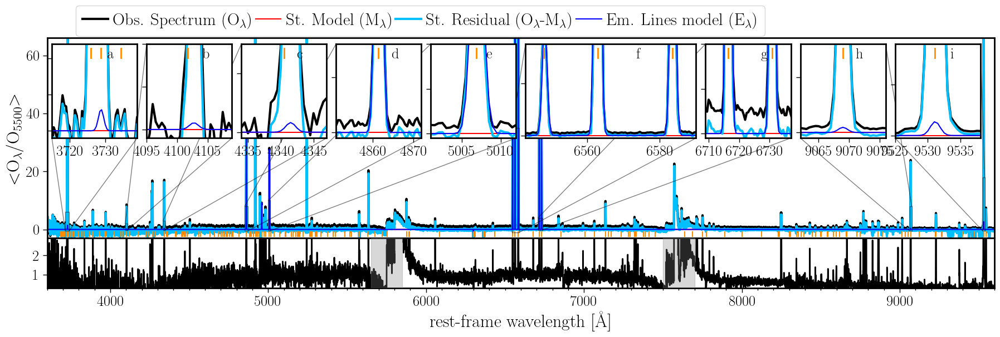

In [3]:
DIR='/disk-a/sanchez/LVM/LVM/ver_231113/output_dap/'
out_file_fit=f'{DIR}/m_dap-NR-s-00006109.output.fits'#m_test_el.output.fits'
out_file_ps=f'{DIR}/m_dap-NR-s-00006109.rsp.txt'
output_path='figs/'
outfile='test.pdf'
tab_el=read_tab_EL('_legacy/emission_lines_long_list.LVM')
plot_spec(dir='',file=out_file_fit,\
            file_ssp = out_file_ps,\
                  name=None,text=None,output=f'{output_path}/{outfile}',\
                  insets=((0.005, 0.5, 0.09, 0.47,3715,3739,-0.5,6,'a'),\
                          (0.105, 0.5, 0.09, 0.47,4095,4109,-0.2,2,'b'),\
                          (0.205, 0.5, 0.09, 0.47,4334,4347,-0.2,3,'c'),\
                          (0.305, 0.5, 0.09, 0.47,4851,4872,-0.5,8,'d'),\
                          (0.405, 0.5, 0.09, 0.47,5001,5012,-0.5,10,'e'),\
                          (0.505, 0.5, 0.18, 0.47,6543,6590,-1,35,'f'),\
                          (0.695, 0.5, 0.09, 0.47,6709,6737,-0.2,4,'g'),\
                          (0.795, 0.5, 0.09, 0.47,9062,9076,-0.5,8,'h'),\
                          (0.895, 0.5, 0.09, 0.47,9525,9538,-0.5,18,'i')),
                          y_min=-3,y_max=66,y0_d=0.3,y1_d=2.9,\
              x_min=3600,x_max=9600,plot_el=True, tab_el=tab_el)

/home/sanchez/.local/lib/python3.11/site-packages/lvmdap/dap_tools.py:1368: RuntimeWarning: invalid value encountered in divide
  f_rat = ssp_model/data[0,:]
/home/sanchez/.local/lib/python3.11/site-packages/lvmdap/dap_tools.py:1491: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


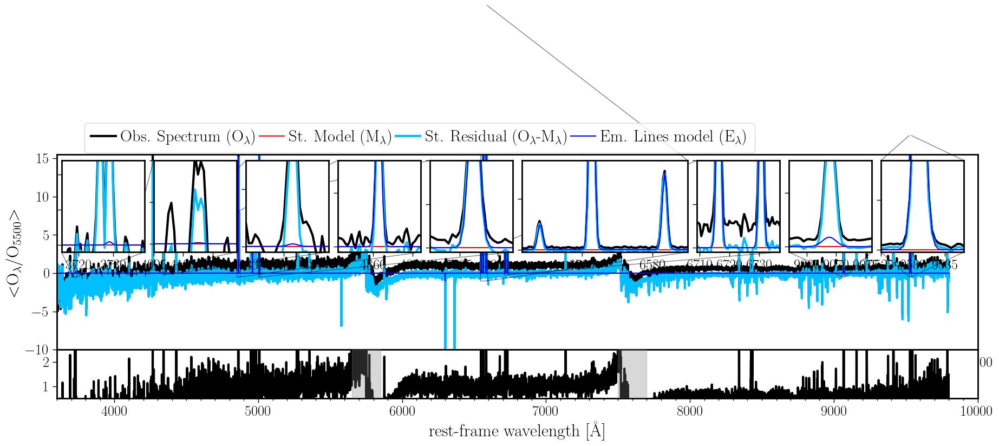

In [4]:
out_file_fit='output_ofelia_new/dap-rsp30-sn20-00006109.output.fits.gz'
plot_spectra(dir='./',n_sp=875,file=out_file_fit,\
             insets=((0.005, 0.5, 0.09, 0.47,3715,3739,-0.5,6,'a'),\
                          (0.105, 0.5, 0.09, 0.47,4095,4109,-0.2,2,'b'),\
                          (0.205, 0.5, 0.09, 0.47,4334,4347,-0.2,3,'c'),\
                          (0.305, 0.5, 0.09, 0.47,4851,4872,-0.5,8,'d'),\
                          (0.405, 0.5, 0.09, 0.47,5001,5012,-0.5,10,'e'),\
                          (0.505, 0.5, 0.18, 0.47,6543,6590,-1,35,'f'),\
                          (0.695, 0.5, 0.09, 0.47,6709,6737,-0.2,4,'g'),\
                          (0.795, 0.5, 0.09, 0.47,9062,9076,-0.5,8,'h'),\
                          (0.895, 0.5, 0.09, 0.47,9525,9538,-0.5,18,'i')),
                   file_ssp = None,\
                   x_min=3600,x_max=10000,y_min=-10,y_max=15.5,\
                   name='junk',text='junk',output=f'junk.pdf')

/home/sanchez/.local/lib/python3.11/site-packages/lvmdap/dap_tools.py:1368: RuntimeWarning: invalid value encountered in divide
  f_rat = ssp_model/data[0,:]
/home/sanchez/.local/lib/python3.11/site-packages/lvmdap/dap_tools.py:1491: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


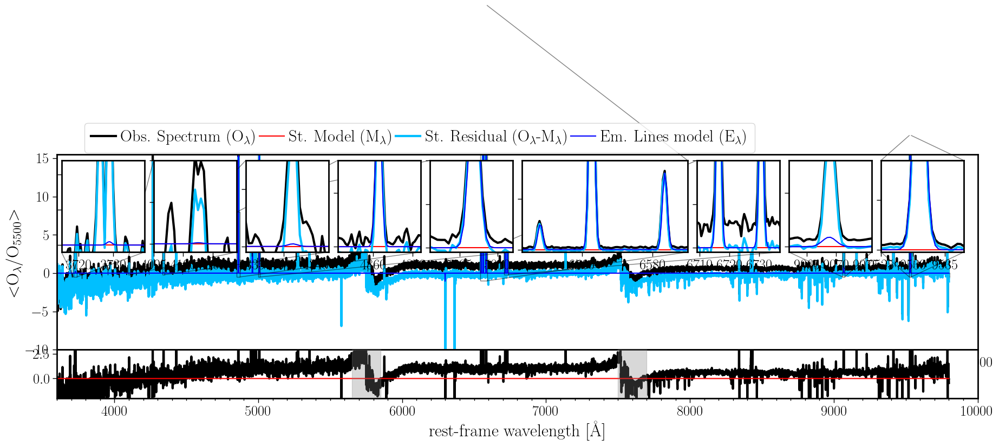

In [5]:
out_file_fit='output_ofelia_new/dap-rsp30-sn20-00006109.output.fits.gz'
plot_spectra(dir='./',n_sp=875,file=out_file_fit,\
             insets=((0.005, 0.5, 0.09, 0.47,3715,3739,-0.5,6,'a'),\
                          (0.105, 0.5, 0.09, 0.47,4095,4109,-0.2,2,'b'),\
                          (0.205, 0.5, 0.09, 0.47,4334,4347,-0.2,3,'c'),\
                          (0.305, 0.5, 0.09, 0.47,4851,4872,-0.5,8,'d'),\
                          (0.405, 0.5, 0.09, 0.47,5001,5012,-0.5,10,'e'),\
                          (0.505, 0.5, 0.18, 0.47,6543,6590,-1,35,'f'),\
                          (0.695, 0.5, 0.09, 0.47,6709,6737,-0.2,4,'g'),\
                          (0.795, 0.5, 0.09, 0.47,9062,9076,-0.5,8,'h'),\
                          (0.895, 0.5, 0.09, 0.47,9525,9538,-0.5,18,'i')),
                   file_ssp = None,\
                   x_min=3600,x_max=10000,y_min=-10,y_max=15.5,\
                   y0_d=-2,y1_d=2.9, 
                   name='junk',text='junk',output=f'junk_nsc.pdf',show_scale=False)

/home/sanchez/.local/lib/python3.11/site-packages/lvmdap/dap_tools.py:1368: RuntimeWarning: invalid value encountered in divide
  f_rat = ssp_model/data[0,:]
/home/sanchez/.local/lib/python3.11/site-packages/lvmdap/dap_tools.py:1491: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


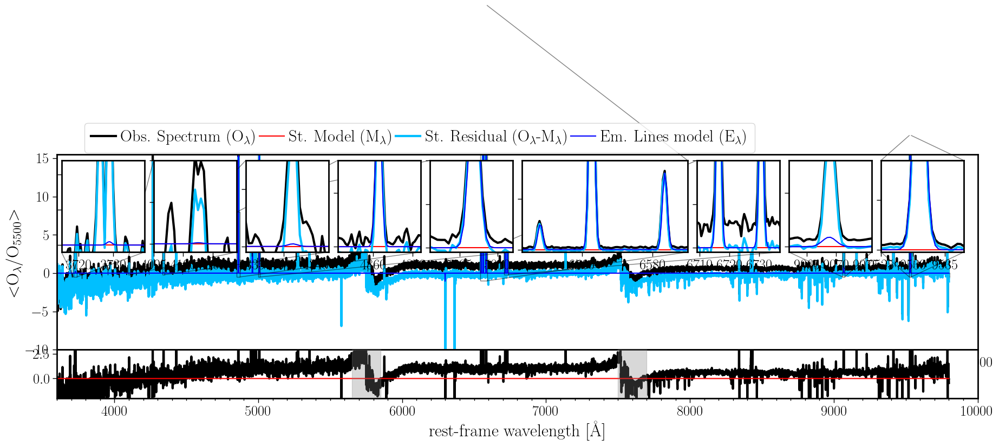

In [6]:
out_file_fit='output_ofelia_new/dap-rsp30-sn20-00006109.output.fits.gz'
plot_spectra(dir='./',n_sp=875,file=out_file_fit,\
             insets=((0.005, 0.5, 0.09, 0.47,3715,3739,-0.5,6,'a'),\
                          (0.105, 0.5, 0.09, 0.47,4095,4109,-0.2,2,'b'),\
                          (0.205, 0.5, 0.09, 0.47,4334,4347,-0.2,3,'c'),\
                          (0.305, 0.5, 0.09, 0.47,4851,4872,-0.5,8,'d'),\
                          (0.405, 0.5, 0.09, 0.47,5001,5012,-0.5,10,'e'),\
                          (0.505, 0.5, 0.18, 0.47,6543,6590,-1,35,'f'),\
                          (0.695, 0.5, 0.09, 0.47,6709,6737,-0.2,4,'g'),\
                          (0.795, 0.5, 0.09, 0.47,9062,9076,-0.5,8,'h'),\
                          (0.895, 0.5, 0.09, 0.47,9525,9538,-0.5,18,'i')),
                   file_ssp = None,\
                   x_min=3600,x_max=10000,y_min=-10,y_max=15.5,\
                   y0_d=-2,y1_d=2.9, 
                   name='junk',text='junk',output=f'junk_nsc.pdf',show_scale=True)

/home/sanchez/.local/lib/python3.11/site-packages/lvmdap/dap_tools.py:1368: RuntimeWarning: invalid value encountered in divide
  f_rat = ssp_model/data[0,:]


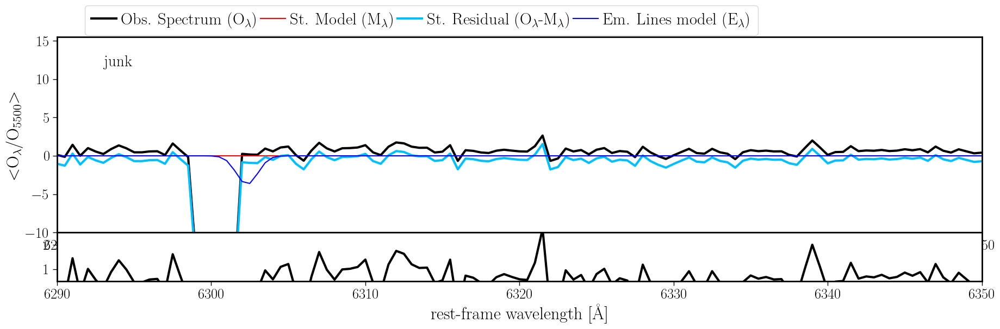

In [7]:
out_file_fit='output_ofelia_new/dap-rsp30-sn20-00006109.output.fits.gz'
plot_spectra(dir='./',n_sp=0,file=out_file_fit,\
                   file_ssp = None,\
                   x_min=6290,x_max=6350,y_min=-10,y_max=15.5,\
                   name='junk',text='junk',output=f'junk.pdf')

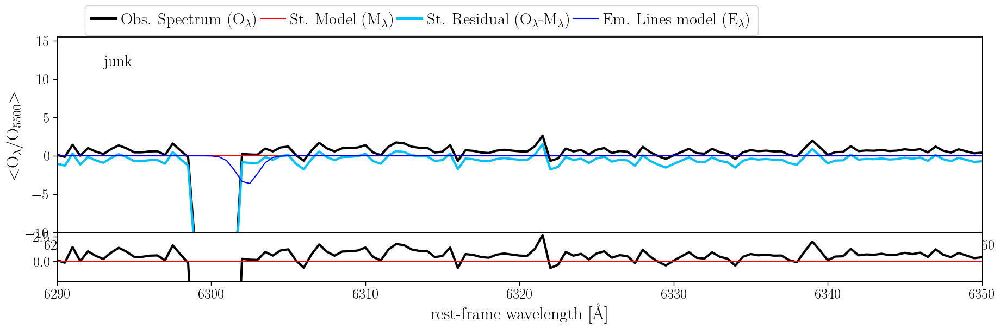

In [8]:
out_file_fit='output_ofelia_new/dap-rsp30-sn20-00006109.output.fits.gz'
plot_spectra(dir='./',n_sp=0,file=out_file_fit,\
                   file_ssp = None,\
                   x_min=6290,x_max=6350,y_min=-10,y_max=15.5,\
                   y0_d=-2,y1_d=2.9, 
                   name='junk',text='junk',output=f'junk.pdf',show_scale=False)

In [9]:
out_file_fit='output_ofelia_new/dap-rsp30-sn20-00006109.output.fits.gz'
plot_spectra(dir='./',n_sp=0,file=out_file_fit,\
                   file_ssp = None,\
                   x_min=6500,x_max=6600,y_min=-10,y_max=15.5,\
                   name='junk',text='junk',output=f'junk.pdf')

SyntaxError: invalid syntax. Perhaps you forgot a comma? (508586604.py, line 5)

In [ ]:
out_file_fit='output_ofelia/dap-rsp30-sn20-00006109.output.fits.gz'
plot_spectra(dir='./',n_sp=0,file=out_file_fit,\
                   file_ssp = None,\
                   x_min=3800,x_max=4100,y_min=-10,y_max=15.5,\
                   name='junk',text='junk',output=f'junk.pdf')

/home/sanchez/.local/lib/python3.11/site-packages/lvmdap/dap_tools.py:1331: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


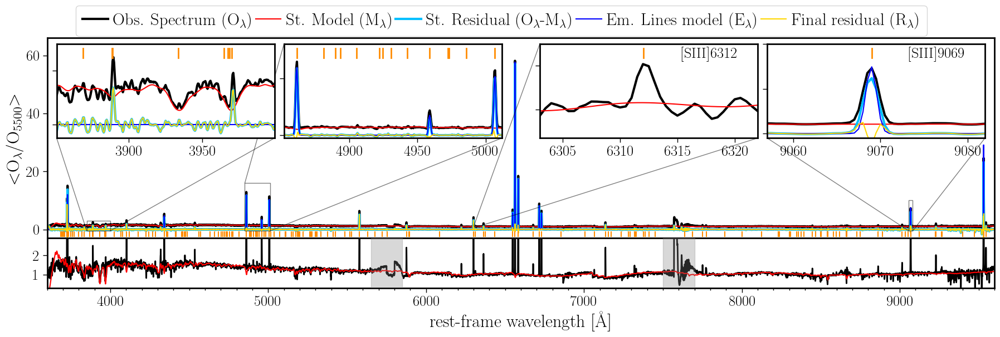

In [3]:
plot_spec(dir='output_dap_new',file='m_dap-30-00006115.output.fits.gz',\
          file_ssp = 'output_dap_new/m_dap-30-00006115.rsp.txt',\
          name='6115',text='',c_map='CMRmap',output='figs/RT_spec_6115.png',\
              insets=((0.25, 0.5, 0.23, 0.47,4852,5012,-0.5,16,''),\
                      (0.01, 0.5, 0.23, 0.47,3851,3999,-0.5,3,''),\
                      (0.52, 0.5, 0.23, 0.47,6303,6322,0.87,1.3,'[SIII]6312'),\
                      (0.76, 0.5, 0.23, 0.47,9057,9082,-0.5,10,'[SIII]9069')),\
              y_min=-3,y_max=66,y0_d=0.3,y1_d=2.9,\
              x_min=3600,x_max=9600,plot_el=True, tab_el=tab_el,plot_res=True,show_scale=False,n_ord=10)#,x_min=3600,x_max=9600)
# (0.55, 0.5, 0.2, 0.47,6303,6325,0.85,1.7)

/home/sanchez/.local/lib/python3.11/site-packages/lvmdap/dap_tools.py:1331: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


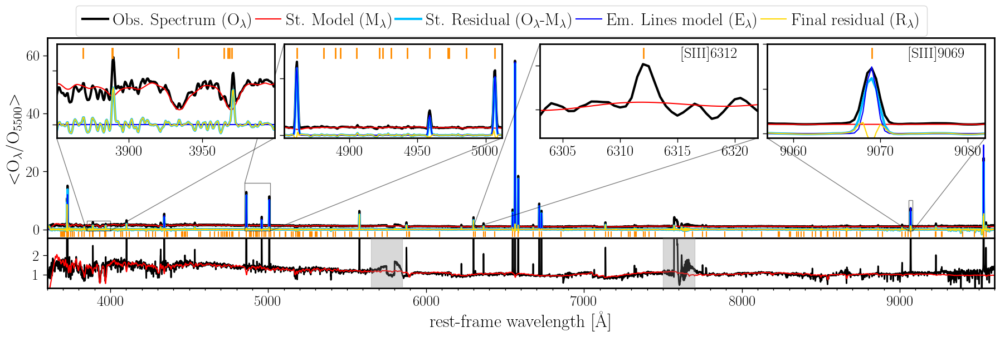

In [4]:
plot_spec(dir='output_dap_new',file='m_dap-30-00006115.output.fits.gz',\
          file_ssp = 'output_dap_new/m_dap-30-00006115.rsp.txt',\
          name='6115',text='',c_map='CMRmap',output='figs/RT_spec_6115.png',\
              insets=((0.25, 0.5, 0.23, 0.47,4852,5012,-0.5,16,''),\
                      (0.01, 0.5, 0.23, 0.47,3851,3999,-0.5,3,''),\
                      (0.52, 0.5, 0.23, 0.47,6303,6322,0.87,1.3,'[SIII]6312'),\
                      (0.76, 0.5, 0.23, 0.47,9057,9082,-0.5,10,'[SIII]9069')),\
              y_min=-3,y_max=66,y0_d=0.3,y1_d=2.9,\
              x_min=3600,x_max=9600,plot_el=True, tab_el=tab_el,plot_res=True,show_scale=False,n_ord=2)#,x_min=3600,x_max=9600)
# (0.55, 0.5, 0.2, 0.47,6303,6325,0.85,1.7)

/home/sanchez/.local/lib/python3.11/site-packages/lvmdap/dap_tools.py:1331: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


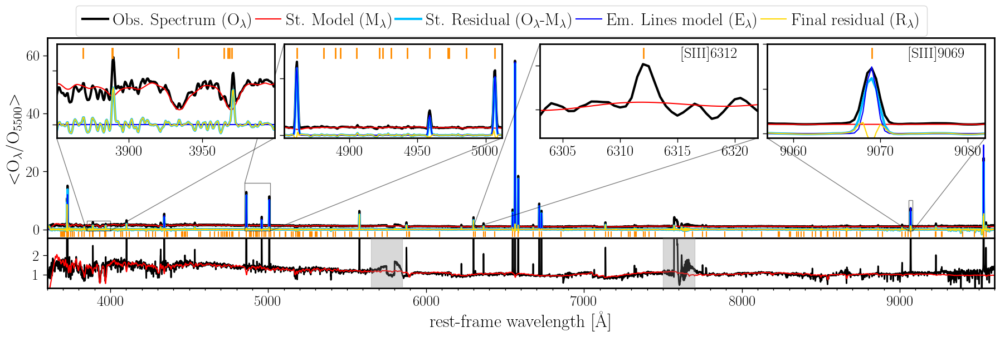

In [5]:
plot_spec(dir='output_dap_new',file='m_dap-30-00006115.output.fits.gz',\
          file_ssp = 'output_dap_new/m_dap-30-00006115.rsp.txt',\
          name='6115',text='',c_map='CMRmap',output='figs/RT_spec_6115.png',\
              insets=((0.25, 0.5, 0.23, 0.47,4852,5012,-0.5,16,''),\
                      (0.01, 0.5, 0.23, 0.47,3851,3999,-0.5,3,''),\
                      (0.52, 0.5, 0.23, 0.47,6303,6322,0.87,1.3,'[SIII]6312'),\
                      (0.76, 0.5, 0.23, 0.47,9057,9082,-0.5,10,'[SIII]9069')),\
              y_min=-3,y_max=66,y0_d=0.3,y1_d=2.9,\
              x_min=3600,x_max=9600,plot_el=True, tab_el=tab_el,plot_res=True,show_scale=False,n_ord=0)#,x_min=3600,x_max=9600)
# (0.55, 0.5, 0.2, 0.47,6303,6325,0.85,1.7)

/home/sanchez/.local/lib/python3.11/site-packages/lvmdap/dap_tools.py:1331: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


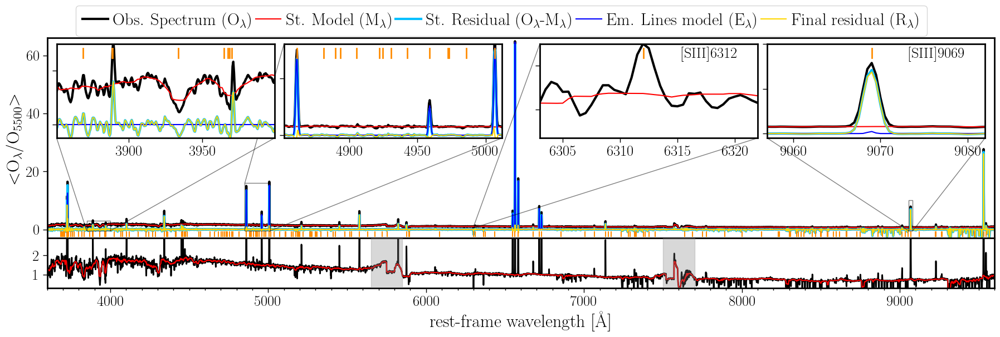

In [6]:
plot_spec(dir='output_dap_new',file='m_dap-30-00006114.output.fits.gz',\
          file_ssp = 'output_dap_new/m_dap-30-00006114.rsp.txt',\
          name='6115',text='',c_map='CMRmap',output='figs/RT_spec_6114.png',\
              insets=((0.25, 0.5, 0.23, 0.47,4852,5012,-0.5,16,''),\
                      (0.01, 0.5, 0.23, 0.47,3851,3999,-0.5,3,''),\
                      (0.52, 0.5, 0.23, 0.47,6303,6322,0.87,1.3,'[SIII]6312'),\
                      (0.76, 0.5, 0.23, 0.47,9057,9082,-0.5,10,'[SIII]9069')),\
              y_min=-3,y_max=66,y0_d=0.3,y1_d=2.9,\
              x_min=3600,x_max=9600,plot_el=True, tab_el=tab_el,plot_res=True)#,x_min=3600,x_max=9600)
# (0.55, 0.5, 0.2, 0.47,6303,6325,0.85,1.7)

/home/sanchez/.local/lib/python3.11/site-packages/lvmdap/dap_tools.py:1331: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


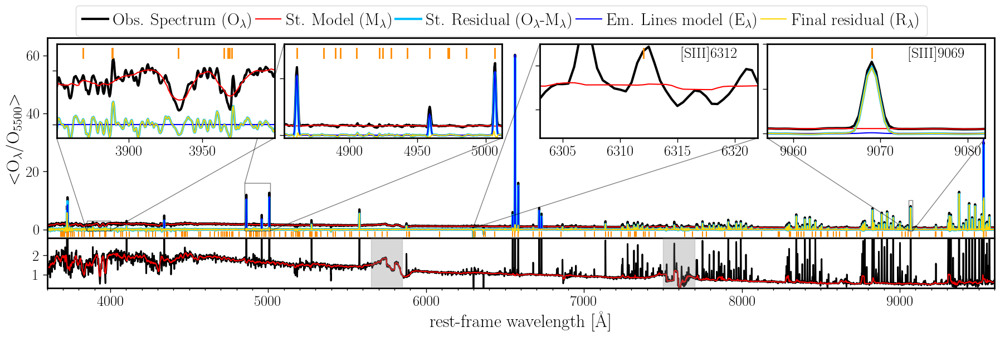

In [7]:
plot_spec(dir='output_dap_new',file='m_dap-30-00006113.output.fits.gz',\
          file_ssp = 'output_dap_new/m_dap-30-00006113.rsp.txt',\
          name='6115',text='',c_map='CMRmap',output='figs/RT_spec_6113.png',\
              insets=((0.25, 0.5, 0.23, 0.47,4852,5012,-0.5,16,''),\
                      (0.01, 0.5, 0.23, 0.47,3851,3999,-0.5,3,''),\
                      (0.52, 0.5, 0.23, 0.47,6303,6322,0.87,1.3,'[SIII]6312'),\
                      (0.76, 0.5, 0.23, 0.47,9057,9082,-0.5,10,'[SIII]9069')),\
              y_min=-3,y_max=66,y0_d=0.3,y1_d=2.9,\
              x_min=3600,x_max=9600,plot_el=True, tab_el=tab_el,plot_res=True)#,x_min=3600,x_max=9600)
# (0.55

In [ ]:
plot_spec(dir='output_dap_new',file='m_dap-30-00006112.output.fits.gz',\
          file_ssp = 'output_dap_new/m_dap-30-00006112.rsp.txt',\
          name='6115',text='',c_map='CMRmap',output='figs/RT_spec_6112.png',\
              insets=((0.25, 0.5, 0.23, 0.47,4852,5012,-0.5,26,''),\
                      (0.01, 0.5, 0.23, 0.47,3851,3999,-0.5,3,''),\
                      (0.52, 0.5, 0.23, 0.47,6303,6322,0.87,1.3,'[SIII]6312'),\
                      (0.76, 0.5, 0.23, 0.47,9057,9082,-0.5,10,'[SIII]9069')),\
              y_min=-3,y_max=66,y0_d=0.3,y1_d=2.9,\
              x_min=3600,x_max=9600,plot_el=True, tab_el=tab_el,plot_res=True)#,x_min=3600,x_max=9600)
# (0.55

In [ ]:
plot_spec(dir='output_dap_new',file='m_dap-30-00006111.output.fits.gz',\
          file_ssp = 'output_dap_new/m_dap-30-00006111.rsp.txt',\
          name='6115',text='',c_map='CMRmap',output='figs/RT_spec_6111.png',\
              insets=((0.25, 0.5, 0.23, 0.47,4852,5012,-1.5,28,''),\
                      (0.01, 0.5, 0.23, 0.47,3851,3999,-0.5,5,''),\
                      (0.52, 0.5, 0.23, 0.47,6303,6322,0.8,1.6,'[SIII]6312'),\
                      (0.76, 0.5, 0.23, 0.47,9063,9076,-0.5,10,'[SIII]9069')),\
              y_min=-3,y_max=96,y0_d=0.3,y1_d=2.9,\
              x_min=3600,x_max=9600,plot_el=True, tab_el=tab_el,plot_res=True)#,x_min=3600,x_max=9600)
# (0.55

/home/sanchez/.local/lib/python3.11/site-packages/lvmdap/dap_tools.py:1524: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


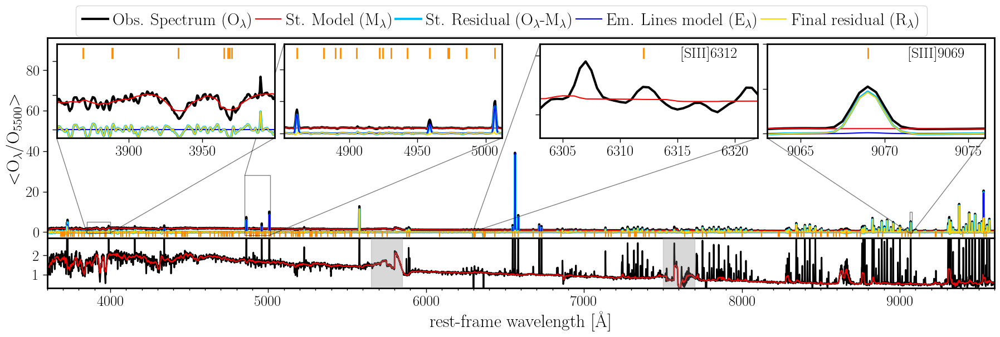

In [4]:
plot_spec(dir='output_dap_new',file='m_dap-30-00006110.output.fits.gz',\
          file_ssp = 'output_dap_new/m_dap-30-00006110.rsp.txt',\
          name='6115',text='',c_map='CMRmap',output='figs/RT_spec_6110.png',\
              insets=((0.25, 0.5, 0.23, 0.47,4852,5012,-1.5,28,''),\
                      (0.01, 0.5, 0.23, 0.47,3851,3999,-0.5,5,''),\
                      (0.52, 0.5, 0.23, 0.47,6303,6322,0.8,1.6,'[SIII]6312'),\
                      (0.76, 0.5, 0.23, 0.47,9063,9076,-0.5,10,'[SIII]9069')),\
              y_min=-3,y_max=96,y0_d=0.3,y1_d=2.9,\
              x_min=3600,x_max=9600,plot_el=True, tab_el=tab_el,plot_res=True)#,x_min=3600,x_max=9600)
# (0.55

In [ ]:
plot_spec(dir='output_dap_new',file='m_dap-30-00006109.output.fits.gz',\
          file_ssp = 'output_dap_new/m_dap-30-00006109.rsp.txt',\
          name='6115',text='',c_map='CMRmap',output='figs/RT_spec_6109.png',\
              insets=((0.25, 0.5, 0.23, 0.47,4852,5012,-1.5,28,''),\
                      (0.01, 0.5, 0.23, 0.47,3851,3999,-0.5,5,''),\
                      (0.52, 0.5, 0.23, 0.47,6303,6322,0.8,1.6,'[SIII]6312'),\
                      (0.76, 0.5, 0.23, 0.47,9063,9076,-0.5,10,'[SIII]9069')),\
              y_min=-3,y_max=96,y0_d=0.3,y1_d=2.9,\
              x_min=3600,x_max=9600,plot_el=True, tab_el=tab_el,plot_res=True)#,x_min=3600,x_max=9600)
# (0.55

In [ ]:
plot_spec(dir='output_dap',file='m_CF-00006111.output.fits',\
          file_ssp = 'output_dap/m_CF-00006111.rsp.txt',\
          name='6115',text='',c_map='CMRmap',output='figs/nRT_spec_6111.png',\
              insets=((0.25, 0.5, 0.23, 0.47,4852,5012,-5,249,''),\
                      (0.01, 0.5, 0.23, 0.47,3851,3999,-0.5,5,''),\
                      (0.52, 0.5, 0.23, 0.47,6303,6322,-0.5,5,'[SIII]6312'),\
                      (0.76, 0.5, 0.23, 0.47,9057,9082,-5,100,'[SIII]9069')),\
              y_min=-20,y_max=899,y0_d=0.3,y1_d=3.9,\
              x_min=3600,x_max=9600,plot_el=True, tab_el=tab_el,plot_res=True)#,x_min=3600,x_max=9600)
# (0.55, 0.5, 0.2, 0.47,6303,6325,0.85,1.7)

In [ ]:
plot_spec(dir='output_dap',file='m_CF-00006115.output.fits',\
          file_ssp = 'output_dap/m_CF-00006115.rsp.txt',\
          name='6115',text='',c_map='CMRmap',output='figs/nRT_spec_6115.png',\
              insets=((0.25, 0.5, 0.23, 0.47,4852,5012,-5,249,''),\
                      (0.01, 0.5, 0.23, 0.47,3851,3999,-0.5,5,''),\
                      (0.52, 0.5, 0.23, 0.47,6303,6322,-0.5,5,'[SIII]6312'),\
                      (0.76, 0.5, 0.23, 0.47,9057,9082,-5,100,'[SIII]9069')),\
              y_min=-20,y_max=899,y0_d=0.3,y1_d=3.9,\
              x_min=3600,x_max=9600,plot_el=True, tab_el=tab_el,plot_res=True)#,x_min=3600,x_max=9600)
# (0.55, 0.5, 0.2, 0.47,6303,6325,0.85,1.7)

In [ ]:
plot_spec(dir='output_dap',file='m_CF-00006114.output.fits',\
          file_ssp = 'output_dap/m_CF-00006114.rsp.txt',\
          name='6115',text='',c_map='CMRmap',output='figs/nRT_spec_6114.png',\
              insets=((0.25, 0.5, 0.23, 0.47,4852,5012,-1.5,28,''),\
                      (0.01, 0.5, 0.23, 0.47,3851,3999,-0.5,3,''),\
                      (0.52, 0.5, 0.23, 0.47,6303,6322,0.8,1.6,'[SIII]6312'),\
                      (0.76, 0.5, 0.23, 0.47,9063,9076,-0.5,10,'[SIII]9069')),\
              y_min=-20,y_max=899,y0_d=0.3,y1_d=3.9,\
              x_min=3600,x_max=9600,plot_el=True, tab_el=tab_el,plot_res=True,show_scale=True)#,x_min=3600,x_max=9600)
# (0.55, 0.5, 0.2, 0.47,6303,6325,0.85,1.7)

/home/sanchez/anaconda3/envs/lvmdap/lib/python3.11/site-packages/numpy/lib/polynomial.py:666: RuntimeWarning: overflow encountered in multiply
  scale = NX.sqrt((lhs*lhs).sum(axis=0))
/home/sanchez/anaconda3/envs/lvmdap/lib/python3.11/site-packages/numpy/core/_methods.py:48: RuntimeWarning: overflow encountered in reduce
  return umr_sum(a, axis, dtype, out, keepdims, initial, where)
/tmp/ipykernel_349849/2171258649.py:1: RankWarning: Polyfit may be poorly conditioned
  plot_spec(dir='output_dap',file='m_CF-00006110.output.fits',\
/home/sanchez/.local/lib/python3.11/site-packages/lvmdap/dap_tools.py:1524: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


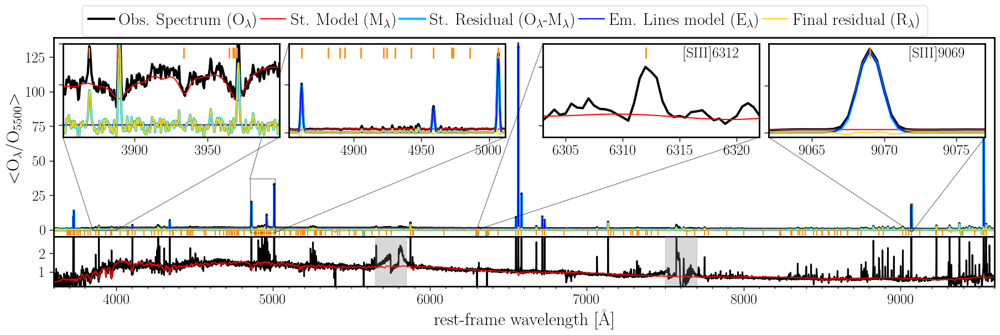

In [5]:
plot_spec(dir='output_dap',file='m_CF-00006110.output.fits',\
          file_ssp = 'output_dap/m_CF-00006110.rsp.txt',\
          name='6110',text='',c_map='CMRmap',output='figs/nRT_spec_6110.png',\
              insets=((0.25, 0.5, 0.23, 0.47,4852,5012,-2,37,''),\
                      (0.01, 0.5, 0.23, 0.47,3851,3999,-0.3,2,''),\
                      (0.52, 0.5, 0.23, 0.47,6303,6322,0.9,1.7,'[SIII]6312'),\
                      (0.76, 0.5, 0.23, 0.47,9062,9077,-1,19,'[SIII]9069')),\
              y_min=-5,y_max=139,y0_d=0.2,y1_d=2.9,\
              x_min=3600,x_max=9600,plot_el=True, tab_el=tab_el,plot_res=True,show_scale=False,n_ord=75)#,x_min=3600,x_max=9600)
# (0.55, 0.5, 0.2, 0.47,6303,6325,0.85,1.7)

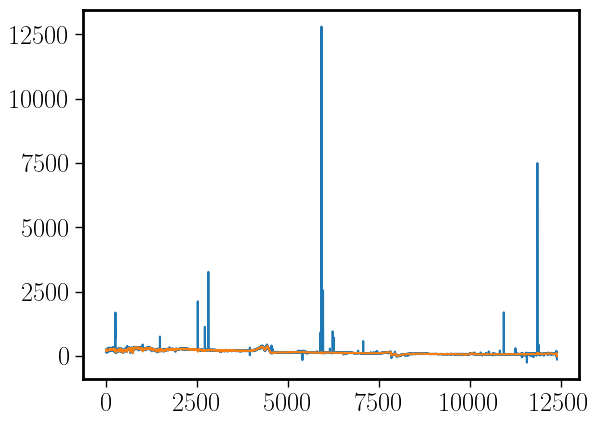

In [73]:
hdu=fits.open('output_dap/m_dap-rs36-SF-00006110.output.fits')
plt.plot(hdu[0].data[0,:])
#plt.plot(hdu[0].data[1,:]-hdu[0].data[4,:])
plt.plot(hdu[0].data[5,:]-hdu[0].data[4,:])
#hdu[0].header


/home/sanchez/.local/lib/python3.11/site-packages/lvmdap/dap_tools.py:1524: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


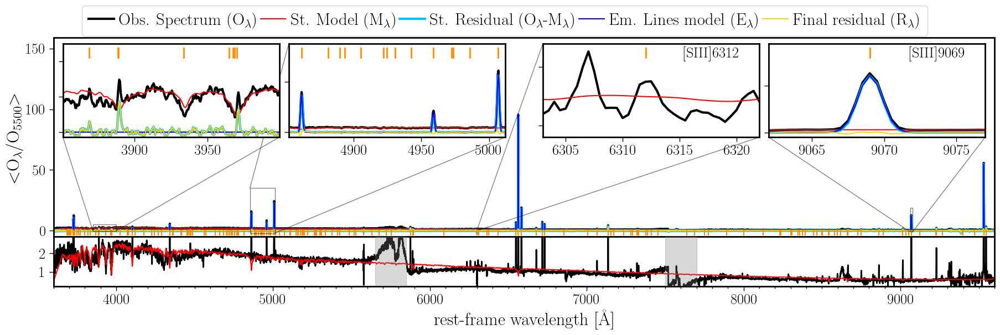

In [105]:
plot_spec(dir='output_dap',file='m_dap-rs36-SF-00006110.output.fits',\
          file_ssp = 'output_dap/m_CF-00006110.rsp.txt',\
          name='6110',text='',c_map='CMRmap',output='figs/nRT_spec_6110.png',\
              insets=((0.25, 0.5, 0.23, 0.47,4852,5012,-2,35,''),\
                      (0.01, 0.5, 0.23, 0.47,3851,3999,-0.3,5,''),\
                      (0.52, 0.5, 0.23, 0.47,6303,6322,0.9,1.7,'[SIII]6312'),\
                      (0.76, 0.5, 0.23, 0.47,9062,9077,-1,19,'[SIII]9069')),\
              y_min=-5,y_max=159,y0_d=0.2,y1_d=2.9,\
              x_min=3600,x_max=9600,plot_el=True, tab_el=tab_el,plot_res=True,show_scale=False,n_ord=5)#,x_min=3600,x_max=9600)
# (0.55, 0.5, 0.2, 0.47,6303,6325,0.85,1.7)

/home/sanchez/anaconda3/envs/lvmdap/lib/python3.11/site-packages/numpy/lib/polynomial.py:666: RuntimeWarning: overflow encountered in multiply
  scale = NX.sqrt((lhs*lhs).sum(axis=0))
/home/sanchez/anaconda3/envs/lvmdap/lib/python3.11/site-packages/numpy/core/_methods.py:48: RuntimeWarning: overflow encountered in reduce
  return umr_sum(a, axis, dtype, out, keepdims, initial, where)
/tmp/ipykernel_349849/3796842005.py:1: RankWarning: Polyfit may be poorly conditioned
  plot_spec(dir='output_dap',file='m_dap-sec-SF-00006110.output.fits',\
/home/sanchez/.local/lib/python3.11/site-packages/lvmdap/dap_tools.py:1524: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


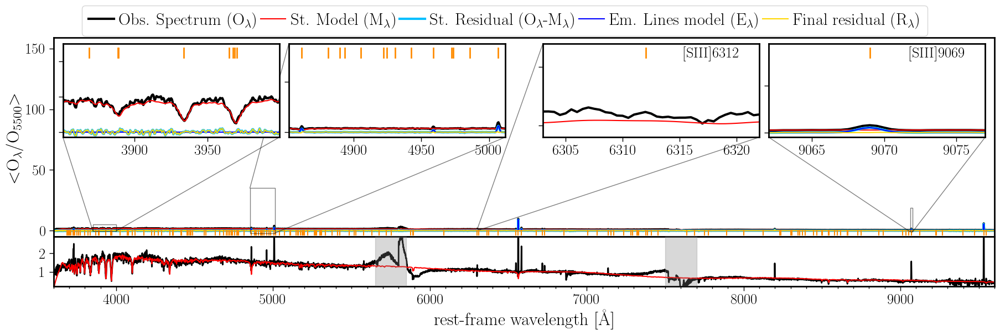

In [114]:
plot_spec(dir='output_dap',file='m_dap-sec-SF-00006110.output.fits',\
          file_ssp = 'output_dap/m_CF-00006110.rsp.txt',\
          name='6110',text='',c_map='CMRmap',output='figs/nRT_spec_6110.png',\
              insets=((0.25, 0.5, 0.23, 0.47,4852,5012,-2,35,''),\
                      (0.01, 0.5, 0.23, 0.47,3851,3999,-0.3,5,''),\
                      (0.52, 0.5, 0.23, 0.47,6303,6322,0.9,1.7,'[SIII]6312'),\
                      (0.76, 0.5, 0.23, 0.47,9062,9077,-1,19,'[SIII]9069')),\
              y_min=-5,y_max=159,y0_d=0.2,y1_d=2.9,\
              x_min=3600,x_max=9600,plot_el=True, tab_el=tab_el,plot_res=True,show_scale=False,n_ord=71)#,x_min=3600,x_max=9600)
# (0.55, 0.5, 0.2, 0.47,6303,6325,0.85,1.7)

/home/sanchez/.local/lib/python3.11/site-packages/lvmdap/dap_tools.py:1524: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


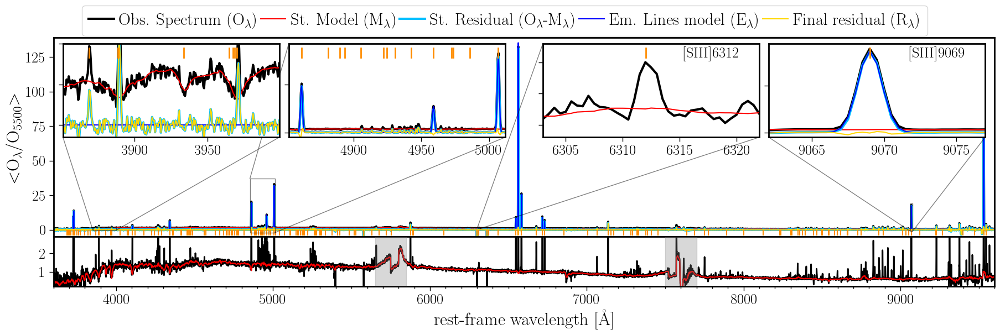

In [18]:
plot_spec(dir='output_dap',file='m_CF-00006110.output.fits',\
          file_ssp = 'output_dap/m_CF-00006110.rsp.txt',\
          name='6115',text='',c_map='CMRmap',output='figs/nRT_spec_6110_sc.png',\
              insets=((0.25, 0.5, 0.23, 0.47,4852,5012,-2,37,''),\
                      (0.01, 0.5, 0.23, 0.47,3851,3999,-0.3,2,''),\
                      (0.52, 0.5, 0.23, 0.47,6303,6322,0.9,1.65,'[SIII]6312'),\
                      (0.76, 0.5, 0.23, 0.47,9062,9077,-1,19,'[SIII]9069')),\
              y_min=-5,y_max=139,y0_d=0.2,y1_d=2.9,\
              x_min=3600,x_max=9600,plot_el=True, tab_el=tab_el,plot_res=True)#,x_min=3600,x_max=9600)
# (0.55, 0.5, 0.2, 0.47,6303,6325,0.85,1.7)

In [ ]:
plot_spec(dir='output_dap',file='m_CF-00006112.output.fits',\
          file_ssp = 'output_dap/m_CF-00006112.rsp.txt',\
          name='6115',text='',c_map='CMRmap',output='figs/nRT_spec_6112.png',\
              insets=((0.25, 0.5, 0.23, 0.47,4852,5012,-2,37,''),\
                      (0.01, 0.5, 0.23, 0.47,3851,3999,-0.3,2,''),\
                      (0.52, 0.5, 0.23, 0.47,6303,6322,-0.3,2,'[SIII]6312'),\
                      (0.76, 0.5, 0.23, 0.47,9062,9077,-2,19,'[SIII]9069')),\
              y_min=-5,y_max=139,y0_d=0.2,y1_d=2.9,\
              x_min=3600,x_max=9600,plot_el=True, tab_el=tab_el,plot_res=True)#,x_min=3600,x_max=9600)
# (0.55, 0.5, 0.2, 0.47,6303,6325,0.85,1.7)

In [ ]:
plot_spec(dir='output_dap',file='m_CF-00006113.output.fits',\
          file_ssp = 'output_dap/m_CF-00006113.rsp.txt',\
          name='6115',text='',c_map='CMRmap',output='figs/nRT_spec_6113.png',\
              insets=((0.25, 0.5, 0.23, 0.47,4852,5012,-2,37,''),\
                      (0.01, 0.5, 0.23, 0.47,3851,3999,-0.3,2,''),\
                      (0.52, 0.5, 0.23, 0.47,6303,6322,-0.3,2,'[SIII]6312'),\
                      (0.76, 0.5, 0.23, 0.47,9062,9077,-2,19,'[SIII]9069')),\
              y_min=-5,y_max=139,y0_d=0.2,y1_d=2.9,\
              x_min=3600,x_max=9600,plot_el=True, tab_el=tab_el,plot_res=True)#,x_min=3600,x_max=9600)
# (0.55, 0.5, 0.2, 0.47,6303,6325,0.85,1.7)

In [ ]:
plot_spec(dir='output_dap',file='m_CF-00006113.output.fits',\
          file_ssp = 'output_dap/m_CF-00006113.rsp.txt',\
          name='6115',text='',c_map='CMRmap',output='figs/nRT_spec_6113.png',\
              insets=((0.25, 0.5, 0.23, 0.47,4852,5012,-2,37,''),\
                      (0.01, 0.5, 0.23, 0.47,3851,3999,-0.3,2,''),\
                      (0.52, 0.5, 0.23, 0.47,6303,6322,-0.3,2,'[SIII]6312'),\
                      (0.76, 0.5, 0.23, 0.47,9062,9077,-2,19,'[SIII]9069')),\
              y_min=-5,y_max=139,y0_d=0.2,y1_d=2.9,\
              x_min=3600,x_max=9600,plot_el=True, tab_el=tab_el,plot_res=True,show_scale=False)#,x_min=3600,x_max=9600)
# (0.55, 0.5, 0.2, 0.47,6303,6325,0.85,1.7)

In [ ]:
from astropy.io import fits, ascii
file="output_dap/m_CF-00006110.output.fits"
hdu=fits.open(file)
data=hdu[0].data
(ny,nx)=data.shape
i0 = int(nx*0.45)
i1 = int(nx*0.55)

#data = data / np.median(data[0,i0:i1])
hdr=hdu[0].header
crval = hdr['crval1']
cdelt = hdr['cdelt1']
crpix = hdr['crpix1']
#print(data.shape)
(ny,nx) = data.shape
wave = crval+cdelt*(np.arange(0,nx)-(crpix-1))
fig = plt.figure(figsize=(19,6)) 
plt.plot(wave,hdu[0].data[0,:],color='black',linewidth=5)
plt.plot(wave,hdu[0].data[1,:],color='red',linewidth=3)
plt.plot(wave,hdu[0].data[2,:],color='blue')
plt.plot(wave,hdu[0].data[3,:],color='green')
plt.plot(wave,hdu[0].data[4,:],color='grey')
plt.plot(wave,hdu[0].data[5,:],color='orange')
plt.ylim(-10,400)


In [ ]:
from astropy.io import fits, ascii
from scipy.ndimage import gaussian_filter1d
from scipy.ndimage import median_filter
file="output_dap/m_CF-00006110.output.fits"
hdu=fits.open(file)
data=hdu[0].data
(ny,nx)=data.shape
i0 = int(nx*0.45)
i1 = int(nx*0.55)

#data = data / np.median(data[0,i0:i1])
hdr=hdu[0].header
crval = hdr['crval1']
cdelt = hdr['cdelt1']
crpix = hdr['crpix1']
#print(data.shape)
(ny,nx) = data.shape
wave = crval+cdelt*(np.arange(0,nx)-(crpix-1))
fig = plt.figure(figsize=(19,6)) 
plt.plot(wave,hdu[0].data[0,:],color='black',linewidth=1.5)
plt.plot(wave,hdu[0].data[1,:],color='red',linewidth=1)
#plt.plot(wave,hdu[0].data[2,:],color='blue')
#plt.plot(wave,hdu[0].data[3,:],color='green')
#plt.plot(wave,hdu[0].data[4,:],color='grey')
#plt.plot(wave,hdu[0].data[5,:],color='orange',linewidth=1)
gas = hdu[0].data[0,:] - hdu[0].data[5,:]
#plt.plot(wave,gas,color='orange',linewidth=1)
#res = hdu[0].data[3,:]-gas
#plt.plot(wave,res,color='orange',linewidth=1)
#rsp_mod = hdu[0].data[1,:]-hdu[0].data[3,:]
#plt.plot(wave,rsp_mod,color='orange',linewidth=1)
#s_rsp_mod = gaussian_filter1d(rsp_mod,100)
#s_res = gaussian_filter1d(res,100)
smooth=hdu[0].data[3,:]-hdu[0].data[4,:]-gas
s_size=5

ssp_org = (hdu[0].data[0,:]-smooth)
ssp_mod = (hdu[0].data[1,:]-smooth)#/(gaussian_filter1d(median_filter(hdu[0].data[1,:]-smooth,int(s_size*0.5)),s_size)/gaussian_filter1d(median_filter(ssp_org,int(s_size*0.5)),s_size))
s_ssp_mod = ssp_mod*(gaussian_filter1d(median_filter(hdu[0].data[1,:]-smooth,int(s_size*0.5)),s_size)/gaussian_filter1d(median_filter(ssp_mod,int(s_size*0.5)),s_size))
#f_rat = gaussian_filter1d(median_filter(data[0,:]/ssp_mod,int(0.5*s_size)),s_size)

f_rat = ssp_mod/data[0,:]
c_rat0 = np.polyfit(wave, f_rat, 9)
p_rat0 = np.poly1d(c_rat0)(wave)

c_rat1 = np.polyfit(wave, 1/f_rat, 9)
p_rat1 = np.poly1d(c_rat1)(wave)

#plt.plot(wave,gaussian_filter1d(median_filter(ssp_org,s_size),s_size),color='blue',linewidth=1)
plt.plot(wave,ssp_mod,color='lime',linewidth=1)
plt.plot(wave,ssp_mod/p_rat0,color='deepskyblue',linewidth=1)
plt.plot(wave,ssp_mod*p_rat1,color='deepskyblue',linewidth=1)
#plt.plot(wave,f_rat*100,color='orange',linewidth=1)
#plt.plot(wave,p_rat*100,color='deepskyblue',linewidth=1)
#plt.plot(wave,s_ssp_mod,color='orange',linewidth=1)
#rsp_mod_org = hdu[0].data[1,:]/s_rsp_mod
#plt.plot(wave,rsp_mod_org,color='green',linewidth=1)

plt.ylim(-10,400)
#plt.xlim(3800,6000)


In [11]:
(ny,nx)=data.shape
print(nx,ny)

12401 6
